<a href="https://colab.research.google.com/github/jacobholmshaw/biological-image-classification/blob/main/augmentation_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mounting drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


# Setup

In [ ]:
pip install git+https://github.com/aleju/imgaug.git

  Cloning https://github.com/aleju/imgaug.git to /tmp/pip-req-build-z_q6hwej
  Running command git clone -q https://github.com/aleju/imgaug.git /tmp/pip-req-build-z_q6hwej
  Created wheel for imgaug: filename=imgaug-0.4.0-py3-none-any.whl size=971122 sha256=7a7c91104e6b200a03e9f242c4eb3ea997efb0f65088c35b6dda917c25aabe40
  Stored in directory: /tmp/pip-ephem-wheel-cache-w9quwkqb/wheels/0c/78/b5/9303fae9d5e03df1f319adfe4e6534180b5c3232de11bc9a2f
Successfully built imgaug
  Attempting uninstall: imgaug
    Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.4.0 which is incompatible.


In [ ]:
import tensorflow as tf  # version 2.5
from tensorflow import keras
from tensorflow.keras.layers import LeakyReLU, Softmax
from tensorflow.keras.layers import Conv2D, MaxPooling2D, SeparableConv2D
from tensorflow.keras.layers import Dense, Flatten, Dropout, Reshape, Activation
from tensorflow.keras.layers import InputLayer, Input
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import LSTM
from tensorflow.keras.optimizers import Adam, Adagrad, Adadelta, Adamax, SGD, Ftrl, Nadam, RMSprop
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras import backend as K
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import Sequential
from tensorflow.keras.callbacks import EarlyStopping

In [ ]:
import tensorflow as tf
import imgaug as ia
import numpy as np
import matplotlib.pyplot as plt
import PIL
from pathlib import Path
from tensorflow.keras import layers
from imgaug import augmenters as iaa
import imageio
from PIL import Image
import os, sys
import random
import cv2
import imutils
from datetime import datetime
from keras import regularizers
from google.colab import files
import math

In [ ]:
os.chdir(os.getcwd()+'/drive/MyDrive/Hypothalamus machine learning/Data')
path = os.getcwd()
DATADIR = path+'/labeled_data'

# The following methods don't work with the DATADIR as a string, therefore we convert it to a path using Path from pathlib
DATADIR = Path(DATADIR)

#Sub directories for different categories
CATEGORIES = ["10_1","10_2","10_3"]

print('Path:', path)
print('Data directory:', DATADIR)

Path: /content/drive/.shortcut-targets-by-id/1ZbnJPWEDz_tPFpcEvBWPaS5XZIuj7-E3/Hypothalamus machine learning/Data
Data directory: /content/drive/.shortcut-targets-by-id/1ZbnJPWEDz_tPFpcEvBWPaS5XZIuj7-E3/Hypothalamus machine learning/Data/labeled_data


In [ ]:
parent = os.path.join(path, os.pardir)
modelDIR = os.path.abspath(parent) + '/Models'
plotDIR = os.path.abspath(parent) + '/Plots/augmentation_acc_loss_plots'
# prints parent directory
print("\nParent Directory:", os.path.abspath(parent))
print("Model directory:", modelDIR)
print("Plots directory:", plotDIR)


Parent Directory: /content/drive/.shortcut-targets-by-id/1ZbnJPWEDz_tPFpcEvBWPaS5XZIuj7-E3/Hypothalamus machine learning
Model directory: /content/drive/.shortcut-targets-by-id/1ZbnJPWEDz_tPFpcEvBWPaS5XZIuj7-E3/Hypothalamus machine learning/Models
Plots directory: /content/drive/.shortcut-targets-by-id/1ZbnJPWEDz_tPFpcEvBWPaS5XZIuj7-E3/Hypothalamus machine learning/Plots/augmentation_acc_loss_plots


In [ ]:
image = cv2.imread('labeled_data/10_1/10.1_035.jpg', cv2.IMREAD_GRAYSCALE)

In [ ]:
def visualize(original, augmented, label1 = 'Original', label2 = 'Augmented', grayscale1 = True, grayscale2 = True):
  fig = plt.figure()
  plt.subplot(1,2,1)
  plt.title(label1)
  if grayscale1 == True:
    plt.imshow(original, cmap = 'gray')
  else:
    plt.imshow(original)
  plt.axis('off')
  plt.subplot(1,2,2)
  plt.title(label2)
  if grayscale2 == True:
    plt.imshow(augmented, cmap = 'gray')
  else:
    plt.imshow(augmented)
  plt.axis('off')

In [ ]:
def visualise_all(data, figsize1 = 10, figsize2 = 10):
  fig = plt.figure(figsize=(figsize1, figsize2))
  for i in range(len(data)):
    plt.subplot((int(math.ceil(np.sqrt(len(data))))), 
                (int(math.ceil(np.sqrt(len(data))))), 
                i+1)
    plt.imshow(data[i][0], cmap = 'gray')
    plt.axis('off')

# Loading original data

In [ ]:
# import zipfile
# !unzip '/content/labelled_data.zip'

In [ ]:
tdata = []

for img in os.listdir('labeled_data/10_1'):  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_1/{}'.format(img), cv2.IMREAD_GRAYSCALE) 
        tdata.append([cv2.resize(img_array, (200, 200)), 0])
    except Exception as e:  
        pass

for img in os.listdir('labeled_data/10_2'):  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_2/{}'.format(img), cv2.IMREAD_GRAYSCALE) 
        tdata.append([cv2.resize(img_array, (200, 200)), 1])
    except Exception as e:  
        pass

for img in os.listdir('labeled_data/10_3'):  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_3/{}'.format(img), cv2.IMREAD_GRAYSCALE) 
        tdata.append([cv2.resize(img_array, (200, 200)), 2])
    except Exception as e:  
        pass

Loading data again without grayscale for some applications (thresholding etc.)

In [ ]:
data2 = []

for img in os.listdir('labeled_data/10_1'):  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_1/{}'.format(img)) 
        data2.append([cv2.resize(img_array, (200, 200)), 0])
    except Exception as e:  
        pass

for img in os.listdir('labeled_data/10_2'):  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_2/{}'.format(img)) 
        data2.append([cv2.resize(img_array, (200, 200)), 1])
    except Exception as e:  
        pass

for img in os.listdir('labeled_data/10_3'):  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_3/{}'.format(img)) 
        data2.append([cv2.resize(img_array, (200, 200)), 2])
    except Exception as e:  
        pass

## Making the splits

Using the same seed on each shuffle should make sure the splits have the same 15 images, just make sure that if you were to reload this below cell to have reloaded the tdata cell again. As if you press run the below cell twice, it will random shuffle to the seed twice, therefore making the images in the split different.

In [ ]:
random.seed(123)
random.shuffle(tdata)
k = 10
split1 = tdata[int(round(len(tdata)*(0/k), 0)):int(round(len(tdata)*(1/k), 0))]
split2 = tdata[int(round(len(tdata)*(1/k), 0)):int(round(len(tdata)*(2/k), 0))]          
split3 = tdata[int(round(len(tdata)*(2/k), 0)):int(round(len(tdata)*(3/k), 0))]   
split4 = tdata[int(round(len(tdata)*(3/k), 0)):int(round(len(tdata)*(4/k), 0))]  
split5 = tdata[int(round(len(tdata)*(4/k), 0)):int(round(len(tdata)*(5/k), 0))]
split6 = tdata[int(round(len(tdata)*(5/k), 0)):int(round(len(tdata)*(6/k), 0))]
split7 = tdata[int(round(len(tdata)*(6/k), 0)):int(round(len(tdata)*(7/k), 0))]
split8 = tdata[int(round(len(tdata)*(7/k), 0)):int(round(len(tdata)*(8/k), 0))]     
split9 = tdata[int(round(len(tdata)*(8/k), 0)):int(round(len(tdata)*(9/k), 0))]
split10 = tdata[int(round(len(tdata)*(9/k), 0)):int(round(len(tdata)*(10/k), 0))]    

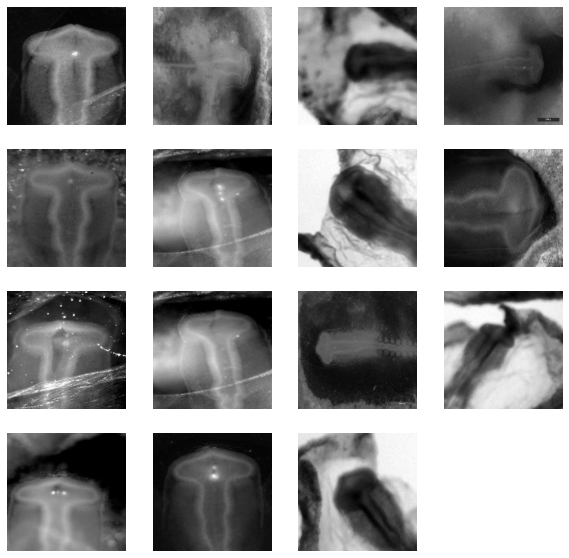

In [ ]:
visualise_all(split1)

## Training function

In [ ]:
def train_model(train, val, name):

  random.seed(1234)
  random.shuffle(train)
  random.shuffle(val)
  # random.shuffle(test_data)

  # Preprocessing the data into X_train etc with relevant input shapes
  X_train = []
  y_train = []
  X_val = []
  y_val = []
  X_test = []
  y_test = []
  img_size = 200

  for feature, label in train:
    X_train.append(feature)
    y_train.append(label)

  for feature, label in val:
    X_val.append(feature)
    y_val.append(label)

  # for feature, label in test_data:
  #   X_test.append(feature)
  #   y_test.append(label)

  X_train = np.array(X_train) / 255
  X_val = np.array(X_val) / 255
  # X_test = np.array(X_test) / 255

  X_train = X_train.reshape(X_train.shape[0], 200, 200, 1)
  X_val = X_val.reshape(X_val.shape[0], 200, 200, 1)
  # X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

  X_train.astype('float32')
  X_val.astype('float32')
  # X_test.astype('float32')

  y_train=to_categorical(y_train)
  y_val=to_categorical(y_val)
  # y_test = to_categorical(y_test)

  print('X_train shape:', np.shape(X_train))
  print('X_val shape:', np.shape(X_val))
  # print('X_test shape:', np.shape(X_test))
  print('y_train shape:', np.shape(y_train))
  print('y_val shape:', np.shape(y_val))
  # print('y_test shape:', np.shape(y_test))

  from tensorflow.keras import layers
  from tensorflow.keras import regularizers
  layer_drop = 0.2
  final_drop = 0.5
  activation = 'relu'
  lamda = 0.0001
  model = Sequential([
    layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 1), kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Flatten(),
    layers.Dense(1024, activation=activation),
    layers.Dropout(final_drop),
    layers.Dense(3, activation = 'softmax')
  ])
  #opt = Adam(learning_rate = learning_rate)
  model.compile(optimizer = Adam(learning_rate = 0.0001),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

  earlyStop = EarlyStopping(monitor = 'val_loss', min_delta = 0.01, patience = 10)
  epochs = 50
  history = model.fit(x=X_train,
                      y=y_train,
                      epochs=epochs,
                      batch_size=32,
                      validation_data=(X_val, y_val),
                      callbacks=[earlyStop])

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']
  accuracy = history.history['val_accuracy'][-1]
  # testvals = model.evaluate(X_test, y_test)

  # valaccs.append(round(max(val_acc)*100, 1))
  # vallosses.append(round(min(val_loss)*100, 1))
  # accs.append(round(max(acc)*100, 1))
  # acclosses.append(round(min(loss)*100, 1))
  # testaccs.append(round(testvals[1]*100, 1))
  # testlosses.append(round(testvals[0]*100, 1))

  model.save(name + '{}'.format(train))

  del model
  K.clear_session()

  return round(max(val_acc)*100, 1)

# CLAHE

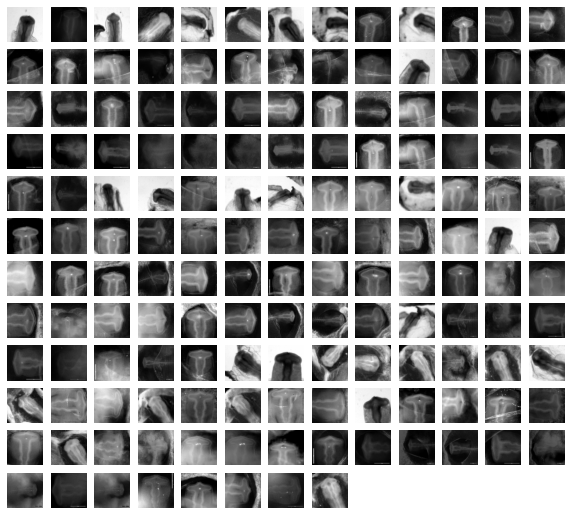

In [ ]:
visualise_all(tdata)

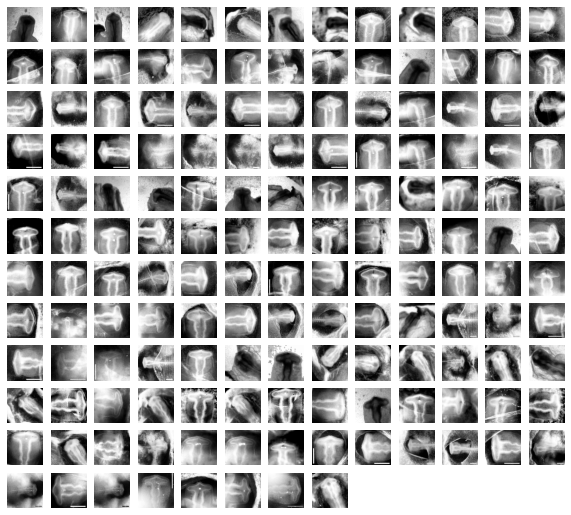

In [ ]:
newdata = []
for feature, label in tdata:
  feature = cv2.equalizeHist(feature)
  newdata.append([feature, label])
visualise_all(newdata)

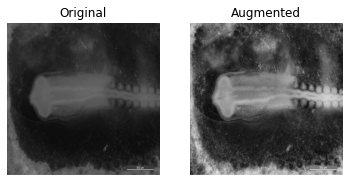

In [ ]:
img = cv2.imread('labeled_data/10_1/10.1_001.jpg', cv2.IMREAD_GRAYSCALE)
clahe = cv2.createCLAHE(clipLimit=3, tileGridSize=(8,8))
cl1 = clahe.apply(img)
visualize(img, cl1)

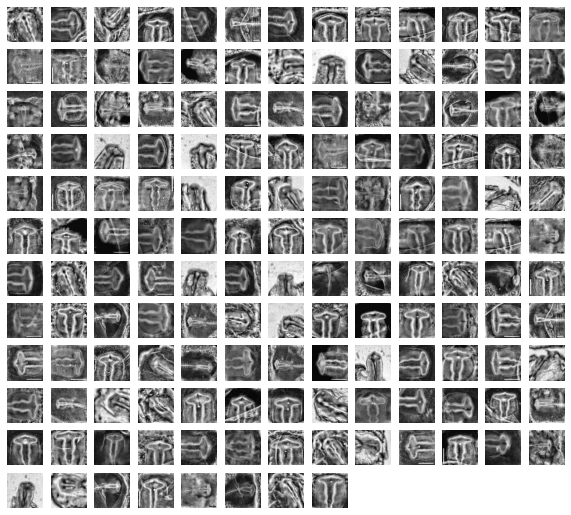

In [ ]:
newdata = []
for feature, label in tdata:
  clahe = cv2.createCLAHE(clipLimit=10)
  feature = clahe.apply(feature)
  newdata.append([feature, label])
visualise_all(newdata)

In [ ]:
valaccs = []
vallosses = []
accs = []
acclosses = []
testaccs = []
testlosses = []
for i in range(10):

  random.shuffle(tdata)
  training_data = tdata[0:int(round(len(tdata)*0.8, 0))]
  val_data = tdata[int(round(len(tdata)*0.8, 0)):int(round(len(tdata), 0))]
  # test_data = tdata[int(round(len(tdata)*0.95, 0)):int(round(len(tdata), 0))]

  train = []
  for feature, label in training_data:
    for angle in np.arange(0, 360, 10):
      clahe = cv2.createCLAHE(clipLimit=10)
      feature = clahe.apply(feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      train.append([feature, label])

  val = []
  for feature, label in val_data:
    for angle in np.arange(0, 360, 10):
      clahe = cv2.createCLAHE(clipLimit=10)
      feature = clahe.apply(feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      val.append([feature, label])

  random.shuffle(train)
  random.shuffle(val)
  # random.shuffle(test_data)

  # Preprocessing the data into X_train etc with relevant input shapes
  X_train = []
  y_train = []
  X_val = []
  y_val = []
  X_test = []
  y_test = []
  img_size = 200

  for feature, label in train:
    X_train.append(feature)
    y_train.append(label)

  for feature, label in val:
    X_val.append(feature)
    y_val.append(label)

  # for feature, label in test_data:
  #   X_test.append(feature)
  #   y_test.append(label)

  X_train = np.array(X_train) / 255
  X_val = np.array(X_val) / 255
  # X_test = np.array(X_test) / 255

  X_train = X_train.reshape(X_train.shape[0], 200, 200, 1)
  X_val = X_val.reshape(X_val.shape[0], 200, 200, 1)
  # X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

  X_train.astype('float32')
  X_val.astype('float32')
  # X_test.astype('float32')

  y_train=to_categorical(y_train)
  y_val=to_categorical(y_val)
  # y_test = to_categorical(y_test)

  print('X_train shape:', np.shape(X_train))
  print('X_val shape:', np.shape(X_val))
  # print('X_test shape:', np.shape(X_test))
  print('y_train shape:', np.shape(y_train))
  print('y_val shape:', np.shape(y_val))
  # print('y_test shape:', np.shape(y_test))

  from tensorflow.keras import layers
  from tensorflow.keras import regularizers
  layer_drop = 0.2
  final_drop = 0.5
  activation = 'relu'
  lamda = 0.0001
  model = Sequential([
    layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 1), kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Flatten(),
    layers.Dense(1024, activation=activation),
    layers.Dropout(final_drop),
    layers.Dense(3, activation = 'softmax')
  ])
  #opt = Adam(learning_rate = learning_rate)
  model.compile(optimizer = Adam(learning_rate = 0.0001),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

  earlyStop = EarlyStopping(monitor = 'val_loss', min_delta = 0.01, patience = 5)
  epochs = 50
  history = model.fit(x=X_train,
                      y=y_train,
                      epochs=epochs,
                      batch_size=32,
                      validation_data=(X_val, y_val),
                      callbacks=[earlyStop])

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']
  accuracy = history.history['val_accuracy'][-1]
  # testvals = model.evaluate(X_test, y_test)

  valaccs.append(round(max(val_acc)*100, 1))
  vallosses.append(round(min(val_loss)*100, 1))
  accs.append(round(max(acc)*100, 1))
  acclosses.append(round(min(loss)*100, 1))
  # testaccs.append(round(testvals[1]*100, 1))
  # testlosses.append(round(testvals[0]*100, 1))

  del model
  K.clear_session()

print('Accuracies:', accs)
print('Average accuracy:', round(np.mean(accs),1))
print('Average loss:', round(np.mean(acclosses),1))
print('Accuracy standard deviation:', np.std(accs))
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Average validation loss:', round(np.mean(vallosses),1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
# print('Test accuracies:', testaccs)
# print('Average test accuracy:', round(np.mean(testaccs), 1))
# print('Average test loss:', round(np.mean(testlosses),1))
# print('Test standard deviation:', round(np.std(testaccs), 1))

X_train shape: (4356, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (4356, 3)
y_val shape: (1080, 3)
Epoch 1/50
137/137 [==============================] - 5s 31ms/step - loss: 1.2100 - accuracy: 0.3538 - val_loss: 1.2062 - val_accuracy: 0.3333
Epoch 2/50
137/137 [==============================] - 4s 29ms/step - loss: 1.1678 - accuracy: 0.4004 - val_loss: 1.1866 - val_accuracy: 0.2472
Epoch 3/50
137/137 [==============================] - 4s 29ms/step - loss: 1.1007 - accuracy: 0.4621 - val_loss: 1.1360 - val_accuracy: 0.5102
Epoch 4/50
137/137 [==============================] - 4s 29ms/step - loss: 0.9242 - accuracy: 0.6203 - val_loss: 1.0446 - val_accuracy: 0.6028
Epoch 5/50
137/137 [==============================] - 4s 29ms/step - loss: 0.6248 - accuracy: 0.7863 - val_loss: 0.9229 - val_accuracy: 0.6852
Epoch 6/50
137/137 [==============================] - 4s 29ms/step - loss: 0.3777 - accuracy: 0.8978 - val_loss: 0.7970 - val_accuracy: 0.7574
Epoch 7/50
137/137 [======

KeyboardInterrupt: ignored

# Testing 10 degree rotations

1. Split data into 10 splits
2. augment each split
3. Create train/val data that has 8 splits in train and 2 splits in val.

In [ ]:
split1aug = []
for feature, label in split1:
  feature = cv2.equalizeHist(feature)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    split1aug.append([feature, label])
  
split2aug = []
for feature, label in split2:
  feature = cv2.equalizeHist(feature)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    split2aug.append([feature, label])

split3aug = []
for feature, label in split3:
  feature = cv2.equalizeHist(feature)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    split3aug.append([feature, label])

split4aug = []
for feature, label in split4:
  feature = cv2.equalizeHist(feature)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    split4aug.append([feature, label])

split5aug = []
for feature, label in split5:
  feature = cv2.equalizeHist(feature)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    split5aug.append([feature, label])

split6aug = []
for feature, label in split6:
  feature = cv2.equalizeHist(feature)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    split6aug.append([feature, label])

split7aug = []
for feature, label in split7:
  feature = cv2.equalizeHist(feature)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    split7aug.append([feature, label])

split8aug = []
for feature, label in split8:
  feature = cv2.equalizeHist(feature)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    split8aug.append([feature, label])

split9aug = []
for feature, label in split9:
  feature = cv2.equalizeHist(feature)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    split9aug.append([feature, label])

split10aug = []
for feature, label in split10:
  feature = cv2.equalizeHist(feature)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    split10aug.append([feature, label])

train1 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val1 = split1aug
train2 = np.concatenate([split1aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val2 = split2aug
train3 = np.concatenate([split2aug, split1aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val3 = split3aug
train4 = np.concatenate([split2aug, split3aug, split1aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val4 = split4aug
train5 = np.concatenate([split2aug, split3aug, split4aug, split1aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val5 = split5aug
train6 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split1aug, split7aug, split8aug, split9aug, split10aug])
val6 = split6aug
train7 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split1aug, split8aug, split9aug, split10aug])
val7 = split7aug
train8 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split1aug, split9aug, split10aug])
val8 = split8aug
train9 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split1aug, split10aug])
val9 = split9aug
train10 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split1aug])
val10 = split10aug

<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


In [ ]:
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1, 'baseline'))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2, 'baseline'))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3, 'baseline'))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4, 'baseline'))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5, 'baseline'))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6, 'baseline'))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7, 'baseline'))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8, 'baseline'))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9, 'baseline'))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10, 'baseline'))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1
X_train shape: (4896, 200, 200, 1)
X_val shape: (540, 200, 200, 1)
y_train shape: (4896, 3)
y_val shape: (540, 3)
Epoch 1/50
153/153 [==============================] - 25s 51ms/step - loss: 1.1849 - accuracy: 0.4077 - val_loss: 1.2049 - val_accuracy: 0.3500
Epoch 2/50
153/153 [==============================] - 7s 47ms/step - loss: 0.9927 - accuracy: 0.5842 - val_loss: 1.1190 - val_accuracy: 0.5222
Epoch 3/50
153/153 [==============================] - 7s 47ms/step - loss: 0.7477 - accuracy: 0.7259 - val_loss: 1.0683 - val_accuracy: 0.5204
Epoch 4/50
153/153 [==============================] - 7s 47ms/step - loss: 0.5312 - accuracy: 0.8352 - val_loss: 0.9087 - val_accuracy: 0.7463
Epoch 5/50
153/153 [==============================] - 7s 47ms/step - loss: 0.3533 - accuracy: 0.9191 - val_loss: 0.8357 - val_accuracy: 0.7111
Epoch 6/50
153/153 [==============================] - 7s 47ms/step - loss: 0.2605 - accuracy: 0.9481 - val_loss: 0.8055 - val_accuracy: 0.7333
Epoch 7/50

InvalidArgumentError: ignored

In [ ]:
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1
X_train shape: (4428, 200, 200, 1)
X_val shape: (432, 200, 200, 1)
y_train shape: (4428, 3)
y_val shape: (432, 3)
Epoch 1/50
139/139 [==============================] - 5s 31ms/step - loss: 1.2050 - accuracy: 0.3925 - val_loss: 1.2092 - val_accuracy: 0.2847
Epoch 2/50
139/139 [==============================] - 4s 28ms/step - loss: 1.0654 - accuracy: 0.5291 - val_loss: 1.1551 - val_accuracy: 0.4190
Epoch 3/50
139/139 [==============================] - 4s 28ms/step - loss: 0.8390 - accuracy: 0.6825 - val_loss: 1.0592 - val_accuracy: 0.5579
Epoch 4/50
139/139 [==============================] - 4s 28ms/step - loss: 0.6363 - accuracy: 0.7902 - val_loss: 0.9747 - val_accuracy: 0.6250
Epoch 5/50
139/139 [==============================] - 4s 28ms/step - loss: 0.4344 - accuracy: 0.8889 - val_loss: 0.9006 - val_accuracy: 0.7130
Epoch 6/50
139/139 [==============================] - 4s 28ms/step - loss: 0.2995 - accuracy: 0.9356 - val_loss: 0.7353 - val_accuracy: 0.7708
Epoch 7/50


In [ ]:
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1
X_train shape: (4896, 200, 200, 1)
X_val shape: (540, 200, 200, 1)
y_train shape: (4896, 3)
y_val shape: (540, 3)
Epoch 1/50
153/153 [==============================] - 25s 52ms/step - loss: 1.1848 - accuracy: 0.4136 - val_loss: 1.1939 - val_accuracy: 0.4500
Epoch 2/50
153/153 [==============================] - 7s 47ms/step - loss: 0.9863 - accuracy: 0.5950 - val_loss: 1.0909 - val_accuracy: 0.5093
Epoch 3/50
153/153 [==============================] - 7s 47ms/step - loss: 0.7543 - accuracy: 0.7269 - val_loss: 1.0130 - val_accuracy: 0.6593
Epoch 4/50
153/153 [==============================] - 7s 47ms/step - loss: 0.5338 - accuracy: 0.8331 - val_loss: 0.9089 - val_accuracy: 0.7389
Epoch 5/50
153/153 [==============================] - 7s 47ms/step - loss: 0.3511 - accuracy: 0.9163 - val_loss: 0.7860 - val_accuracy: 0.8000
Epoch 6/50
153/153 [==============================] - 7s 48ms/step - loss: 0.2398 - accuracy: 0.9575 - val_loss: 0.7592 - val_accuracy: 0.7259
Epoch 7/50

# Shear

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

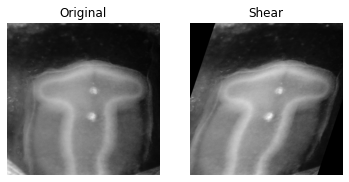

In [ ]:
image = cv2.imread('labeled_data/10_2/10.2_020.jpg', cv2.IMREAD_GRAYSCALE)
shear = iaa.ShearX(20)
sheared = shear(image = image)
cutout = iaa.Cutout()
cropped = cutout(image = image)
sp = iaa.SaltAndPepper(0.2)
sped = sp(image = feature)
plt.subfig(2, 2, 1)
# plt.savefig('shear_example.png')
# files.download('shear_example.png')

In [ ]:
split1aug = []
for feature, label in split1:
  for angle in np.arange(0, 360, 10):
    feature = cv2.equalizeHist(feature)
    shear = iaa.ShearX(20)
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    feature2 = shear(image = rotate(image = feature))
    split1aug.append([feature, label])
    split1aug.append([feature2, label])
  
split2aug = []
for feature, label in split2:
  for angle in np.arange(0, 360, 10):
    feature = cv2.equalizeHist(feature)
    shear = iaa.ShearX(20)
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    feature2 = shear(image = rotate(image = feature))
    split2aug.append([feature, label])
    split2aug.append([feature2, label])

split3aug = []
for feature, label in split3:
  for angle in np.arange(0, 360, 10):
    feature = cv2.equalizeHist(feature)
    shear = iaa.ShearX(20)
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    feature2 = shear(image = rotate(image = feature))
    split3aug.append([feature, label])
    split3aug.append([feature2, label])

split4aug = []
for feature, label in split4:
  for angle in np.arange(0, 360, 10):
    feature = cv2.equalizeHist(feature)
    shear = iaa.ShearX(20)
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    feature2 = shear(image = rotate(image = feature))
    split4aug.append([feature, label])
    split4aug.append([feature2, label])

split5aug = []
for feature, label in split5:
  for angle in np.arange(0, 360, 10):
    feature = cv2.equalizeHist(feature)
    shear = iaa.ShearX(20)
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    feature2 = shear(image = rotate(image = feature))
    split5aug.append([feature, label])
    split5aug.append([feature2, label])

split6aug = []
for feature, label in split6:
  for angle in np.arange(0, 360, 10):
    feature = cv2.equalizeHist(feature)
    shear = iaa.ShearX(20)
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    feature2 = shear(image = rotate(image = feature))
    split6aug.append([feature, label])
    split6aug.append([feature2, label])

split7aug = []
for feature, label in split7:
  for angle in np.arange(0, 360, 10):
    feature = cv2.equalizeHist(feature)
    shear = iaa.ShearX(20)
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    feature2 = shear(image = rotate(image = feature))
    split7aug.append([feature, label])
    split7aug.append([feature2, label])

split8aug = []
for feature, label in split8:
  for angle in np.arange(0, 360, 10):
    feature = cv2.equalizeHist(feature)
    shear = iaa.ShearX(20)
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    feature2 = shear(image = rotate(image = feature))
    split8aug.append([feature, label])
    split8aug.append([feature2, label])

split9aug = []
for feature, label in split9:
  for angle in np.arange(0, 360, 10):
    feature = cv2.equalizeHist(feature)
    shear = iaa.ShearX(20)
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    feature2 = shear(image = rotate(image = feature))
    split9aug.append([feature, label])
    split9aug.append([feature2, label])

split10aug = []
for feature, label in split10:
  for angle in np.arange(0, 360, 10):
    feature = cv2.equalizeHist(feature)
    shear = iaa.ShearX(20)
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    feature2 = shear(image = rotate(image = feature))
    split10aug.append([feature, label])
    split10aug.append([feature2, label])

train1 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val1 = split1aug
train2 = np.concatenate([split1aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val2 = split2aug
train3 = np.concatenate([split2aug, split1aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val3 = split3aug
train4 = np.concatenate([split2aug, split3aug, split1aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val4 = split4aug
train5 = np.concatenate([split2aug, split3aug, split4aug, split1aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val5 = split5aug
train6 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split1aug, split7aug, split8aug, split9aug, split10aug])
val6 = split6aug
train7 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split1aug, split8aug, split9aug, split10aug])
val7 = split7aug
train8 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split1aug, split9aug, split10aug])
val8 = split8aug
train9 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split1aug, split10aug])
val9 = split9aug
train10 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split1aug])
val10 = split10aug

<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


In [ ]:
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1
X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/50
306/306 [==============================] - 16s 49ms/step - loss: 1.1248 - accuracy: 0.4683 - val_loss: 1.1831 - val_accuracy: 0.4593
Epoch 2/50
306/306 [==============================] - 14s 47ms/step - loss: 0.7097 - accuracy: 0.7537 - val_loss: 0.9689 - val_accuracy: 0.6352
Epoch 3/50
306/306 [==============================] - 15s 47ms/step - loss: 0.3717 - accuracy: 0.9077 - val_loss: 0.8591 - val_accuracy: 0.6546
Epoch 4/50
306/306 [==============================] - 15s 48ms/step - loss: 0.2335 - accuracy: 0.9580 - val_loss: 0.7454 - val_accuracy: 0.7009
Epoch 5/50
306/306 [==============================] - 15s 48ms/step - loss: 0.1755 - accuracy: 0.9780 - val_loss: 0.7570 - val_accuracy: 0.6852
Epoch 6/50
306/306 [==============================] - 15s 48ms/step - loss: 0.1495 - accuracy: 0.9848 - val_loss: 0.7687 - val_accuracy: 0.7046
Epo

# Crop

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

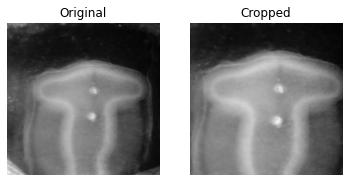

In [ ]:
image = cv2.imread('labeled_data/10_2/10.2_020.jpg', cv2.IMREAD_GRAYSCALE)
crop = iaa.Crop(percent = 0.1)
cropped = crop(image = image)
visualize(image, cropped, label2 = 'Cropped')
plt.savefig('crop_example.png')
files.download('crop_example.png')

In [ ]:
np.arange(0, 0.5, 0.05)

array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45])

In [ ]:
split1aug = []
for feature, label in split1:
  for percent in np.arange(0, 0.3, 0.01):
      feature = cv2.equalizeHist(feature)
      crop = iaa.Crop(percent = percent)
      feature = crop(image = feature)
      split1aug.append([feature, label])

  
split2aug = []
for feature, label in split2:
  for percent in np.arange(0, 0.3, 0.01):
      feature = cv2.equalizeHist(feature)
      crop = iaa.Crop(percent = percent)
      feature = crop(image = feature)
      split2aug.append([feature, label])

split3aug = []
for feature, label in split3:
  for percent in np.arange(0, 0.3, 0.01):
      feature = cv2.equalizeHist(feature)
      crop = iaa.Crop(percent = percent)
      feature = crop(image = feature)
      split3aug.append([feature, label])

split4aug = []
for feature, label in split4:
  for percent in np.arange(0, 0.3, 0.01):
      feature = cv2.equalizeHist(feature)
      crop = iaa.Crop(percent = percent)
      feature = crop(image = feature)
      split4aug.append([feature, label])

split5aug = []
for feature, label in split5:
  for percent in np.arange(0, 0.3, 0.01):
      feature = cv2.equalizeHist(feature)
      crop = iaa.Crop(percent = percent)
      feature = crop(image = feature)
      split5aug.append([feature, label])

split6aug = []
for feature, label in split6:
  for percent in np.arange(0, 0.3, 0.01):
      feature = cv2.equalizeHist(feature)
      crop = iaa.Crop(percent = percent)
      feature = crop(image = feature)
      split6aug.append([feature, label])

split7aug = []
for feature, label in split7:
  for percent in np.arange(0, 0.3, 0.01):
      feature = cv2.equalizeHist(feature)
      crop = iaa.Crop(percent = percent)
      feature = crop(image = feature)
      split7aug.append([feature, label])

split8aug = []
for feature, label in split8:
  for percent in np.arange(0, 0.3, 0.01):
      feature = cv2.equalizeHist(feature)
      crop = iaa.Crop(percent = percent)
      feature = crop(image = feature)
      split8aug.append([feature, label])

split9aug = []
for feature, label in split9:
  for percent in np.arange(0, 0.3, 0.01):
      feature = cv2.equalizeHist(feature)
      crop = iaa.Crop(percent = percent)
      feature = crop(image = feature)
      split9aug.append([feature, label])

split10aug = []
for feature, label in split10:
  for percent in np.arange(0, 0.3, 0.01):
      feature = cv2.equalizeHist(feature)
      crop = iaa.Crop(percent = percent)
      feature = crop(image = feature)
      split10aug.append([feature, label])

train1 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val1 = split1aug
train2 = np.concatenate([split1aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val2 = split2aug
train3 = np.concatenate([split2aug, split1aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val3 = split3aug
train4 = np.concatenate([split2aug, split3aug, split1aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val4 = split4aug
train5 = np.concatenate([split2aug, split3aug, split4aug, split1aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val5 = split5aug
train6 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split1aug, split7aug, split8aug, split9aug, split10aug])
val6 = split6aug
train7 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split1aug, split8aug, split9aug, split10aug])
val7 = split7aug
train8 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split1aug, split9aug, split10aug])
val8 = split8aug
train9 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split1aug, split10aug])
val9 = split9aug
train10 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split1aug])
val10 = split10aug

<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


In [ ]:
%%timeit
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1


In [ ]:
%%timeit
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1
X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/50
306/306 [==============================] - 25s 31ms/step - loss: 1.1308 - accuracy: 0.4590 - val_loss: 1.1619 - val_accuracy: 0.4843
Epoch 2/50
306/306 [==============================] - 9s 29ms/step - loss: 0.8197 - accuracy: 0.6827 - val_loss: 1.0882 - val_accuracy: 0.4694
Epoch 3/50
306/306 [==============================] - 9s 29ms/step - loss: 0.4951 - accuracy: 0.8471 - val_loss: 1.0191 - val_accuracy: 0.5380
Epoch 4/50
306/306 [==============================] - 9s 29ms/step - loss: 0.2963 - accuracy: 0.9345 - val_loss: 0.9902 - val_accuracy: 0.5398
Epoch 5/50
306/306 [==============================] - 9s 29ms/step - loss: 0.2016 - accuracy: 0.9688 - val_loss: 0.9691 - val_accuracy: 0.5759
Epoch 6/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1584 - accuracy: 0.9829 - val_loss: 0.9516 - val_accuracy: 0.6056
Epoch 7/

InternalError: ignored

In [ ]:
valaccs = [71.3, 86.2, 85.7, 78.7, 79.9, 68.8, 78.5, 51.4]
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 9
X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/50
306/306 [==============================] - 14s 30ms/step - loss: 1.1420 - accuracy: 0.4535 - val_loss: 1.2094 - val_accuracy: 0.4204
Epoch 2/50
306/306 [==============================] - 9s 28ms/step - loss: 0.8215 - accuracy: 0.6753 - val_loss: 1.1920 - val_accuracy: 0.5259
Epoch 3/50
306/306 [==============================] - 9s 28ms/step - loss: 0.4795 - accuracy: 0.8555 - val_loss: 1.1874 - val_accuracy: 0.4917
Epoch 4/50
306/306 [==============================] - 9s 29ms/step - loss: 0.2845 - accuracy: 0.9377 - val_loss: 1.1276 - val_accuracy: 0.5454
Epoch 5/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1991 - accuracy: 0.9698 - val_loss: 1.2012 - val_accuracy: 0.5454
Epoch 6/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1571 - accuracy: 0.9818 - val_loss: 1.2142 - val_accuracy: 0.5463
Epoch 7/

# Gaussian blur

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

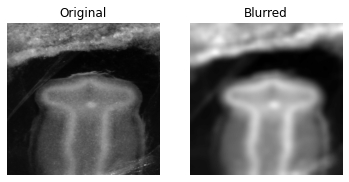

In [ ]:
image = cv2.imread('labeled_data/10_2/10.2_029.jpg', cv2.IMREAD_GRAYSCALE)
gblur = iaa.GaussianBlur(sigma = 20)
cropped = gblur(image = image)
visualize(image, cropped, label2 = 'Blurred')
plt.savefig('blur.png')
files.download('blur.png')

In [ ]:
split1aug = []
for feature, label in split1:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gblur = iaa.GaussianBlur(sigma = 5)
      feature2 = gblur(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split1aug.append([feature, label])
      split1aug.append([feature2, label])
  
split2aug = []
for feature, label in split2:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gblur = iaa.GaussianBlur(sigma = 5)
      feature2 = gblur(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split2aug.append([feature, label])
      split2aug.append([feature2, label])

split3aug = []
for feature, label in split3:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gblur = iaa.GaussianBlur(sigma = 5)
      feature2 = gblur(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split3aug.append([feature, label])
      split3aug.append([feature2, label])

split4aug = []
for feature, label in split4:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gblur = iaa.GaussianBlur(sigma = 5)
      feature2 = gblur(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split4aug.append([feature, label])
      split4aug.append([feature2, label])

split5aug = []
for feature, label in split5:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gblur = iaa.GaussianBlur(sigma = 5)
      feature2 = gblur(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split5aug.append([feature, label])
      split5aug.append([feature2, label])

split6aug = []
for feature, label in split6:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gblur = iaa.GaussianBlur(sigma = 5)
      feature2 = gblur(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split6aug.append([feature, label])
      split6aug.append([feature2, label])

split7aug = []
for feature, label in split7:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gblur = iaa.GaussianBlur(sigma = 5)
      feature2 = gblur(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split7aug.append([feature, label])
      split7aug.append([feature2, label])

split8aug = []
for feature, label in split8:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gblur = iaa.GaussianBlur(sigma = 5)
      feature2 = gblur(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split8aug.append([feature, label])
      split8aug.append([feature2, label])

split9aug = []
for feature, label in split9:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gblur = iaa.GaussianBlur(sigma = 5)
      feature2 = gblur(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split9aug.append([feature, label])
      split9aug.append([feature2, label])

split10aug = []
for feature, label in split10:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gblur = iaa.GaussianBlur(sigma = 5)
      feature2 = gblur(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split10aug.append([feature, label])
      split10aug.append([feature2, label])

train1 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val1 = split1aug
train2 = np.concatenate([split1aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val2 = split2aug
train3 = np.concatenate([split2aug, split1aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val3 = split3aug
train4 = np.concatenate([split2aug, split3aug, split1aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val4 = split4aug
train5 = np.concatenate([split2aug, split3aug, split4aug, split1aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val5 = split5aug
train6 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split1aug, split7aug, split8aug, split9aug, split10aug])
val6 = split6aug
train7 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split1aug, split8aug, split9aug, split10aug])
val7 = split7aug
train8 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split1aug, split9aug, split10aug])
val8 = split8aug
train9 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split1aug, split10aug])
val9 = split9aug
train10 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split1aug])
val10 = split10aug

<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


In [ ]:
%%time
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1
X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/50
306/306 [==============================] - 14s 30ms/step - loss: 1.1114 - accuracy: 0.4709 - val_loss: 1.1502 - val_accuracy: 0.4019
Epoch 2/50
306/306 [==============================] - 9s 29ms/step - loss: 0.6922 - accuracy: 0.7542 - val_loss: 0.8937 - val_accuracy: 0.7167
Epoch 3/50
306/306 [==============================] - 9s 29ms/step - loss: 0.3473 - accuracy: 0.9141 - val_loss: 0.8245 - val_accuracy: 0.7157
Epoch 4/50
306/306 [==============================] - 9s 29ms/step - loss: 0.2135 - accuracy: 0.9655 - val_loss: 0.8342 - val_accuracy: 0.7028
Epoch 5/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1583 - accuracy: 0.9817 - val_loss: 0.7244 - val_accuracy: 0.7407
Epoch 6/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1330 - accuracy: 0.9890 - val_loss: 0.7800 - val_accuracy: 0.6991
Epoch 7/

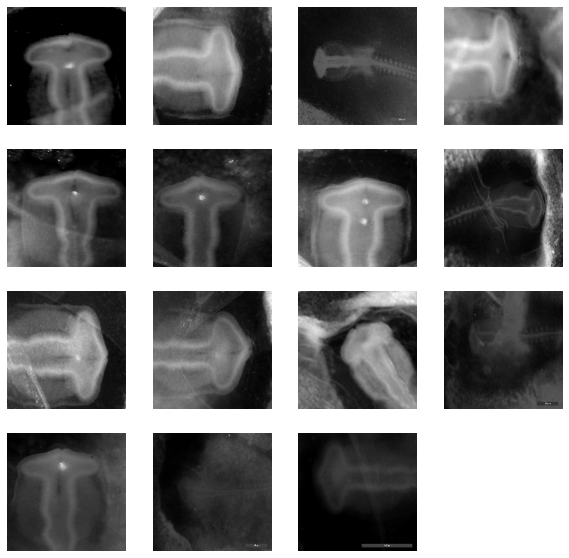

In [ ]:
visualise_all(split7)

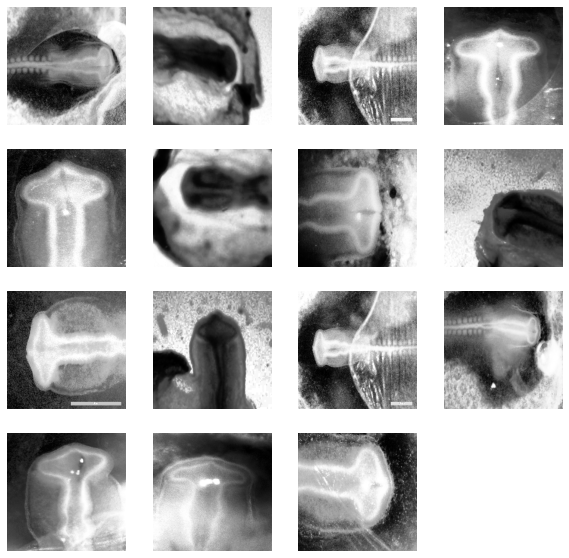

In [ ]:
hist = []
for feature, label in split8:
  feature = cv2.equalizeHist(feature)
  hist.append([feature, label])
visualise_all(hist)

In [ ]:
one = 0
two = 0
three = 0
for feature, label in split10:
  if label == 0:
    one += 1
  if label == 1:
    two += 1
  if label == 2:
    three += 1
print(one)
print(two)
print(three)

6
6
3


Possible causes for bad split

1) 3/15 images with scale bars.
2) Almost every image has an odd background.
3) 4 of the embryos are very dark and hard to tell on the features.
4) Only one 10_3 image in the split?

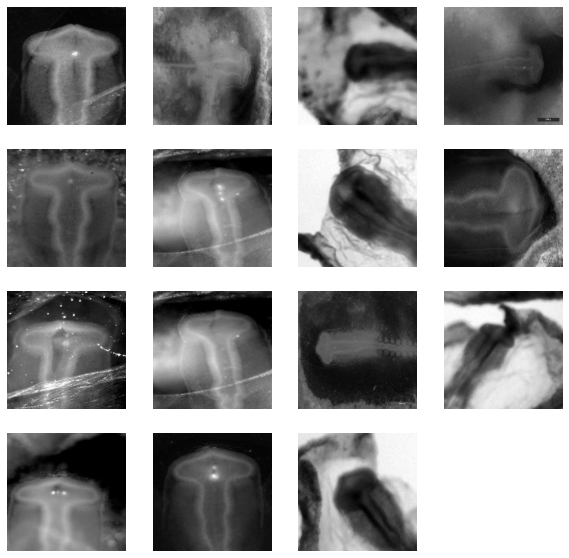

In [ ]:
visualise_all(split1)

# Cutout

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

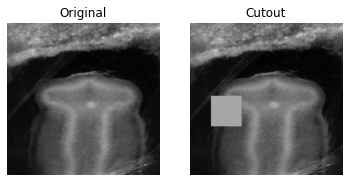

In [ ]:
image = cv2.imread('labeled_data/10_2/10.2_029.jpg', cv2.IMREAD_GRAYSCALE)
cutout = iaa.Cutout()
cropped = cutout(image = image)
visualize(image, cropped, label2 = 'Cutout')
plt.savefig('cutout.png')
files.download('cutout.png')

In [ ]:
split1aug = []
for feature, label in split1:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      feature3 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      feature3 = rotate(image = feature3)
      split1aug.append([feature, label])
      split1aug.append([feature2, label])
      split1aug.append([feature3, label])
  
split2aug = []
for feature, label in split2:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      feature3 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      feature3 = rotate(image = feature3)
      split2aug.append([feature, label])
      split2aug.append([feature2, label])
      split2aug.append([feature3, label])

split3aug = []
for feature, label in split3:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      feature3 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      feature3 = rotate(image = feature3)
      split3aug.append([feature, label])
      split3aug.append([feature2, label])
      split3aug.append([feature3, label])

split4aug = []
for feature, label in split4:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      feature3 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      feature3 = rotate(image = feature3)
      split4aug.append([feature, label])
      split4aug.append([feature2, label])
      split4aug.append([feature3, label])

split5aug = []
for feature, label in split5:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      feature3 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      feature3 = rotate(image = feature3)
      split5aug.append([feature, label])
      split5aug.append([feature2, label])
      split5aug.append([feature3, label])

split6aug = []
for feature, label in split6:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      feature3 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      feature3 = rotate(image = feature3)
      split6aug.append([feature, label])
      split6aug.append([feature2, label])
      split6aug.append([feature3, label])

split7aug = []
for feature, label in split7:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      feature3 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      feature3 = rotate(image = feature3)
      split7aug.append([feature, label])
      split7aug.append([feature2, label])
      split7aug.append([feature3, label])

split8aug = []
for feature, label in split8:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      feature3 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      feature3 = rotate(image = feature3)
      split8aug.append([feature, label])
      split8aug.append([feature2, label])
      split8aug.append([feature3, label])

split9aug = []
for feature, label in split9:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      feature3 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      feature3 = rotate(image = feature3)
      split9aug.append([feature, label])
      split9aug.append([feature2, label])
      split9aug.append([feature3, label])

split10aug = []
for feature, label in split10:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      feature3 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      feature3 = rotate(image = feature3)
      split10aug.append([feature, label])
      split10aug.append([feature2, label])
      split10aug.append([feature3, label])

train1 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val1 = split1aug
train2 = np.concatenate([split1aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val2 = split2aug
train3 = np.concatenate([split2aug, split1aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val3 = split3aug
train4 = np.concatenate([split2aug, split3aug, split1aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val4 = split4aug
train5 = np.concatenate([split2aug, split3aug, split4aug, split1aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val5 = split5aug
train6 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split1aug, split7aug, split8aug, split9aug, split10aug])
val6 = split6aug
train7 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split1aug, split8aug, split9aug, split10aug])
val7 = split7aug
train8 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split1aug, split9aug, split10aug])
val8 = split8aug
train9 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split1aug, split10aug])
val9 = split9aug
train10 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split1aug])
val10 = split10aug

<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


In [ ]:
%%time
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1
X_train shape: (14688, 200, 200, 1)
X_val shape: (1620, 200, 200, 1)
y_train shape: (14688, 3)
y_val shape: (1620, 3)
Epoch 1/50
459/459 [==============================] - 24s 49ms/step - loss: 1.0308 - accuracy: 0.5298 - val_loss: 1.0692 - val_accuracy: 0.5809
Epoch 2/50
459/459 [==============================] - 22s 47ms/step - loss: 0.4792 - accuracy: 0.8565 - val_loss: 0.8338 - val_accuracy: 0.7191
Epoch 3/50
459/459 [==============================] - 22s 48ms/step - loss: 0.2243 - accuracy: 0.9590 - val_loss: 0.7537 - val_accuracy: 0.7068
Epoch 4/50
459/459 [==============================] - 22s 48ms/step - loss: 0.1569 - accuracy: 0.9833 - val_loss: 0.7600 - val_accuracy: 0.7160
Epoch 5/50
459/459 [==============================] - 22s 48ms/step - loss: 0.1381 - accuracy: 0.9880 - val_loss: 0.6476 - val_accuracy: 0.7519
Epoch 6/50
459/459 [==============================] - 22s 48ms/step - loss: 0.1193 - accuracy: 0.9930 - val_loss: 0.6500 - val_accuracy: 0.7444
E

KeyboardInterrupt: ignored

In [ ]:
%%time
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1
X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/50
306/306 [==============================] - 10s 30ms/step - loss: 1.1189 - accuracy: 0.4651 - val_loss: 1.1556 - val_accuracy: 0.4750
Epoch 2/50
306/306 [==============================] - 9s 29ms/step - loss: 0.7360 - accuracy: 0.7371 - val_loss: 0.9801 - val_accuracy: 0.5898
Epoch 3/50
306/306 [==============================] - 9s 29ms/step - loss: 0.4144 - accuracy: 0.8907 - val_loss: 0.8922 - val_accuracy: 0.6722
Epoch 4/50
306/306 [==============================] - 9s 29ms/step - loss: 0.2424 - accuracy: 0.9547 - val_loss: 0.7535 - val_accuracy: 0.7250
Epoch 5/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1725 - accuracy: 0.9772 - val_loss: 0.6902 - val_accuracy: 0.7565
Epoch 6/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1457 - accuracy: 0.9858 - val_loss: 0.6195 - val_accuracy: 0.7667
Epoch 7/

InternalError: ignored

In [ ]:
valaccs = [79.6, 91.9, 89.7, 74.1, 75.9, 64.4, 76.3, 56.8]
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 9
X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/50
306/306 [==============================] - 14s 30ms/step - loss: 1.1204 - accuracy: 0.4679 - val_loss: 1.2224 - val_accuracy: 0.4231
Epoch 2/50
306/306 [==============================] - 9s 29ms/step - loss: 0.7091 - accuracy: 0.7400 - val_loss: 1.1352 - val_accuracy: 0.5537
Epoch 3/50
306/306 [==============================] - 9s 29ms/step - loss: 0.3839 - accuracy: 0.9010 - val_loss: 1.1385 - val_accuracy: 0.5269
Epoch 4/50
306/306 [==============================] - 9s 29ms/step - loss: 0.2311 - accuracy: 0.9608 - val_loss: 1.0750 - val_accuracy: 0.5759
Epoch 5/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1637 - accuracy: 0.9814 - val_loss: 1.1593 - val_accuracy: 0.5130
Epoch 6/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1514 - accuracy: 0.9858 - val_loss: 0.9853 - val_accuracy: 0.6019
Epoch 7/

## Repeats with optimal parameters

In [ ]:
def train_model(train, val):

  random.seed(1234)
  random.shuffle(train)
  random.shuffle(val)
  # random.shuffle(test_data)

  # Preprocessing the data into X_train etc with relevant input shapes
  X_train = []
  y_train = []
  X_val = []
  y_val = []
  X_test = []
  y_test = []
  img_size = 200

  for feature, label in train:
    X_train.append(feature)
    y_train.append(label)

  for feature, label in val:
    X_val.append(feature)
    y_val.append(label)

  # for feature, label in test_data:
  #   X_test.append(feature)
  #   y_test.append(label)

  X_train = np.array(X_train) / 255
  X_val = np.array(X_val) / 255
  # X_test = np.array(X_test) / 255

  X_train = X_train.reshape(X_train.shape[0], 200, 200, 1)
  X_val = X_val.reshape(X_val.shape[0], 200, 200, 1)
  # X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

  X_train.astype('float32')
  X_val.astype('float32')
  # X_test.astype('float32')

  y_train=to_categorical(y_train)
  y_val=to_categorical(y_val)
  # y_test = to_categorical(y_test)

  print('X_train shape:', np.shape(X_train))
  print('X_val shape:', np.shape(X_val))
  # print('X_test shape:', np.shape(X_test))
  print('y_train shape:', np.shape(y_train))
  print('y_val shape:', np.shape(y_val))
  # print('y_test shape:', np.shape(y_test))

  from tensorflow.keras import layers
  from tensorflow.keras import regularizers
  layer_drop = 0.01
  final_drop = 0.4
  activation = 'relu'
  lamda = 0.000001
  model = Sequential([
    layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 1), kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Flatten(),
    layers.Dense(1024, activation=activation),
    layers.Dropout(final_drop),
    layers.Dense(3, activation = 'softmax')
  ])
  #opt = Adam(learning_rate = learning_rate)
  model.compile(optimizer = Adam(learning_rate = 0.00001),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

  earlyStop = EarlyStopping(monitor = 'val_loss', min_delta = 0.01, patience = 10)
  epochs = 50
  history = model.fit(x=X_train,
                      y=y_train,
                      epochs=epochs,
                      batch_size=32,
                      validation_data=(X_val, y_val))

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']
  accuracy = history.history['val_accuracy'][-1]
  # testvals = model.evaluate(X_test, y_test)

  # valaccs.append(round(max(val_acc)*100, 1))
  # vallosses.append(round(min(val_loss)*100, 1))
  # accs.append(round(max(acc)*100, 1))
  # acclosses.append(round(min(loss)*100, 1))
  # testaccs.append(round(testvals[1]*100, 1))
  # testlosses.append(round(testvals[0]*100, 1))

  del model
  K.clear_session()

  return round(max(val_acc)*100, 1)

In [ ]:
%%time
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1
X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/50
306/306 [==============================] - 25s 31ms/step - loss: 1.0635 - accuracy: 0.4185 - val_loss: 1.1107 - val_accuracy: 0.3519
Epoch 2/50
306/306 [==============================] - 9s 29ms/step - loss: 0.9768 - accuracy: 0.5205 - val_loss: 1.1413 - val_accuracy: 0.4120
Epoch 3/50
306/306 [==============================] - 9s 29ms/step - loss: 0.8811 - accuracy: 0.5963 - val_loss: 1.0714 - val_accuracy: 0.4176
Epoch 4/50
306/306 [==============================] - 9s 29ms/step - loss: 0.7590 - accuracy: 0.6722 - val_loss: 1.1335 - val_accuracy: 0.5472
Epoch 5/50
306/306 [==============================] - 9s 29ms/step - loss: 0.6387 - accuracy: 0.7398 - val_loss: 1.0384 - val_accuracy: 0.5741
Epoch 6/50
306/306 [==============================] - 9s 29ms/step - loss: 0.5221 - accuracy: 0.8023 - val_loss: 0.9207 - val_accuracy: 0.6278
Epoch 7/

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

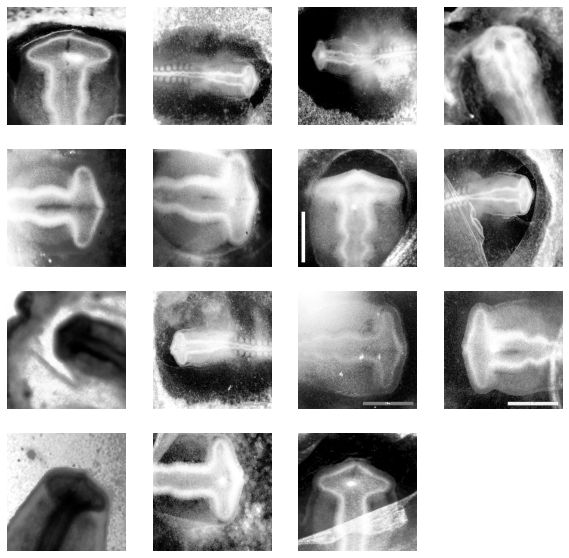

In [ ]:
features = []
for feature, label in split10:
  feature = cv2.equalizeHist(feature)
  features.append([feature, label])
visualise_all(features)
plt.savefig('split10.png')
files.download('split10.png')

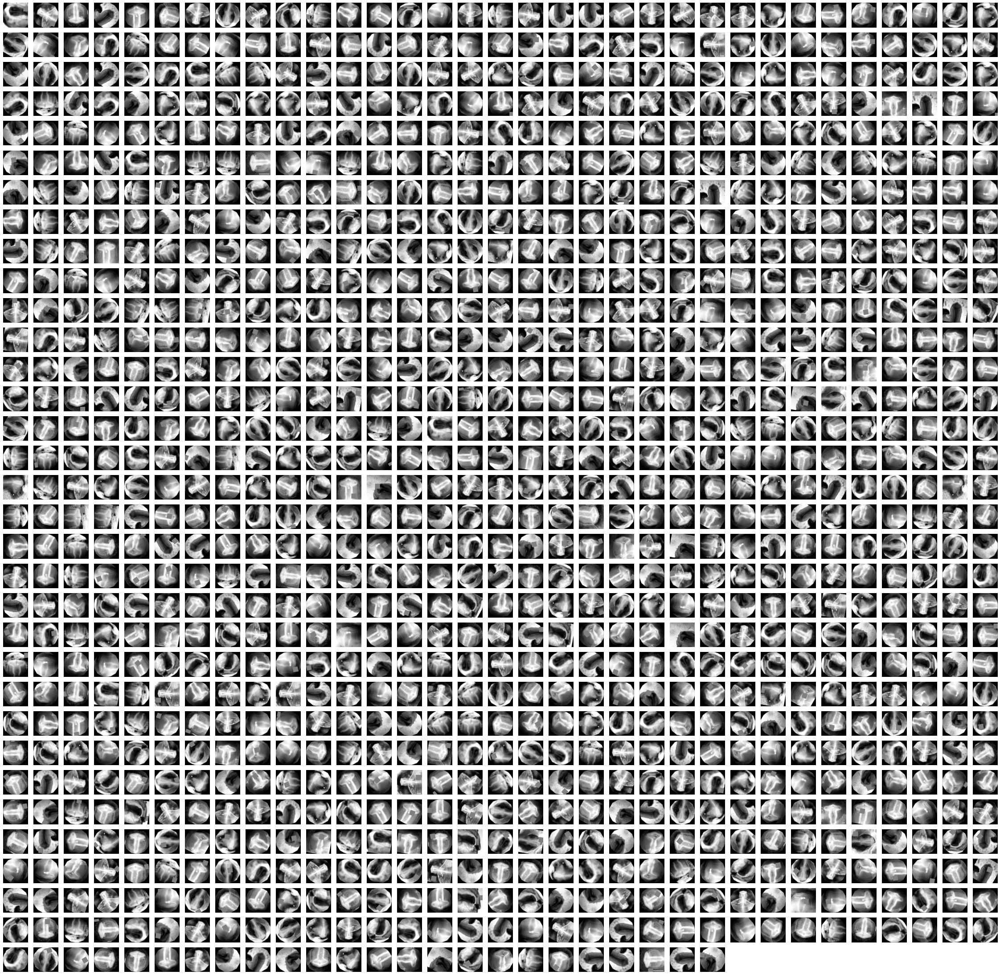

In [ ]:
visualise_all(split8aug, 40, 40)

In [ ]:
  random.seed(5)
  random.shuffle(train8)
  random.shuffle(val8)
  # random.shuffle(test_data)

  # Preprocessing the data into X_train etc with relevant input shapes
  X_train = []
  y_train = []
  X_val = []
  y_val = []
  X_test = []
  y_test = []
  img_size = 200

  for feature, label in train8:
    X_train.append(feature)
    y_train.append(label)

  for feature, label in val8:
    X_val.append(feature)
    y_val.append(label)

  # for feature, label in test_data:
  #   X_test.append(feature)
  #   y_test.append(label)

  X_train = np.array(X_train) / 255
  X_val = np.array(X_val) / 255
  # X_test = np.array(X_test) / 255

  X_train = X_train.reshape(X_train.shape[0], 200, 200, 1)
  X_val = X_val.reshape(X_val.shape[0], 200, 200, 1)
  # X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

  X_train.astype('float32')
  X_val.astype('float32')
  # X_test.astype('float32')

  y_train=to_categorical(y_train)
  y_val=to_categorical(y_val)
  # y_test = to_categorical(y_test)

  print('X_train shape:', np.shape(X_train))
  print('X_val shape:', np.shape(X_val))
  # print('X_test shape:', np.shape(X_test))
  print('y_train shape:', np.shape(y_train))
  print('y_val shape:', np.shape(y_val))
  # print('y_test shape:', np.shape(y_test))

  from tensorflow.keras import layers
  from tensorflow.keras import regularizers
  layer_drop = 0.01
  final_drop = 0.4
  activation = 'relu'
  lamda = 0.000001
  model = Sequential([
    layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 1), kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Flatten(),
    layers.Dense(1024, activation=activation),
    layers.Dropout(final_drop),
    layers.Dense(3, activation = 'softmax')
  ])
  #opt = Adam(learning_rate = learning_rate)
  model.compile(optimizer = Adam(learning_rate = 0.00001),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

  earlyStop = EarlyStopping(monitor = 'val_loss',  mode = 'min', patience = 10)
  epochs = 50
  history = model.fit(x=X_train,
                      y=y_train,
                      epochs=epochs,
                      batch_size=32,
                      validation_data=(X_val, y_val),
                      callbacks = [earlyStop])

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']
  accuracy = history.history['val_accuracy'][-1]

X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/50
306/306 [==============================] - 26s 31ms/step - loss: 1.0784 - accuracy: 0.3951 - val_loss: 1.0467 - val_accuracy: 0.3222
Epoch 2/50
306/306 [==============================] - 9s 29ms/step - loss: 0.9951 - accuracy: 0.5173 - val_loss: 1.1975 - val_accuracy: 0.2750
Epoch 3/50
306/306 [==============================] - 9s 29ms/step - loss: 0.9065 - accuracy: 0.5804 - val_loss: 1.1297 - val_accuracy: 0.3083
Epoch 4/50
306/306 [==============================] - 9s 29ms/step - loss: 0.7762 - accuracy: 0.6553 - val_loss: 1.1956 - val_accuracy: 0.3833
Epoch 5/50
306/306 [==============================] - 9s 29ms/step - loss: 0.6486 - accuracy: 0.7347 - val_loss: 1.2820 - val_accuracy: 0.4000
Epoch 6/50
306/306 [==============================] - 9s 29ms/step - loss: 0.5369 - accuracy: 0.7886 - val_loss: 1.6386 - val_accuracy: 0.2917
Epoch 7/50
306/306 [=====

Number of 10.1s: [3700]
Number of 10.2s: [3371]
Number of 10.3s: [2721]
Number of 10.1s: [504]
Number of 10.2s: [504]
Number of 10.3s: [72]


/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


Number of 10.1s: [22]
Number of 10.2s: [18]
Number of 10.3s: [9]
Percetage of 10.1s less than 0.5 [0.04365079]
Percetage of 10.2s less than 0.5 [0.03571429]
Percetage of 10.3s less than 0.5 [0.125]


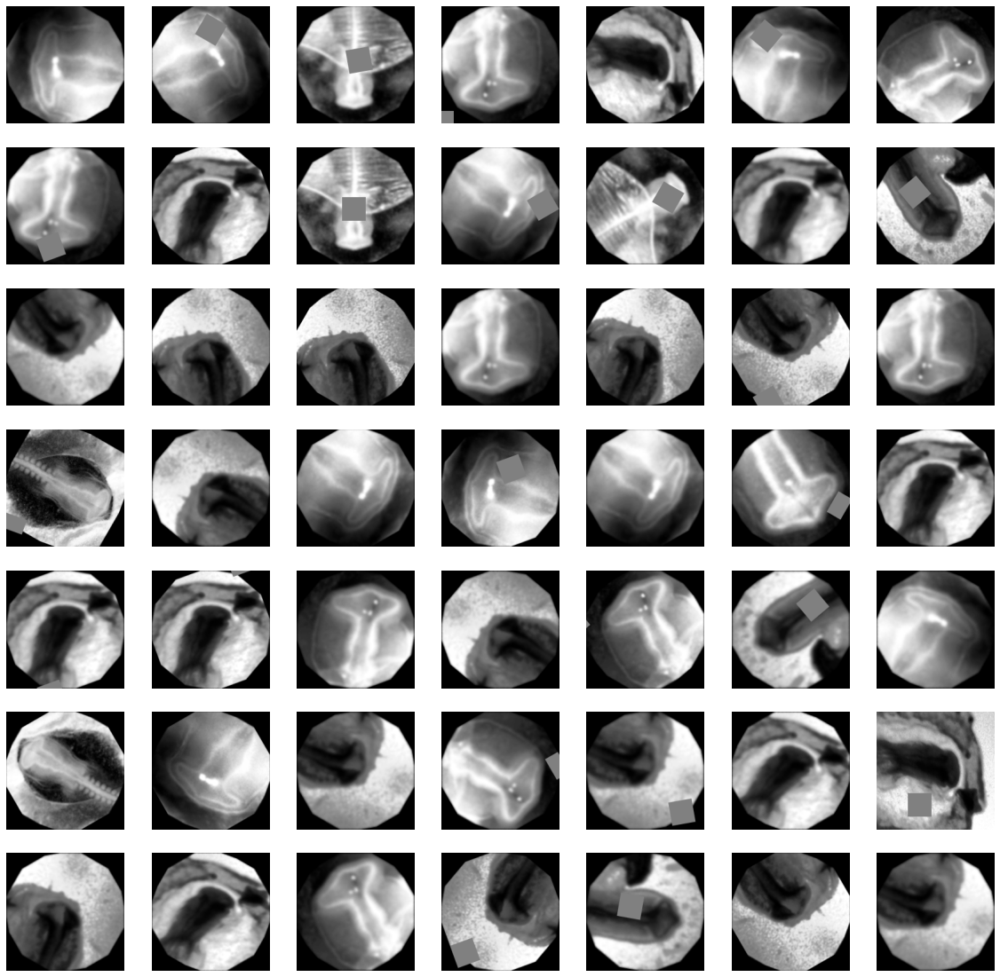

In [ ]:
trainclasses = []
for i in range(9792):
  trainclasses.append(np.where(y_train[i]==1))
trainclasses = np.concatenate(trainclasses)
print('Number of 10.1s:', sum(trainclasses == 0))
print('Number of 10.2s:', sum(trainclasses == 1))
print('Number of 10.3s:', sum(trainclasses == 2))

valclasses = []
for i in range(1080):
  valclasses.append(np.where(y_val[i]==1))
valclasses = np.concatenate(valclasses)
print('Number of 10.1s:', sum(valclasses == 0))
print('Number of 10.2s:', sum(valclasses == 1))
print('Number of 10.3s:', sum(valclasses == 2))

fig = plt.figure(figsize=(20, 20))
results = model.predict(X_val)
nums = []
classes = []
for i in range(np.shape(val8)[0]):
  nums.append(max(list(results[i])))
id = []
for num in nums:
  if num < 0.5:
    id.append(nums.index(num))
images = []
for i in id:
  images.append(val8[i][0])
  classes.append(np.where(y_val[i]==1))
for i in range(len(images)):
  plt.subplot((int(math.ceil(np.sqrt(len(id))))), 
              (int(math.ceil(np.sqrt(len(id))))), 
              i+1)
  plt.imshow(images[i], cmap = 'gray')
  plt.axis('off')
classes = np.concatenate(classes)
print('Number of 10.1s:', sum(classes == 0))
print('Number of 10.2s:', sum(classes == 1))
print('Number of 10.3s:', sum(classes == 2))
print('Percetage of 10.1s less than 0.5', sum(classes == 0)/sum(valclasses == 0))
print('Percetage of 10.2s less than 0.5', sum(classes == 1)/sum(valclasses == 1))
print('Percetage of 10.3s less than 0.5', sum(classes == 2)/sum(valclasses == 2))

Number of 10.1s: [170]
Number of 10.2s: [293]
Number of 10.3s: [2]
Percetage of 10.1s more than 0.9 [0.33730159]
Percetage of 10.2s more than 0.9 [0.58134921]
Percetage of 10.3s more than 0.9 [0.02777778]


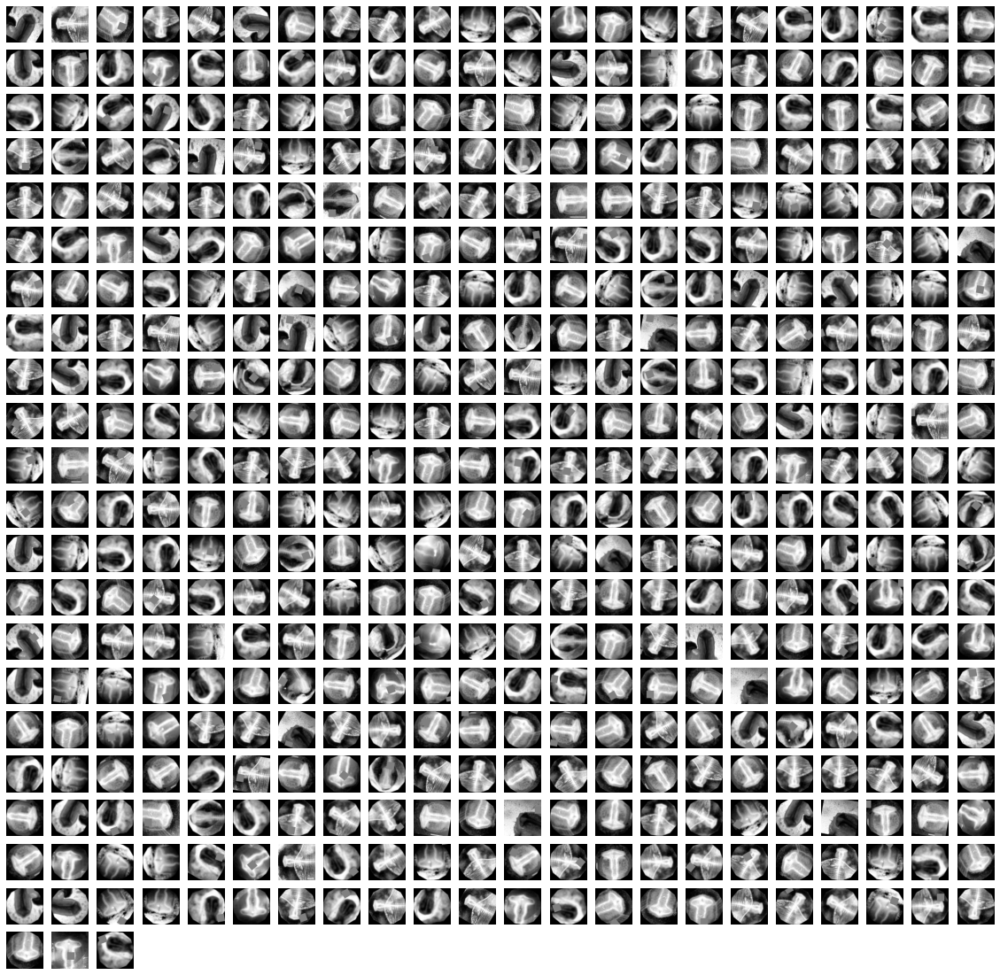

In [ ]:
fig = plt.figure(figsize=(20, 20))
results = model.predict(X_val)
nums = []
classes = []
for i in range(np.shape(X_val)[0]):
  nums.append(max(list(results[i])))
id = []
for num in nums:
  if num > 0.9:
    id.append(nums.index(num))
images = []
for i in id:
  images.append(val8[i][0])
  classes.append(np.where(y_val[i]==1))
for i in range(len(images)):
  plt.subplot((int(math.ceil(np.sqrt(len(id))))), 
              (int(math.ceil(np.sqrt(len(id))))), 
              i+1)
  plt.imshow(images[i], cmap = 'gray')
  plt.axis('off')
classes = np.concatenate(classes)
print('Number of 10.1s:', sum(classes == 0))
print('Number of 10.2s:', sum(classes == 1))
print('Number of 10.3s:', sum(classes == 2))
print('Percetage of 10.1s more than 0.9', sum(classes == 0)/sum(valclasses == 0))
print('Percetage of 10.2s more than 0.9', sum(classes == 1)/sum(valclasses == 1))
print('Percetage of 10.3s more than 0.9', sum(classes == 2)/sum(valclasses == 2))

In [ ]:
split1aug = []
for feature, label in split1:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      feature = imutils.rotate_bound(feature, angle)
      split1aug.append([feature, label])
  
split2aug = []
for feature, label in split2:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      feature = imutils.rotate_bound(feature, angle)
      split2aug.append([feature, label])

split3aug = []
for feature, label in split3:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      feature = imutils.rotate_bound(feature, angle)
      split3aug.append([feature, label])

split4aug = []
for feature, label in split4:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      feature = imutils.rotate_bound(feature, angle)
      split4aug.append([feature, label])

split5aug = []
for feature, label in split5:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      feature = imutils.rotate_bound(feature, angle)
      split5aug.append([feature, label])

split6aug = []
for feature, label in split6:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      feature = imutils.rotate_bound(feature, angle)
      split6aug.append([feature, label])

split7aug = []
for feature, label in split7:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      feature = imutils.rotate_bound(feature, angle)
      split7aug.append([feature, label])

split8aug = []
for feature, label in split8:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      feature = imutils.rotate_bound(feature, angle)
      split8aug.append([feature, label])

split9aug = []
for feature, label in split9:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      feature = imutils.rotate_bound(feature, angle)
      split9aug.append([feature, label])

split10aug = []
for feature, label in split10:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      feature = imutils.rotate_bound(feature, angle)
      split10aug.append([feature, label])

train1 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val1 = split1aug
train2 = np.concatenate([split1aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val2 = split2aug
train3 = np.concatenate([split2aug, split1aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val3 = split3aug
train4 = np.concatenate([split2aug, split3aug, split1aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val4 = split4aug
train5 = np.concatenate([split2aug, split3aug, split4aug, split1aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val5 = split5aug
train6 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split1aug, split7aug, split8aug, split9aug, split10aug])
val6 = split6aug
train7 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split1aug, split8aug, split9aug, split10aug])
val7 = split7aug
train8 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split1aug, split9aug, split10aug])
val8 = split8aug
train9 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split1aug, split10aug])
val9 = split9aug
train10 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split1aug])
val10 = split10aug

error: ignored

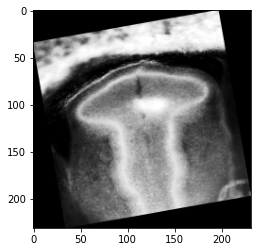

In [ ]:
plt.imshow(split10[0][0])
plt.imshow(imutils.rotate_bound(cv2.equalizeHist(split10[0][0]), -10), cmap = 'gray')

In [ ]:
train_model(train8, val8)

X_train shape: (9792, 200, 200, 1)
X_val shape: (792, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (792, 3)
Epoch 1/50
306/306 [==============================] - 10s 30ms/step - loss: 0.9651 - accuracy: 0.5871 - val_loss: 1.2662 - val_accuracy: 0.3813
Epoch 2/50
306/306 [==============================] - 9s 29ms/step - loss: 0.4267 - accuracy: 0.8850 - val_loss: 1.4040 - val_accuracy: 0.4116
Epoch 3/50
306/306 [==============================] - 9s 29ms/step - loss: 0.2603 - accuracy: 0.9499 - val_loss: 1.6530 - val_accuracy: 0.3699
Epoch 4/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1927 - accuracy: 0.9729 - val_loss: 1.6286 - val_accuracy: 0.4066
Epoch 5/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1655 - accuracy: 0.9828 - val_loss: 1.7909 - val_accuracy: 0.4394
Epoch 6/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1428 - accuracy: 0.9885 - val_loss: 1.5866 - val_accuracy: 0.4242
Epoch 7/50
306/306 [=======

47.0

# Salt and pepper

In [ ]:
sp = iaa.SaltAndPepper(0.2)
  feature2 = sp(image = feature)

In [ ]:
valaccs = []
vallosses = []
accs = []
acclosses = []
testaccs = []
testlosses = []
for i in range(20):

  random.shuffle(tdata)
  training_data = tdata[0:int(round(len(tdata)*0.8, 0))]
  val_data = tdata[int(round(len(tdata)*0.8, 0)):int(round(len(tdata), 0))]
  # test_data = tdata[int(round(len(tdata)*0.95, 0)):int(round(len(tdata), 0))]

  train = []
  for feature, label in training_data:
    for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      sp = iaa.SaltAndPepper(0.2)
      feature2 = sp(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      train.append([feature, label])
      train.append([feature2, label])

  val = []
  for feature, label in val_data:
    for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      sp = iaa.SaltAndPepper(0.2)
      feature2 = sp(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      val.append([feature, label])
      val.append([feature2, label])

  random.shuffle(train)
  random.shuffle(val)
  # random.shuffle(test_data)

  # Preprocessing the data into X_train etc with relevant input shapes
  X_train = []
  y_train = []
  X_val = []
  y_val = []
  X_test = []
  y_test = []
  img_size = 200

  for feature, label in train:
    X_train.append(feature)
    y_train.append(label)

  for feature, label in val:
    X_val.append(feature)
    y_val.append(label)

  # for feature, label in test_data:
  #   X_test.append(feature)
  #   y_test.append(label)

  X_train = np.array(X_train) / 255
  X_val = np.array(X_val) / 255
  # X_test = np.array(X_test) / 255

  X_train = X_train.reshape(X_train.shape[0], 200, 200, 1)
  X_val = X_val.reshape(X_val.shape[0], 200, 200, 1)
  # X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

  X_train.astype('float32')
  X_val.astype('float32')
  # X_test.astype('float32')

  y_train=to_categorical(y_train)
  y_val=to_categorical(y_val)
  # y_test = to_categorical(y_test)

  print('X_train shape:', np.shape(X_train))
  print('X_val shape:', np.shape(X_val))
  # print('X_test shape:', np.shape(X_test))
  print('y_train shape:', np.shape(y_train))
  print('y_val shape:', np.shape(y_val))
  # print('y_test shape:', np.shape(y_test))

  from tensorflow.keras import layers
  from tensorflow.keras import regularizers
  layer_drop = 0.2
  final_drop = 0.5
  activation = 'relu'
  lamda = 0.0001
  model = Sequential([
    layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 1), kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Flatten(),
    layers.Dense(1024, activation=activation),
    layers.Dropout(final_drop),
    layers.Dense(3, activation = 'softmax')
  ])
  #opt = Adam(learning_rate = learning_rate)
  model.compile(optimizer = Adam(learning_rate = 0.0001),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

  earlyStop = EarlyStopping(monitor = 'val_loss', min_delta = 0.01, patience = 5)
  epochs = 50
  history = model.fit(x=X_train,
                      y=y_train,
                      epochs=epochs,
                      batch_size=32,
                      validation_data=(X_val, y_val),
                      callbacks=[earlyStop])

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']
  accuracy = history.history['val_accuracy'][-1]
  # testvals = model.evaluate(X_test, y_test)

  valaccs.append(round(max(val_acc)*100, 1))
  vallosses.append(round(min(val_loss)*100, 1))
  accs.append(round(max(acc)*100, 1))
  acclosses.append(round(min(loss)*100, 1))
  # testaccs.append(round(testvals[1]*100, 1))
  # testlosses.append(round(testvals[0]*100, 1))

  del model
  K.clear_session()

print('Accuracies:', accs)
print('Average accuracy:', round(np.mean(accs),1))
print('Average loss:', round(np.mean(acclosses),1))
print('Accuracy standard deviation:', np.std(accs))
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Average validation loss:', round(np.mean(vallosses),1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
# print('Test accuracies:', testaccs)
# print('Average test accuracy:', round(np.mean(testaccs), 1))
# print('Average test loss:', round(np.mean(testlosses),1))
# print('Test standard deviation:', round(np.std(testaccs), 1))

# Cutout + blur

In [ ]:
valaccs = []
vallosses = []
accs = []
acclosses = []
testaccs = []
testlosses = []
for i in range(10):

  random.shuffle(tdata)
  training_data = tdata[0:int(round(len(tdata)*0.8, 0))]
  val_data = tdata[int(round(len(tdata)*0.8, 0)):int(round(len(tdata), 0))]
  # test_data = tdata[int(round(len(tdata)*0.95, 0)):int(round(len(tdata), 0))]

  train = []
  for feature, label in training_data:
    for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      shear = iaa.ShearX(20)
      blur = iaa.GaussianBlur(sigma = 5)
      feature2 = cutout(image = feature)
      feature3 = blur(image = feature)
      feature4 = shear(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      feature3 = rotate(image = feature3)
      feature4 = rotate(image = feature4)
      train.append([feature, label])
      train.append([feature2, label])
      train.append([feature3, label])
      train.append([feature4, label])

  val = []
  for feature, label in val_data:
    for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      shear = iaa.ShearX(20)
      blur = iaa.GaussianBlur(sigma = 5)
      feature2 = cutout(image = feature)
      feature3 = blur(image = feature)
      feature4 = shear(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      feature3 = rotate(image = feature3)
      feature4 = rotate(image = feature4)
      val.append([feature, label])
      val.append([feature2, label])
      val.append([feature3, label])
      val.append([feature4, label])

  random.shuffle(train)
  random.shuffle(val)
  # random.shuffle(test_data)

  # Preprocessing the data into X_train etc with relevant input shapes
  X_train = []
  y_train = []
  X_val = []
  y_val = []
  X_test = []
  y_test = []
  img_size = 200

  for feature, label in train:
    X_train.append(feature)
    y_train.append(label)

  for feature, label in val:
    X_val.append(feature)
    y_val.append(label)

  # for feature, label in test_data:
  #   X_test.append(feature)
  #   y_test.append(label)

  X_train = np.array(X_train) / 255
  X_val = np.array(X_val) / 255
  # X_test = np.array(X_test) / 255

  X_train = X_train.reshape(X_train.shape[0], 200, 200, 1)
  X_val = X_val.reshape(X_val.shape[0], 200, 200, 1)
  # X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

  X_train.astype('float32')
  X_val.astype('float32')
  # X_test.astype('float32')

  y_train=to_categorical(y_train)
  y_val=to_categorical(y_val)
  # y_test = to_categorical(y_test)

  print('X_train shape:', np.shape(X_train))
  print('X_val shape:', np.shape(X_val))
  # print('X_test shape:', np.shape(X_test))
  print('y_train shape:', np.shape(y_train))
  print('y_val shape:', np.shape(y_val))
  # print('y_test shape:', np.shape(y_test))

  from tensorflow.keras import layers
  from tensorflow.keras import regularizers
  layer_drop = 0.2
  final_drop = 0.5
  activation = 'relu'
  lamda = 0.0001
  model = Sequential([
    layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 1), kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Flatten(),
    layers.Dense(1024, activation=activation),
    layers.Dropout(final_drop),
    layers.Dense(3, activation = 'softmax')
  ])
  #opt = Adam(learning_rate = learning_rate)
  model.compile(optimizer = Adam(learning_rate = 0.0001),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

  earlyStop = EarlyStopping(monitor = 'val_loss', min_delta = 0.01, patience = 5)
  epochs = 50
  history = model.fit(x=X_train,
                      y=y_train,
                      epochs=epochs,
                      batch_size=32,
                      validation_data=(X_val, y_val),
                      callbacks=[earlyStop])

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']
  accuracy = history.history['val_accuracy'][-1]
  # testvals = model.evaluate(X_test, y_test)

  valaccs.append(round(max(val_acc)*100, 1))
  vallosses.append(round(min(val_loss)*100, 1))
  accs.append(round(max(acc)*100, 1))
  acclosses.append(round(min(loss)*100, 1))
  # testaccs.append(round(testvals[1]*100, 1))
  # testlosses.append(round(testvals[0]*100, 1))

  del model
  K.clear_session()

print('Accuracies:', accs)
print('Average accuracy:', round(np.mean(accs),1))
print('Average loss:', round(np.mean(acclosses),1))
print('Accuracy standard deviation:', np.std(accs))
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Average validation loss:', round(np.mean(vallosses),1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
# print('Test accuracies:', testaccs)
# print('Average test accuracy:', round(np.mean(testaccs), 1))
# print('Average test loss:', round(np.mean(testlosses),1))
# print('Test standard deviation:', round(np.std(testaccs), 1))

X_train shape: (17424, 200, 200, 1)
X_val shape: (4320, 200, 200, 1)
y_train shape: (17424, 3)
y_val shape: (4320, 3)
Epoch 1/50
545/545 [==============================] - 18s 31ms/step - loss: 1.0903 - accuracy: 0.4700 - val_loss: 1.0982 - val_accuracy: 0.6319
Epoch 2/50
545/545 [==============================] - 16s 29ms/step - loss: 0.5297 - accuracy: 0.8177 - val_loss: 0.9143 - val_accuracy: 0.6616
Epoch 3/50
545/545 [==============================] - 16s 29ms/step - loss: 0.2103 - accuracy: 0.9578 - val_loss: 0.8184 - val_accuracy: 0.7285
Epoch 4/50
545/545 [==============================] - 16s 29ms/step - loss: 0.1477 - accuracy: 0.9791 - val_loss: 0.7656 - val_accuracy: 0.7431
Epoch 5/50
545/545 [==============================] - 16s 29ms/step - loss: 0.1224 - accuracy: 0.9894 - val_loss: 0.8418 - val_accuracy: 0.7421
Epoch 6/50
545/545 [==============================] - 16s 29ms/step - loss: 0.1181 - accuracy: 0.9898 - val_loss: 0.8343 - val_accuracy: 0.7292
Epoch 7/50
545/545

InternalError: ignored

# Gamma contrast

Grayscale helps the orange/green images return back to a similar colour to the other iamges, however, the embryo is black instead of grey/white. Therefore, we need a function that will make the features of the darker images more apparent, but also not effect the brighter images too much. Changing the gamma contrast should help here.

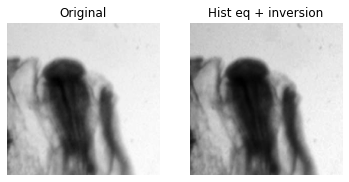

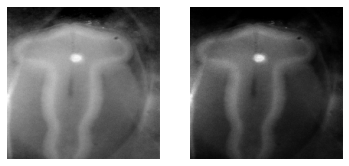

In [ ]:
gamma = iaa.GammaContrast(2)
image = cv2.resize(cv2.imread('labeled_data/10_2/10.2_033.jpg', cv2.IMREAD_GRAYSCALE), (200, 200))
preprocess = gamma(image = image)
visualize(image, preprocess, 'Original', 'Hist eq + inversion')
image = cv2.resize(cv2.imread('labeled_data/10_2/10.2_035.jpg', cv2.IMREAD_GRAYSCALE), (200, 200))
preprocess = gamma(image = image)
visualize(image, preprocess, '', '')

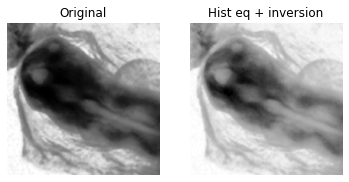

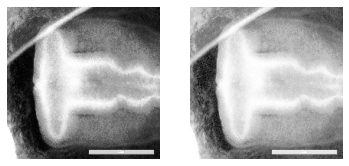

In [ ]:
gamma = iaa.GammaContrast(0.5)
image = cv2.resize(cv2.imread('labeled_data/10_3/10.3_020.jpg', cv2.IMREAD_GRAYSCALE), (200, 200))
image = cv2.equalizeHist(image)
preprocess = gamma(image = image)
visualize(image, preprocess, 'Original', 'Hist eq + inversion')
image = cv2.resize(cv2.imread('labeled_data/10_3/10.3_021.jpg', cv2.IMREAD_GRAYSCALE), (200, 200))
image = cv2.equalizeHist(image)
preprocess = gamma(image = image)
visualize(image, preprocess, '', '')


If this is applied to a copy of each image, then we should have equal parts of these black and white embryos, so this should help this being identified as a feature.

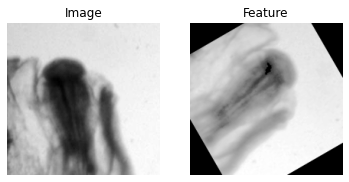

In [ ]:
feature = image = cv2.resize(cv2.imread('labeled_data/10_2/10.2_033.jpg', cv2.IMREAD_GRAYSCALE), (200, 200))
feature = cv2.equalizeHist(feature)
gamma = iaa.GammaContrast(0.25)
feature = gamma(image = feature)
rotate = iaa.geometric.Affine(rotate = 60)
feature = rotate(image = feature)
visualize(image, feature, 'Image', 'Feature')

In [ ]:
split1aug = []
for feature, label in split1:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gamma = iaa.GammaContrast(0.25)
      feature2 = gamma(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split1aug.append([feature, label])
      split1aug.append([feature2, label])
  
split2aug = []
for feature, label in split2:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gamma = iaa.GammaContrast(0.25)
      feature2 = gamma(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split2aug.append([feature, label])
      split2aug.append([feature2, label])

split3aug = []
for feature, label in split3:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gamma = iaa.GammaContrast(0.25)
      feature2 = gamma(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split3aug.append([feature, label])
      split3aug.append([feature2, label])

split4aug = []
for feature, label in split4:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gamma = iaa.GammaContrast(0.25)
      feature2 = gamma(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split4aug.append([feature, label])
      split4aug.append([feature2, label])

split5aug = []
for feature, label in split5:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gamma = iaa.GammaContrast(0.25)
      feature2 = gamma(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split5aug.append([feature, label])
      split5aug.append([feature2, label])

split6aug = []
for feature, label in split6:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gamma = iaa.GammaContrast(0.25)
      feature2 = gamma(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split6aug.append([feature, label])
      split6aug.append([feature2, label])

split7aug = []
for feature, label in split7:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gamma = iaa.GammaContrast(0.25)
      feature2 = gamma(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split7aug.append([feature, label])
      split7aug.append([feature2, label])

split8aug = []
for feature, label in split8:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gamma = iaa.GammaContrast(0.25)
      feature2 = gamma(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split8aug.append([feature, label])
      split8aug.append([feature2, label])

split9aug = []
for feature, label in split9:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gamma = iaa.GammaContrast(0.25)
      feature2 = gamma(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split9aug.append([feature, label])
      split9aug.append([feature2, label])

split10aug = []
for feature, label in split10:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      gamma = iaa.GammaContrast(0.25)
      feature2 = gamma(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split10aug.append([feature, label])
      split10aug.append([feature2, label])

train1 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val1 = split1aug
train2 = np.concatenate([split1aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val2 = split2aug
train3 = np.concatenate([split2aug, split1aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val3 = split3aug
train4 = np.concatenate([split2aug, split3aug, split1aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val4 = split4aug
train5 = np.concatenate([split2aug, split3aug, split4aug, split1aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val5 = split5aug
train6 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split1aug, split7aug, split8aug, split9aug, split10aug])
val6 = split6aug
train7 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split1aug, split8aug, split9aug, split10aug])
val7 = split7aug
train8 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split1aug, split9aug, split10aug])
val8 = split8aug
train9 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split1aug, split10aug])
val9 = split9aug
train10 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split1aug])
val10 = split10aug

<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


In [ ]:
%%time
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1
X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/50
306/306 [==============================] - 12s 30ms/step - loss: 1.1843 - accuracy: 0.3947 - val_loss: 1.1898 - val_accuracy: 0.3685
Epoch 2/50
306/306 [==============================] - 9s 29ms/step - loss: 1.0366 - accuracy: 0.5314 - val_loss: 1.1544 - val_accuracy: 0.4361
Epoch 3/50
306/306 [==============================] - 9s 29ms/step - loss: 0.7013 - accuracy: 0.7455 - val_loss: 0.9570 - val_accuracy: 0.6537
Epoch 4/50
306/306 [==============================] - 9s 29ms/step - loss: 0.4303 - accuracy: 0.8718 - val_loss: 0.8987 - val_accuracy: 0.6972
Epoch 5/50
306/306 [==============================] - 9s 29ms/step - loss: 0.2753 - accuracy: 0.9369 - val_loss: 0.8275 - val_accuracy: 0.6731
Epoch 6/50
306/306 [==============================] - 9s 29ms/step - loss: 0.2006 - accuracy: 0.9608 - val_loss: 0.8203 - val_accuracy: 0.6741
Epoch 7/

## Including gamma correction as preprocessing step instead

# Crop + translation

One of another key difference in the data is that some of the pictures are more zoomed in on the image than others. As seen below, you can see the main embryo plus some form of tail. Most of the other images are mostly taken up by just the main part of the embryo. Therefore, augmenting these images to look more like just the main embryo should help the classifier.

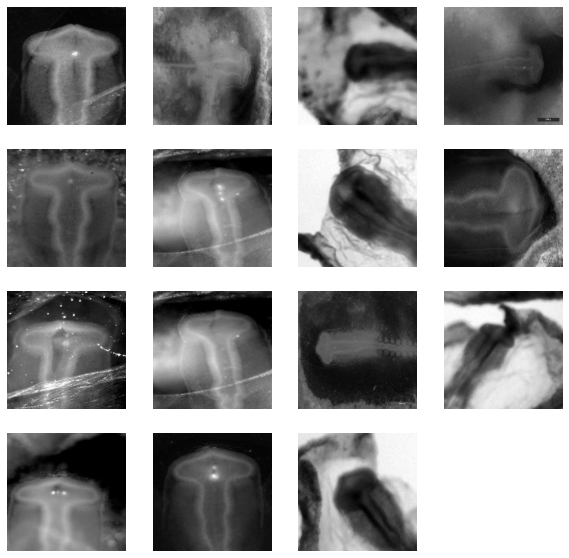

In [ ]:
visualise_all(split1)

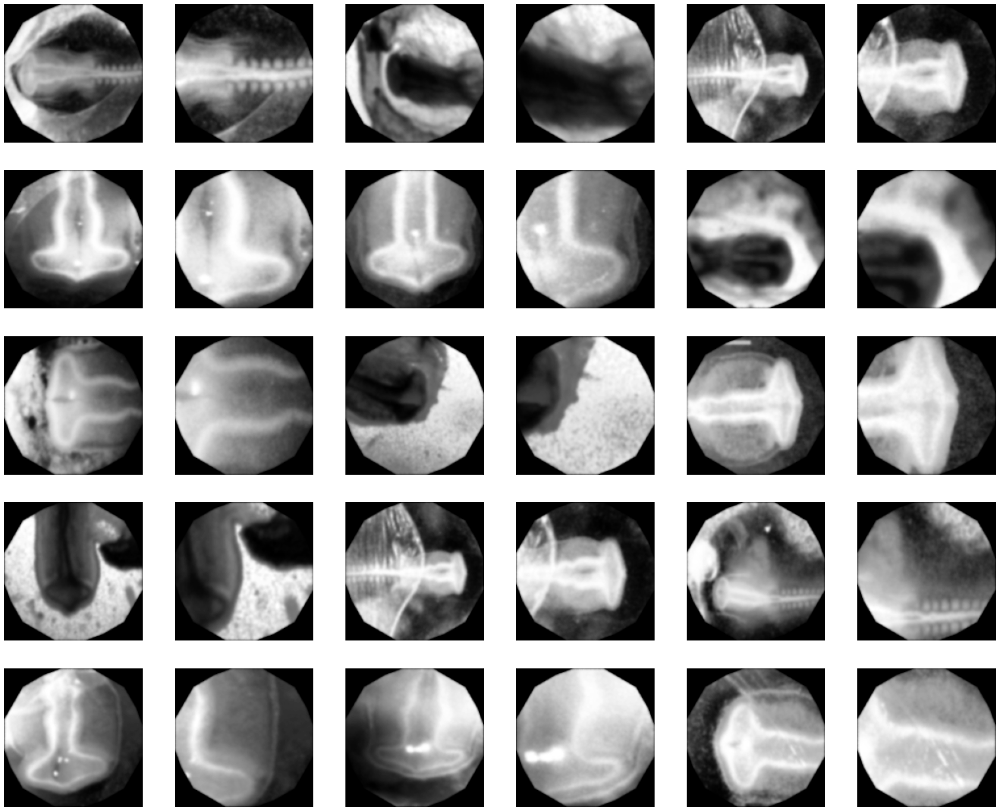

In [ ]:
translate = iaa.TranslateX(0.2)
translate2 = iaa.TranslateX(-0.2)
translate3 = iaa.TranslateY(0.2)
translate4 = iaa.TranslateY(-0.2)
crop = iaa.Crop(percent = 0.2)
split1aug = []
for feature, label in split8:
  feature = cv2.equalizeHist(feature)
  feature1 = translate(image = feature)
  feature1 = crop(image = feature1)
  for angle in np.arange(0, 360, 20):
    rotate = iaa.Rotate(angle)
    feature = rotate(image = feature)
    feature1 = rotate(image = feature1)
  split1aug.append([feature, label])
  split1aug.append([feature1, label])

visualise_all(split1aug, 30, 30)


In [ ]:
translate = iaa.TranslateX(0.2)

split1aug = []
for feature, label in split1:
  feature = cv2.equalizeHist(feature)
  feature1 = translate(image = feature)
  feature1 = crop(image = feature1)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.Rotate(angle)
    feature = rotate(image = feature)
    feature1 = rotate(image = feature1)
    split1aug.append([feature, label])
    split1aug.append([feature1, label])
  
split2aug = []
for feature, label in split2:
  feature = cv2.equalizeHist(feature)
  feature1 = translate(image = feature)
  feature1 = crop(image = feature1)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.Rotate(angle)
    feature = rotate(image = feature)
    feature1 = rotate(image = feature1)
    split2aug.append([feature, label])
    split2aug.append([feature1, label])

split3aug = []
for feature, label in split3:
  feature = cv2.equalizeHist(feature)
  feature1 = translate(image = feature)
  feature1 = crop(image = feature1)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.Rotate(angle)
    feature = rotate(image = feature)
    feature1 = rotate(image = feature1)
    split3aug.append([feature, label])
    split3aug.append([feature1, label])

split4aug = []
for feature, label in split4:
  feature = cv2.equalizeHist(feature)
  feature1 = translate(image = feature)
  feature1 = crop(image = feature1)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.Rotate(angle)
    feature = rotate(image = feature)
    feature1 = rotate(image = feature1)
    split4aug.append([feature, label])
    split4aug.append([feature1, label])

split5aug = []
for feature, label in split5:
  feature = cv2.equalizeHist(feature)
  feature1 = translate(image = feature)
  feature1 = crop(image = feature1)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.Rotate(angle)
    feature = rotate(image = feature)
    feature1 = rotate(image = feature1)
    split5aug.append([feature, label])
    split5aug.append([feature1, label])

split6aug = []
for feature, label in split6:
  feature = cv2.equalizeHist(feature)
  feature1 = translate(image = feature)
  feature1 = crop(image = feature1)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.Rotate(angle)
    feature = rotate(image = feature)
    feature1 = rotate(image = feature1)
    split6aug.append([feature, label])
    split6aug.append([feature1, label])

split7aug = []
for feature, label in split7:
  feature = cv2.equalizeHist(feature)
  feature1 = translate(image = feature)
  feature1 = crop(image = feature1)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.Rotate(angle)
    feature = rotate(image = feature)
    feature1 = rotate(image = feature1)
    split7aug.append([feature, label])
    split7aug.append([feature1, label])

split8aug = []
for feature, label in split8:
  feature = cv2.equalizeHist(feature)
  feature1 = translate(image = feature)
  feature1 = crop(image = feature1)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.Rotate(angle)
    feature = rotate(image = feature)
    feature1 = rotate(image = feature1)
    split8aug.append([feature, label])
    split8aug.append([feature1, label])

split9aug = []
for feature, label in split9:
  feature = cv2.equalizeHist(feature)
  feature1 = translate(image = feature)
  feature1 = crop(image = feature1)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.Rotate(angle)
    feature = rotate(image = feature)
    feature1 = rotate(image = feature1)
    split9aug.append([feature, label])
    split9aug.append([feature1, label])

split10aug = []
for feature, label in split10:
  feature = cv2.equalizeHist(feature)
  feature1 = translate(image = feature)
  feature1 = crop(image = feature1)
  for angle in np.arange(0, 360, 10):
    rotate = iaa.Rotate(angle)
    feature = rotate(image = feature)
    feature1 = rotate(image = feature1)
    split10aug.append([feature, label])
    split10aug.append([feature1, label])

train1 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val1 = split1aug
train2 = np.concatenate([split1aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val2 = split2aug
train3 = np.concatenate([split2aug, split1aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val3 = split3aug
train4 = np.concatenate([split2aug, split3aug, split1aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val4 = split4aug
train5 = np.concatenate([split2aug, split3aug, split4aug, split1aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val5 = split5aug
train6 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split1aug, split7aug, split8aug, split9aug, split10aug])
val6 = split6aug
train7 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split1aug, split8aug, split9aug, split10aug])
val7 = split7aug
train8 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split1aug, split9aug, split10aug])
val8 = split8aug
train9 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split1aug, split10aug])
val9 = split9aug
train10 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split1aug])
val10 = split10aug

<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


In [ ]:
%%time
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1
X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/50
306/306 [==============================] - 10s 30ms/step - loss: 1.1730 - accuracy: 0.4073 - val_loss: 1.1687 - val_accuracy: 0.4537
Epoch 2/50
306/306 [==============================] - 9s 29ms/step - loss: 1.0110 - accuracy: 0.5611 - val_loss: 1.1879 - val_accuracy: 0.3500
Epoch 3/50
306/306 [==============================] - 9s 29ms/step - loss: 0.7922 - accuracy: 0.6930 - val_loss: 1.1966 - val_accuracy: 0.4111
Epoch 4/50
306/306 [==============================] - 9s 29ms/step - loss: 0.5711 - accuracy: 0.8154 - val_loss: 1.1703 - val_accuracy: 0.4556
Epoch 5/50
306/306 [==============================] - 9s 29ms/step - loss: 0.3957 - accuracy: 0.8877 - val_loss: 1.1861 - val_accuracy: 0.4991
Epoch 6/50
306/306 [==============================] - 9s 29ms/step - loss: 0.2894 - accuracy: 0.9343 - val_loss: 1.1947 - val_accuracy: 0.5019
Epoch 7/

KeyboardInterrupt: ignored

The below now looks much more like the other embryos, however it has lost some image quality with the zoom.

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

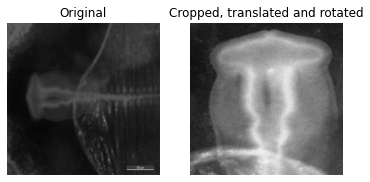

In [ ]:
image = cv2.imread('labeled_data/10_2/10.2_032.jpg', cv2.IMREAD_GRAYSCALE)
crop = iaa.Crop(percent = 0.3)
translate = iaa.TranslateY(0.2)
rotate = iaa.geometric.Affine(rotate = 90)
aug = crop(image = translate(image = rotate(image = image)))
visualize(image, aug, 'Original', 'Cropped, translated and rotated')
plt.savefig('crop_translate_example.png')
files.download('crop_translate_example.png')

One problem we are likely to face with this is that we need different crop and translations. Such as below, the same augmentation causes the image below.

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

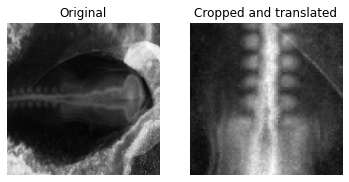

In [ ]:
image = cv2.resize(cv2.imread('labeled_data/10_2/10.2_004.jpg', cv2.IMREAD_GRAYSCALE), (200, 200))
crop = iaa.Crop(percent = 0.3)
translate = iaa.TranslateY(0.2)
rotate = iaa.geometric.Affine(rotate = 90)
aug = crop(image = translate(image = rotate(image = image)))
visualize(image, aug, 'Original', 'Cropped and translated')
plt.savefig('crop_translate_example_bad.png')
files.download('crop_translate_example_bad.png')

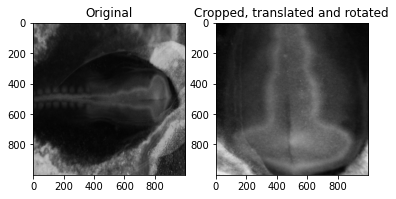

In [ ]:
image = cv2.imread('labeled_data/10_2/10.2_004.jpg', cv2.IMREAD_GRAYSCALE)
crop = iaa.Crop(percent = 0.3)
translate = iaa.TranslateY(-0.2)
rotate = iaa.geometric.Affine(rotate = 90)
aug = crop(image = translate(image = rotate(image = image)))
visualize(image, aug, 'Original', 'Cropped, translated and rotated')

And again, this is going to cause the images that already look normal to create images that aren't useful.

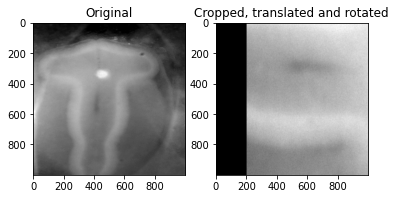

In [ ]:
image = image = cv2.imread('labeled_data/10_2/10.2_035.jpg', cv2.IMREAD_GRAYSCALE)
crop = iaa.Crop(percent = 0.3)
translate = iaa.TranslateX(0.2)
rotate = iaa.geometric.Affine(rotate = 90)
aug = crop(image = translate(image = rotate(image = image)))
visualize(image, aug, 'Original', 'Cropped, translated and rotated')

In [ ]:
valaccs = []
vallosses = []
accs = []
acclosses = []
testaccs = []
testlosses = []
for i in range(10):

  random.shuffle(tdata)
  training_data = tdata[0:int(round(len(tdata)*0.8, 0))]
  val_data = tdata[int(round(len(tdata)*0.8, 0)):int(round(len(tdata), 0))]
  # test_data = tdata[int(round(len(tdata)*0.95, 0)):int(round(len(tdata), 0))]

  train = []
  for feature, label in training_data:
    for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      crop = iaa.Crop(percent = 0.3)
      translate1 = iaa.TranslateY(0.2)
      translate2 = iaa.TranslateY(-0.2)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature1 = rotate(image = feature)
      feature2 = crop(image = translate1(image = rotate(image = feature)))
      feature3 = crop(image = translate2(image = rotate(image = feature)))
      train.append([feature1, label])
      train.append([feature2, label])
      train.append([feature3, label])

  val = []
  for feature, label in val_data:
    for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      crop = iaa.Crop(percent = 0.3)
      translate1 = iaa.TranslateY(0.2)
      translate2 = iaa.TranslateY(-0.2)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature1 = rotate(image = feature)
      feature2 = crop(image = translate1(image = rotate(image = feature)))
      feature3 = crop(image = translate2(image = rotate(image = feature)))
      val.append([feature1, label])
      val.append([feature2, label])
      val.append([feature3, label])

  random.shuffle(train)
  random.shuffle(val)
  # random.shuffle(test_data)

  # Preprocessing the data into X_train etc with relevant input shapes
  X_train = []
  y_train = []
  X_val = []
  y_val = []
  X_test = []
  y_test = []
  img_size = 200

  for feature, label in train:
    X_train.append(feature)
    y_train.append(label)

  for feature, label in val:
    X_val.append(feature)
    y_val.append(label)

  # for feature, label in test_data:
  #   X_test.append(feature)
  #   y_test.append(label)

  X_train = np.array(X_train) / 255
  X_val = np.array(X_val) / 255
  # X_test = np.array(X_test) / 255

  X_train = X_train.reshape(X_train.shape[0], 200, 200, 1)
  X_val = X_val.reshape(X_val.shape[0], 200, 200, 1)
  # X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

  X_train.astype('float32')
  X_val.astype('float32')
  # X_test.astype('float32')

  y_train=to_categorical(y_train)
  y_val=to_categorical(y_val)
  # y_test = to_categorical(y_test)

  print('X_train shape:', np.shape(X_train))
  print('X_val shape:', np.shape(X_val))
  # print('X_test shape:', np.shape(X_test))
  print('y_train shape:', np.shape(y_train))
  print('y_val shape:', np.shape(y_val))
  # print('y_test shape:', np.shape(y_test))

  from tensorflow.keras import layers
  from tensorflow.keras import regularizers
  layer_drop = 0.2
  final_drop = 0.5
  activation = 'relu'
  lamda = 0.0001
  model = Sequential([
    layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 1), kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Flatten(),
    layers.Dense(1024, activation=activation),
    layers.Dropout(final_drop),
    layers.Dense(3, activation = 'softmax')
  ])
  #opt = Adam(learning_rate = learning_rate)
  model.compile(optimizer = Adam(learning_rate = 0.0001),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

  earlyStop = EarlyStopping(monitor = 'val_loss', min_delta = 0.01, patience = 5)
  epochs = 50
  history = model.fit(x=X_train,
                      y=y_train,
                      epochs=epochs,
                      batch_size=32,
                      validation_data=(X_val, y_val),
                      callbacks=[earlyStop])

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']
  accuracy = history.history['val_accuracy'][-1]
  # testvals = model.evaluate(X_test, y_test)

  valaccs.append(round(max(val_acc)*100, 1))
  vallosses.append(round(min(val_loss)*100, 1))
  accs.append(round(max(acc)*100, 1))
  acclosses.append(round(min(loss)*100, 1))
  # testaccs.append(round(testvals[1]*100, 1))
  # testlosses.append(round(testvals[0]*100, 1))

  del model
  K.clear_session()

print('Accuracies:', accs)
print('Average accuracy:', round(np.mean(accs),1))
print('Average loss:', round(np.mean(acclosses),1))
print('Accuracy standard deviation:', np.std(accs))
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Average validation loss:', round(np.mean(vallosses),1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
# print('Test accuracies:', testaccs)
# print('Average test accuracy:', round(np.mean(testaccs), 1))
# print('Average test loss:', round(np.mean(testlosses),1))
# print('Test standard deviation:', round(np.std(testaccs), 1))

X_train shape: (13068, 200, 200, 1)
X_val shape: (3240, 200, 200, 1)
y_train shape: (13068, 3)
y_val shape: (3240, 3)
Epoch 1/50
409/409 [==============================] - 14s 32ms/step - loss: 1.1943 - accuracy: 0.3618 - val_loss: 1.1761 - val_accuracy: 0.3583
Epoch 2/50
409/409 [==============================] - 12s 30ms/step - loss: 1.1552 - accuracy: 0.3680 - val_loss: 1.1501 - val_accuracy: 0.3494
Epoch 3/50
409/409 [==============================] - 12s 30ms/step - loss: 1.1120 - accuracy: 0.4098 - val_loss: 1.1182 - val_accuracy: 0.3864
Epoch 4/50
409/409 [==============================] - 12s 30ms/step - loss: 1.0430 - accuracy: 0.4761 - val_loss: 1.1078 - val_accuracy: 0.3972
Epoch 5/50
409/409 [==============================] - 12s 30ms/step - loss: 0.9718 - accuracy: 0.5274 - val_loss: 1.0872 - val_accuracy: 0.4059
Epoch 6/50
409/409 [==============================] - 12s 30ms/step - loss: 0.8851 - accuracy: 0.5813 - val_loss: 1.1443 - val_accuracy: 0.3972
Epoch 7/50
409/409

## Applying as preprocessing to only some images

In [ ]:
leftcroplist = [
            '10_1/10.1_000.jpg',
            '10_1/10.1_001.jpg',
            '10_1/10.1_007.jpg',
            '10_1/10.1_010.jpg',
            '10_1/10.1_015.jpg',
            '10_1/10.1_017.jpg',
            '10_1/10.1_021.jpg',
            '10_1/10.1_027.jpg',
            '10_1/10.1_030.jpg',
            '10_1/10.1_038.jpg',
            '10_2/10.2_010.jpg',
            '10_2/10.2_015.jpg',
            '10_2/10.2_032.jpg',
            
            '10_3/10.3_018.jpg',
            '10_3/10.3_026.jpg',
            '10_3/10.3_033.jpg',
]

listnum = [0, 1, 7, 10, 15, 17, 21, 27, 30, 38, 63, 68, 85, 127, 135, 142]

rightcroplist = [
                 '10_1/10.1_012.jpg',
                 '10_1/10.1_014.jpg',
                 '10_1/10.1_018.jpg',
                 '10_2/10.2_016.jpg',
                 '10_2/10.2_017.jpg',
                 '10_2/10.2_018.jpg',
                 '10_2/10.2_030.jpg',
                 '10_3/10.3_000.jpg',
                 '10_3/10.3_008.jpg',
                 '10_3/10.3_016.jpg',
                 '10_3/10.3_031.jpg',
                 

]

uprightcroplist = [
                   '10_1/10.1_039.jpg',
                   '10_2/10.2_052.jpg',
                   '10_3/10.3_002.jpg',
                   '10_3/10.3_006.jpg',
                   '10_3/10.3_009.jpg',
                   '10_3/10.3_017.jpg',
                   '10_3/10.3_023.jpg',
                   '10_3/10.3_025.jpg',
                   '10_3/10.3_036.jpg',
                   '10_3/10.3_038.jpg',
]


In [ ]:
leftcroplist[0].split('/')[0]

True

In [ ]:
leftcropimgs = []
for img in leftcroplist:
  image = cv2.imread('labeled_data/' + img, cv2.IMREAD_GRAYSCALE)
  if img.split('/')[0] == '10_1':
    label = 0
  if img.split('/')[0] == '10_2':
    label = 1
  if img.split('/')[0] == '10_3':
    label = 2
  leftcropimgs.append([image, label])


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

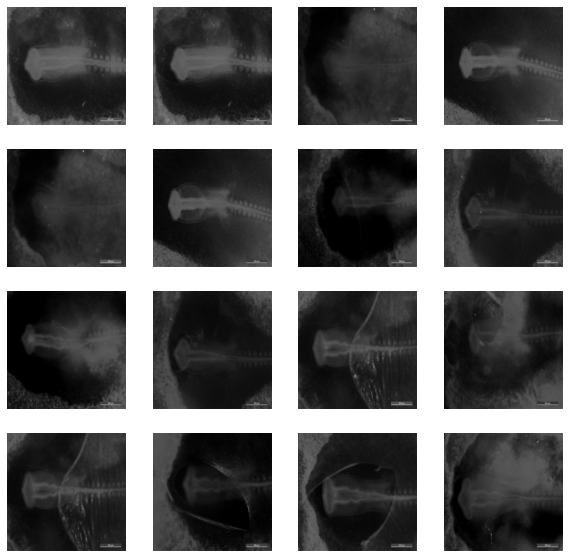

In [ ]:
from google.colab import files
fig = plt.figure(figsize=(10, 10))
for i in range(len(leftcropimgs)):
  plt.subplot((int(math.ceil(np.sqrt(len(leftcropimgs))))), 
              (int(math.ceil(np.sqrt(len(leftcropimgs))))), 
              i+1)
  plt.imshow(leftcropimgs[i][0], cmap = 'gray')
  plt.axis('off')
plt.savefig('10_1_less_mag.png')
files.download('10_1_less_mag.png')

In [ ]:
augleftcropimgs = []
for feature, label in leftcropimgs:
  crop = iaa.Crop(percent = 0.2)
  translate = iaa.TranslateX(0.2)
  # rotate = iaa.geometric.Affine(rotate = 90)
  aug = crop(image = translate(image = feature))
  aug = cv2.resize(aug, (200, 200))
  augleftcropimgs.append([aug, label])

In [ ]:
augleftcropimgs = []
for feature, label in leftcropimgs:
  crop = iaa.Crop(percent = 0.2)
  translate = iaa.TranslateY(0.2)
  rotate = iaa.geometric.Affine(rotate = 90)
  aug = crop(image = translate(image = rotate(image = feature)))
  aug = cv2.resize(aug, (200, 200))
  augleftcropimgs.append([aug, label])

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

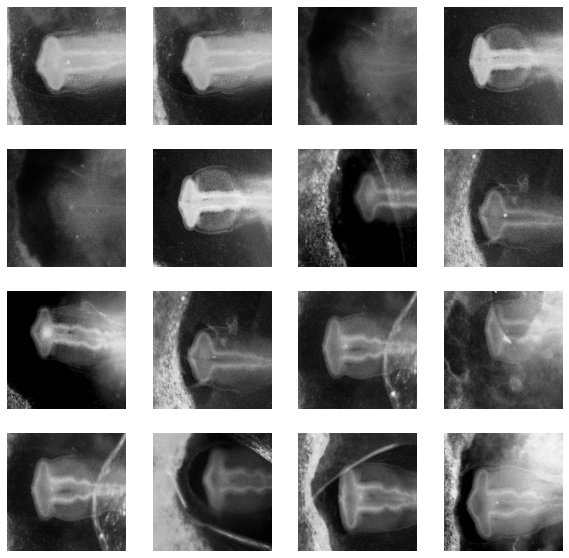

In [ ]:
fig = plt.figure(figsize=(10, 10))
for i in range(len(augleftcropimgs)):
  plt.subplot((int(math.ceil(np.sqrt(len(augleftcropimgs))))), 
              (int(math.ceil(np.sqrt(len(augleftcropimgs))))), 
              i+1)
  plt.imshow(augleftcropimgs[i][0], cmap = 'gray')
  plt.axis('off')
plt.savefig('10_1_more_mag.png')
files.download('10_1_more_mag.png')

In [ ]:
rightcropimgs = []
for img in rightcroplist:
  image = cv2.imread('labeled_data/' + img, cv2.IMREAD_GRAYSCALE)
  if img.split('/')[0] == '10_1':
    label = 0
  if img.split('/')[0] == '10_2':
    label = 1
  if img.split('/')[0] == '10_3':
    label = 2
  rightcropimgs.append([image, label])

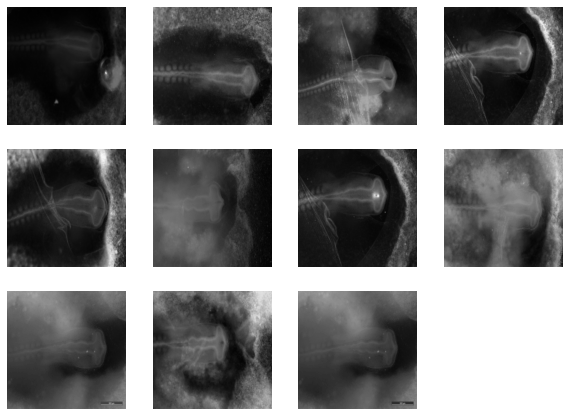

In [ ]:
fig = plt.figure(figsize=(10, 10))
for i in range(len(rightcropimgs)):
  plt.subplot((int(math.ceil(np.sqrt(len(rightcropimgs))))), 
              (int(math.ceil(np.sqrt(len(rightcropimgs))))), 
              i+1)
  plt.imshow(rightcropimgs[i][0], cmap = 'gray')
  plt.axis('off')

In [ ]:
augrightcropimgs = []
for feature, label in rightcropimgs:
  crop = iaa.Crop(percent = 0.2)
  translate = iaa.TranslateX(-0.1)
  # rotate = iaa.geometric.Affine(rotate = 270)
  aug = crop(image = translate(image = feature))
  aug = cv2.resize(aug, (200, 200))
  augrightcropimgs.append([aug, label])

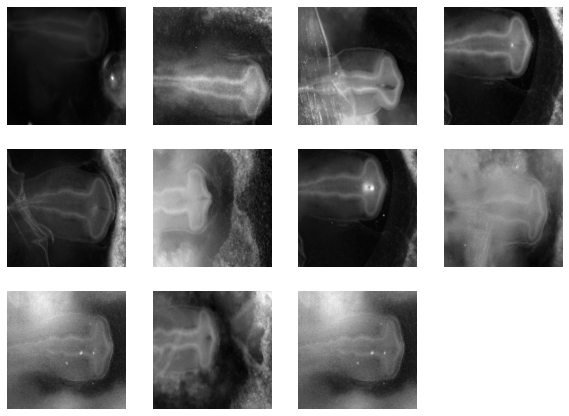

In [ ]:
fig = plt.figure(figsize=(10, 10))
for i in range(len(augrightcropimgs)):
  plt.subplot((int(math.ceil(np.sqrt(len(augrightcropimgs))))), 
              (int(math.ceil(np.sqrt(len(augrightcropimgs))))), 
              i+1)
  plt.imshow(augrightcropimgs[i][0], cmap = 'gray')
  plt.axis('off')

In [ ]:
uprightcropimgs = []
for img in uprightcroplist:
  image = cv2.imread('labeled_data/' + img, cv2.IMREAD_GRAYSCALE)
  if img.split('/')[0] == '10_1':
    label = 0
  if img.split('/')[0] == '10_2':
    label = 1
  if img.split('/')[0] == '10_3':
    label = 2
  uprightcropimgs.append([image, label])

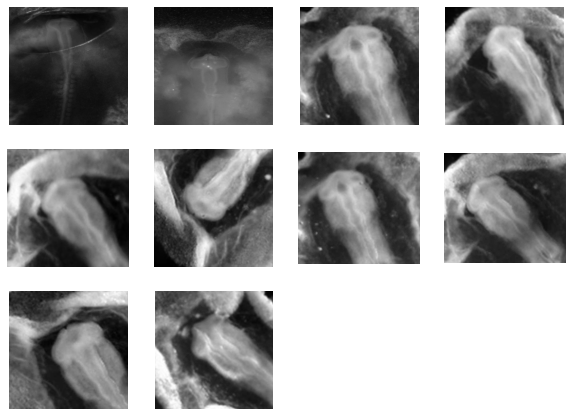

In [ ]:
fig = plt.figure(figsize=(10, 10))
for i in range(len(uprightcropimgs)):
  plt.subplot((int(math.ceil(np.sqrt(len(uprightcropimgs))))), 
              (int(math.ceil(np.sqrt(len(uprightcropimgs))))), 
              i+1)
  plt.imshow(uprightcropimgs[i][0], cmap = 'gray')
  plt.axis('off')

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

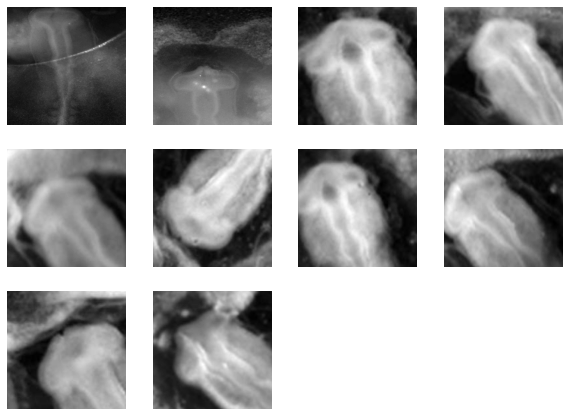

In [ ]:
auguprightcropimgs = []
for feature, label in uprightcropimgs:
  crop = iaa.Crop(percent = 0.2)
  translate = iaa.TranslateY(0.1)
  # rotate = iaa.geometric.Affine(rotate = 270)
  aug = crop(image = translate(image = feature))
  aug = cv2.resize(aug, (200, 200))
  auguprightcropimgs.append([aug, label])

  fig = plt.figure(figsize=(10, 10))
for i in range(len(auguprightcropimgs)):
  plt.subplot((int(math.ceil(np.sqrt(len(auguprightcropimgs))))), 
              (int(math.ceil(np.sqrt(len(auguprightcropimgs))))), 
              i+1)
  plt.imshow(auguprightcropimgs[i][0], cmap = 'gray')
  plt.axis('off')

In [ ]:
imagesfull = []
for feature, label in augleftcropimgs:
  imagesfull.append([feature, label])
for feature, label in augrightcropimgs:
  imagesfull.append([feature, label])
for feature, label in auguprightcropimgs:
  imagesfull.append([feature, label])


In [ ]:
tenonelist = os.listdir('labeled_data/10_1')
left2 = []
for img in leftcroplist:
  fn, fext = img.split('/')
  left2.append(fext)
for img in rightcroplist:
  fn, fext = img.split('/')
  left2.append(fext)
for img in uprightcroplist:
  fn, fext = img.split('/')
  left2.append(fext)
l1 = [x for x in tenonelist if x not in left2]

In [ ]:
tentwolist = os.listdir('labeled_data/10_2')
right2 = []
for img in leftcroplist:
  fn, fext = img.split('/')
  right2.append(fext)
for img in rightcroplist:
  fn, fext = img.split('/')
  right2.append(fext)
for img in uprightcroplist:
  fn, fext = img.split('/')
  right2.append(fext)
l2 = [x for x in tentwolist if x not in right2]

In [ ]:
tenthreelist = os.listdir('labeled_data/10_3')
right3 = []
for img in leftcroplist:
  fn, fext = img.split('/')
  right3.append(fext)
for img in rightcroplist:
  fn, fext = img.split('/')
  right3.append(fext)
for img in uprightcroplist:
  fn, fext = img.split('/')
  right3.append(fext)
l3 = [x for x in tenthreelist if x not in right3]

In [ ]:


tdata = []

for img in l1:  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_1/{}'.format(img), cv2.IMREAD_GRAYSCALE) 
        tdata.append([cv2.resize(img_array, (200, 200)), 0])
    except Exception as e:  
        pass

for img in l2:  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_2/{}'.format(img), cv2.IMREAD_GRAYSCALE) 
        tdata.append([cv2.resize(img_array, (200, 200)), 1])
    except Exception as e:  
        pass

for img in l3:  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_3/{}'.format(img), cv2.IMREAD_GRAYSCALE) 
        tdata.append([cv2.resize(img_array, (200, 200)), 2])
    except Exception as e:  
        pass

for feature, label in imagesfull:
  tdata.append([feature, label])

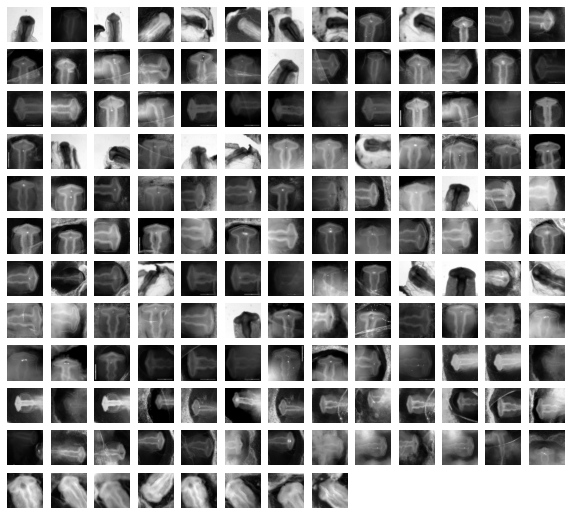

In [ ]:
fig = plt.figure(figsize=(10, 10))
for i in range(len(tdata)):
  plt.subplot((int(math.ceil(np.sqrt(len(tdata))))), 
              (int(math.ceil(np.sqrt(len(tdata))))), 
              i+1)
  plt.imshow(tdata[i][0], cmap = 'gray')
  plt.axis('off')

In [ ]:
valaccs = []
vallosses = []
accs = []
acclosses = []
testaccs = []
testlosses = []
for i in range(10):

  random.shuffle(tdata)
  training_data = tdata[0:int(round(len(tdata)*0.8, 0))]
  val_data = tdata[int(round(len(tdata)*0.8, 0)):int(round(len(tdata), 0))]
  # test_data = tdata[int(round(len(tdata)*0.95, 0)):int(round(len(tdata), 0))]

  train = []
  for feature, label in training_data:
    for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      train.append([feature, label])

  val = []
  for feature, label in val_data:
    for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      val.append([feature, label])

  random.shuffle(train)
  random.shuffle(val)
  # random.shuffle(test_data)

  # Preprocessing the data into X_train etc with relevant input shapes
  X_train = []
  y_train = []
  X_val = []
  y_val = []
  X_test = []
  y_test = []
  img_size = 200

  for feature, label in train:
    X_train.append(feature)
    y_train.append(label)

  for feature, label in val:
    X_val.append(feature)
    y_val.append(label)

  # for feature, label in test_data:
  #   X_test.append(feature)
  #   y_test.append(label)

  X_train = np.array(X_train) / 255
  X_val = np.array(X_val) / 255
  # X_test = np.array(X_test) / 255

  X_train = X_train.reshape(X_train.shape[0], 200, 200, 1)
  X_val = X_val.reshape(X_val.shape[0], 200, 200, 1)
  # X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

  X_train.astype('float32')
  X_val.astype('float32')
  # X_test.astype('float32')

  y_train=to_categorical(y_train)
  y_val=to_categorical(y_val)
  # y_test = to_categorical(y_test)

  print('X_train shape:', np.shape(X_train))
  print('X_val shape:', np.shape(X_val))
  # print('X_test shape:', np.shape(X_test))
  print('y_train shape:', np.shape(y_train))
  print('y_val shape:', np.shape(y_val))
  # print('y_test shape:', np.shape(y_test))

  from tensorflow.keras import layers
  from tensorflow.keras import regularizers
  layer_drop = 0.2
  final_drop = 0.5
  activation = 'relu'
  lamda = 0.0001
  model = Sequential([
    layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 1), kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Flatten(),
    layers.Dense(1024, activation=activation),
    layers.Dropout(final_drop),
    layers.Dense(3, activation = 'softmax')
  ])
  #opt = Adam(learning_rate = learning_rate)
  model.compile(optimizer = Adam(learning_rate = 0.0001),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

  earlyStop = EarlyStopping(monitor = 'val_loss', min_delta = 0.01, patience = 5)
  epochs = 50
  history = model.fit(x=X_train,
                      y=y_train,
                      epochs=epochs,
                      batch_size=32,
                      validation_data=(X_val, y_val),
                      callbacks=[earlyStop])

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']
  accuracy = history.history['val_accuracy'][-1]
  # testvals = model.evaluate(X_test, y_test)

  valaccs.append(round(max(val_acc)*100, 1))
  vallosses.append(round(min(val_loss)*100, 1))
  accs.append(round(max(acc)*100, 1))
  acclosses.append(round(min(loss)*100, 1))
  # testaccs.append(round(testvals[1]*100, 1))
  # testlosses.append(round(testvals[0]*100, 1))

  del model
  K.clear_session()

print('Accuracies:', accs)
print('Average accuracy:', round(np.mean(accs),1))
print('Average loss:', round(np.mean(acclosses),1))
print('Accuracy standard deviation:', np.std(accs))
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Average validation loss:', round(np.mean(vallosses),1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
# print('Test accuracies:', testaccs)
# print('Average test accuracy:', round(np.mean(testaccs), 1))
# print('Average test loss:', round(np.mean(testlosses),1))
# print('Test standard deviation:', round(np.std(testaccs), 1))

X_train shape: (4356, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (4356, 3)
y_val shape: (1080, 3)
Epoch 1/50
137/137 [==============================] - 5s 32ms/step - loss: 1.2140 - accuracy: 0.3756 - val_loss: 1.2048 - val_accuracy: 0.2667
Epoch 2/50
137/137 [==============================] - 4s 29ms/step - loss: 1.1753 - accuracy: 0.4054 - val_loss: 1.1804 - val_accuracy: 0.3167
Epoch 3/50
137/137 [==============================] - 4s 29ms/step - loss: 1.0497 - accuracy: 0.5275 - val_loss: 1.1389 - val_accuracy: 0.5250
Epoch 4/50
137/137 [==============================] - 4s 30ms/step - loss: 0.8306 - accuracy: 0.6671 - val_loss: 1.0994 - val_accuracy: 0.4926
Epoch 5/50
137/137 [==============================] - 4s 29ms/step - loss: 0.6382 - accuracy: 0.7725 - val_loss: 0.9695 - val_accuracy: 0.6463
Epoch 6/50
137/137 [==============================] - 4s 30ms/step - loss: 0.4641 - accuracy: 0.8648 - val_loss: 0.9212 - val_accuracy: 0.6926
Epoch 7/50
137/137 [======

# Blur background

Segmentation maps

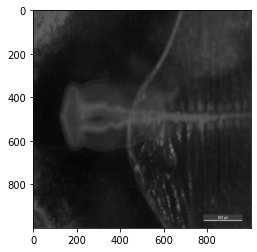

In [ ]:
gray = cv2.imread('labeled_data/10_2/10.2_032.jpg', cv2.IMREAD_GRAYSCALE)
plt.imshow(gray, cmap = 'gray')

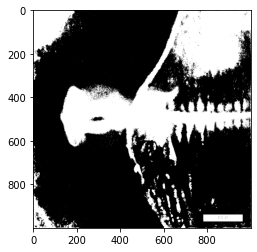

In [ ]:
mask = cv2.threshold(gray, 50, 255, cv2.THRESH_BINARY)[1]
plt.imshow(mask, cmap = 'gray')

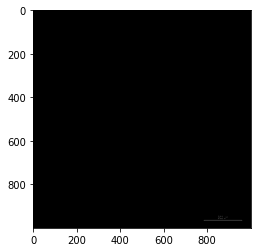

In [ ]:
mask = cv2.threshold(gray, 250, 255, cv2.THRESH_BINARY)[1]
plt.imshow(mask, cmap = 'gray')

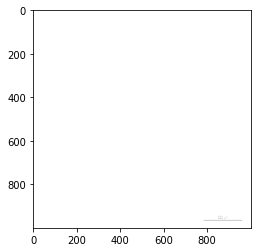

In [ ]:
mask = 255 - mask
plt.imshow(mask, cmap = 'gray')

In [ ]:
gray = cv2.imread('labeled_data/10_2/10.2_032.jpg')

# convert to graky
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# threshold input image as mask
mask = cv2.threshold(gray, 250, 255, cv2.THRESH_BINARY)[1]

# negate mask
mask = 255 - mask

# apply morphology to remove isolated extraneous noise
# use borderconstant of black since foreground touches the edges
kernel = np.ones((3,3), np.uint8)
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

# anti-alias the mask -- blur then stretch
# blur alpha channel
mask = cv2.GaussianBlur(mask, (0,0), sigmaX=2, sigmaY=2, borderType = cv2.BORDER_DEFAULT)

# linear stretch so that 127.5 goes to 0, but 255 stays 255
mask = (2*(mask.astype(np.float32))-255.0).clip(0,255).astype(np.uint8)

# put mask into alpha channel
result = img.copy()
result = cv2.cvtColor(result, cv2.COLOR_BGR2BGRA)
result[:, :, 3] = mask

# save resulting masked image
cv2.imwrite('person_transp_bckgrnd.png', result)

# display result, though it won't show transparency
cv2.imshow("INPUT", img)
cv2.imshow("GRAY", gray)
cv2.imshow("MASK", mask)
cv2.imshow("RESULT", result)
cv2.waitKey(0)
cv2.destroyAllWindows()

error: ignored

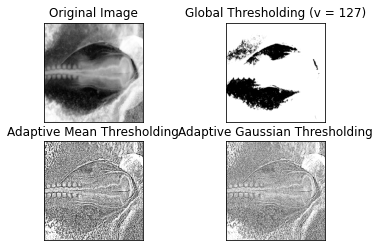

In [ ]:
img = cv2.imread('labeled_data/10_2/10.2_004.jpg', 0)
img = cv2.equalizeHist(img)

ret,th1 = cv2.threshold(img,50,255,cv2.THRESH_BINARY)
th2 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C,\
            cv2.THRESH_BINARY,11,2)
th3 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv2.THRESH_BINARY,11,2)
titles = ['Original Image', 'Global Thresholding (v = 127)',
            'Adaptive Mean Thresholding', 'Adaptive Gaussian Thresholding']
images = [img, th1, th2, th3]
for i in range(4):
    plt.subplot(2,2,i+1),plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
plt.show()

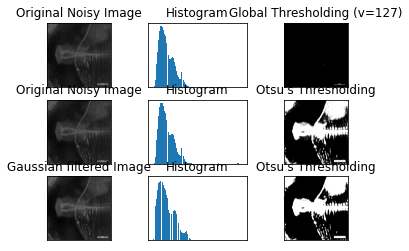

In [ ]:
img = cv2.imread('labeled_data/10_2/10.2_010.jpg', 0)
# global thresholding
cv = cv2
ret1,th1 = cv.threshold(img,127,255,cv.THRESH_BINARY)
# Otsu's thresholding
ret2,th2 = cv.threshold(img,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU)
# Otsu's thresholding after Gaussian filtering
blur = cv.GaussianBlur(img,(5,5),0)
ret3,th3 = cv.threshold(blur,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU)
# plot all the images and their histograms
images = [img, 0, th1,
          img, 0, th2,
          blur, 0, th3]
titles = ['Original Noisy Image','Histogram','Global Thresholding (v=127)',
          'Original Noisy Image','Histogram',"Otsu's Thresholding",
          'Gaussian filtered Image','Histogram',"Otsu's Thresholding"]
for i in range(3):
    plt.subplot(3,3,i*3+1),plt.imshow(images[i*3],'gray')
    plt.title(titles[i*3]), plt.xticks([]), plt.yticks([])
    plt.subplot(3,3,i*3+2),plt.hist(images[i*3].ravel(),256)
    plt.title(titles[i*3+1]), plt.xticks([]), plt.yticks([])
    plt.subplot(3,3,i*3+3),plt.imshow(images[i*3+2],'gray')
    plt.title(titles[i*3+2]), plt.xticks([]), plt.yticks([])
plt.show()

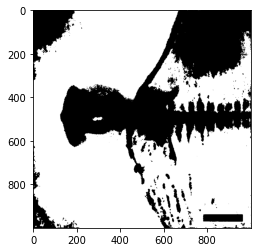

In [ ]:
inv = iaa.Invert(1)
plt.imshow(inv(image = th3), cmap = 'gray')

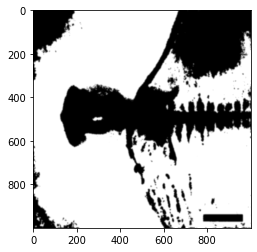

In [ ]:
img = inv(image = th3)
mask = cv2.GaussianBlur(img, (0,0), sigmaX=2, sigmaY=2, borderType = cv2.BORDER_DEFAULT)
plt.imshow(mask, cmap = 'gray')

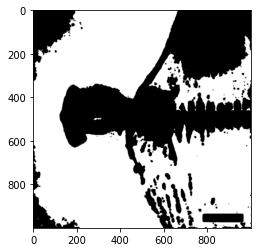

In [ ]:
mask = (2*(mask.astype(np.float32))-255.0).clip(0,255).astype(np.uint8)
plt.imshow(mask, cmap = 'gray')

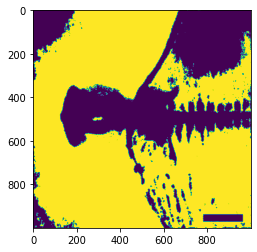

In [ ]:
plt.imshow(img)

In [ ]:
img = cv2.imread('labeled_data/10_2/10.2_010.jpg', 0)

result = img.copy()
result = cv2.cvtColor(result, cv2.COLOR_BGR2BGRA)
result[:, :, 3] = mask

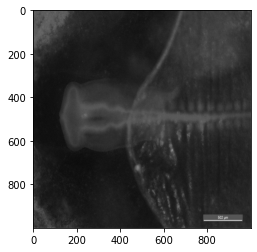

In [ ]:
plt.imshow(cv2.cvtColor(img.copy(), cv2.COLOR_BGR2BGRA), 'gray')

In [ ]:
import cv2
import numpy as np
import skimage.exposure

# load image
img = cv2.imread('labeled_data/10_2/10.2_041.jpg', cv2.IMREAD_GRAYSCALE)
img = cv2.equalizeHist(img)

# convert to gray
# gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# threshold
def threshold(img):
  thresh = cv2.threshold(img, 140, 255, cv2.THRESH_BINARY)[1]

  # apply morphology to clean small spots
  kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
  morph = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, borderType=cv2.BORDER_CONSTANT, borderValue=0)
  kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
  morph = cv2.morphologyEx(morph, cv2.MORPH_CLOSE, kernel, borderType=cv2.BORDER_CONSTANT, borderValue=0)
  kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
  morph = cv2.morphologyEx(morph, cv2.MORPH_ERODE, kernel, borderType=cv2.BORDER_CONSTANT, borderValue=0)

  # get external contour
  contours = cv2.findContours(morph, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
  contours = contours[0] if len(contours) == 2 else contours[1]
  big_contour = max(contours, key=cv2.contourArea)

  # draw white filled contour on black background as mas
  contour = np.zeros_like(gray)
  cv2.drawContours(contour, [big_contour], 0, 255, -1)

  # blur dilate image
  blur = cv2.GaussianBlur(contour, (5,5), sigmaX=0, sigmaY=0, borderType = cv2.BORDER_DEFAULT)

  # stretch so that 255 -> 255 and 127.5 -> 0
  mask = skimage.exposure.rescale_intensity(blur, in_range=(127.5,255), out_range=(0,255))

  # put mask into alpha channel of input
  result = cv2.cvtColor(img, cv2.COLOR_BGR2BGRA)
  result[:,:,1] = mask
  return result

# save output



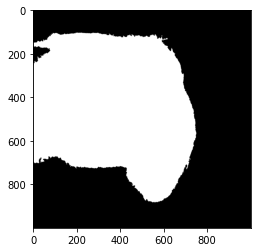

In [ ]:
plt.imshow(contour, 'gray')

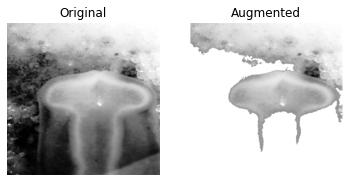

In [ ]:
visualize(img, threshold(img))

In [ ]:
valaccs = []
vallosses = []
accs = []
acclosses = []
testaccs = []
testlosses = []
for i in range(10):

  random.shuffle(tdata)
  training_data = tdata[0:int(round(len(tdata)*0.8, 0))]
  val_data = tdata[int(round(len(tdata)*0.8, 0)):int(round(len(tdata), 0))]
  # test_data = tdata[int(round(len(tdata)*0.95, 0)):int(round(len(tdata), 0))]

  train = []
  for feature, label in training_data:
    for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      feature = threshold(feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      train.append([feature, label])


  val = []
  for feature, label in val_data:
    for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      feature = threshold(feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      val.append([feature, label])

  random.shuffle(train)
  random.shuffle(val)
  # random.shuffle(test_data)

  # Preprocessing the data into X_train etc with relevant input shapes
  X_train = []
  y_train = []
  X_val = []
  y_val = []
  X_test = []
  y_test = []
  img_size = 200

  for feature, label in train:
    X_train.append(feature)
    y_train.append(label)

  for feature, label in val:
    X_val.append(feature)
    y_val.append(label)

  # for feature, label in test_data:
  #   X_test.append(feature)
  #   y_test.append(label)

  X_train = np.array(X_train) / 255
  X_val = np.array(X_val) / 255
  # X_test = np.array(X_test) / 255

  X_train = X_train.reshape(X_train.shape[0], 200, 200, 1)
  X_val = X_val.reshape(X_val.shape[0], 200, 200, 1)
  # X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

  X_train.astype('float32')
  X_val.astype('float32')
  # X_test.astype('float32')

  y_train=to_categorical(y_train)
  y_val=to_categorical(y_val)
  # y_test = to_categorical(y_test)

  print('X_train shape:', np.shape(X_train))
  print('X_val shape:', np.shape(X_val))
  # print('X_test shape:', np.shape(X_test))
  print('y_train shape:', np.shape(y_train))
  print('y_val shape:', np.shape(y_val))
  # print('y_test shape:', np.shape(y_test))

  from tensorflow.keras import layers
  from tensorflow.keras import regularizers
  layer_drop = 0.2
  final_drop = 0.5
  activation = 'relu'
  lamda = 0.0001
  model = Sequential([
    layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 1), kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Flatten(),
    layers.Dense(1024, activation=activation),
    layers.Dropout(final_drop),
    layers.Dense(3, activation = 'softmax')
  ])
  #opt = Adam(learning_rate = learning_rate)
  model.compile(optimizer = Adam(learning_rate = 0.0001),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

  earlyStop = EarlyStopping(monitor = 'val_loss', min_delta = 0.01, patience = 5)
  epochs = 50
  history = model.fit(x=X_train,
                      y=y_train,
                      epochs=epochs,
                      batch_size=32,
                      validation_data=(X_val, y_val),
                      callbacks=[earlyStop])

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']
  accuracy = history.history['val_accuracy'][-1]
  # testvals = model.evaluate(X_test, y_test)

  valaccs.append(round(max(val_acc)*100, 1))
  vallosses.append(round(min(val_loss)*100, 1))
  accs.append(round(max(acc)*100, 1))
  acclosses.append(round(min(loss)*100, 1))
  # testaccs.append(round(testvals[1]*100, 1))
  # testlosses.append(round(testvals[0]*100, 1))

  del model
  K.clear_session()

print('Accuracies:', accs)
print('Average accuracy:', round(np.mean(accs),1))
print('Average loss:', round(np.mean(acclosses),1))
print('Accuracy standard deviation:', np.std(accs))
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Average validation loss:', round(np.mean(vallosses),1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
# print('Test accuracies:', testaccs)
# print('Average test accuracy:', round(np.mean(testaccs), 1))
# print('Average test loss:', round(np.mean(testlosses),1))
# print('Test standard deviation:', round(np.std(testaccs), 1))

ValueError: ignored

# Contrast

In [ ]:
tdata = []

for img in os.listdir('labeled_data/10_1'):  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_1/{}'.format(img)) 
        tdata.append([cv2.resize(img_array, (200, 200)), 0])
    except Exception as e:  
        pass

for img in os.listdir('labeled_data/10_2'):  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_2/{}'.format(img)) 
        tdata.append([cv2.resize(img_array, (200, 200)), 1])
    except Exception as e:  
        pass

for img in os.listdir('labeled_data/10_3'):  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_3/{}'.format(img)) 
        tdata.append([cv2.resize(img_array, (200, 200)), 2])
    except Exception as e:  
        pass

/usr/local/lib/python3.7/dist-packages/imgaug/imgaug.py:188: DeprecationWarning: Function `ContrastNormalization()` is deprecated. Use `imgaug.contrast.LinearContrast` instead.
  warn_deprecated(msg, stacklevel=3)


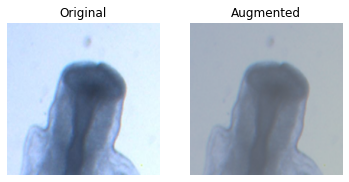

In [ ]:
contrast = iaa.ContrastNormalization(0.5)
visualize(tdata[0][0], contrast(image = tdata[0][0]))

In [ ]:
valaccs = []
vallosses = []
accs = []
acclosses = []
testaccs = []
testlosses = []
for i in range(10):

  random.shuffle(tdata)
  training_data = tdata[0:int(round(len(tdata)*0.8, 0))]
  val_data = tdata[int(round(len(tdata)*0.8, 0)):int(round(len(tdata), 0))]
  # test_data = tdata[int(round(len(tdata)*0.95, 0)):int(round(len(tdata), 0))]

  train = []
  for feature, label in training_data:
    for angle in np.arange(0, 360, 10):
      contrast = iaa.ContrastNormalization(0.5)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature1 = rotate(image = feature)
      feature2 = contrast(image = rotate(image = feature))
      train.append([feature1, label])
      train.append([feature2, label])

  val = []
  for feature, label in val_data:
    for angle in np.arange(0, 360, 10):
      contrast = iaa.ContrastNormalization(0.5)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature1 = rotate(image = feature)
      feature2 = contrast(image = rotate(image = feature))
      val.append([feature1, label])
      val.append([feature2, label])

  random.shuffle(train)
  random.shuffle(val)
  # random.shuffle(test_data)

  # Preprocessing the data into X_train etc with relevant input shapes
  X_train = []
  y_train = []
  X_val = []
  y_val = []
  X_test = []
  y_test = []
  img_size = 200

  for feature, label in train:
    X_train.append(feature)
    y_train.append(label)

  for feature, label in val:
    X_val.append(feature)
    y_val.append(label)

  # for feature, label in test_data:
  #   X_test.append(feature)
  #   y_test.append(label)

  X_train = np.array(X_train) / 255
  X_val = np.array(X_val) / 255
  # X_test = np.array(X_test) / 255

  X_train = X_train.reshape(X_train.shape[0], 200, 200, 3)
  X_val = X_val.reshape(X_val.shape[0], 200, 200, 3)
  # X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

  X_train.astype('float32')
  X_val.astype('float32')
  # X_test.astype('float32')

  y_train=to_categorical(y_train)
  y_val=to_categorical(y_val)
  # y_test = to_categorical(y_test)

  print('X_train shape:', np.shape(X_train))
  print('X_val shape:', np.shape(X_val))
  # print('X_test shape:', np.shape(X_test))
  print('y_train shape:', np.shape(y_train))
  print('y_val shape:', np.shape(y_val))
  # print('y_test shape:', np.shape(y_test))

  from tensorflow.keras import layers
  from tensorflow.keras import regularizers
  layer_drop = 0.2
  final_drop = 0.5
  activation = 'relu'
  lamda = 0.0001
  model = Sequential([
    layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 3), kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Flatten(),
    layers.Dense(1024, activation=activation),
    layers.Dropout(final_drop),
    layers.Dense(3, activation = 'softmax')
  ])
  #opt = Adam(learning_rate = learning_rate)
  model.compile(optimizer = Adam(learning_rate = 0.0001),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

  earlyStop = EarlyStopping(monitor = 'val_loss', min_delta = 0.01, patience = 5)
  epochs = 50
  history = model.fit(x=X_train,
                      y=y_train,
                      epochs=epochs,
                      batch_size=32,
                      validation_data=(X_val, y_val),
                      callbacks=[earlyStop])

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']
  accuracy = history.history['val_accuracy'][-1]
  # testvals = model.evaluate(X_test, y_test)

  valaccs.append(round(max(val_acc)*100, 1))
  vallosses.append(round(min(val_loss)*100, 1))
  accs.append(round(max(acc)*100, 1))
  acclosses.append(round(min(loss)*100, 1))
  # testaccs.append(round(testvals[1]*100, 1))
  # testlosses.append(round(testvals[0]*100, 1))

  del model
  K.clear_session()

print('Accuracies:', accs)
print('Average accuracy:', round(np.mean(accs),1))
print('Average loss:', round(np.mean(acclosses),1))
print('Accuracy standard deviation:', np.std(accs))
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Average validation loss:', round(np.mean(vallosses),1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
# print('Test accuracies:', testaccs)
# print('Average test accuracy:', round(np.mean(testaccs), 1))
# print('Average test loss:', round(np.mean(testlosses),1))
# print('Test standard deviation:', round(np.std(testaccs), 1))

/usr/local/lib/python3.7/dist-packages/imgaug/imgaug.py:188: DeprecationWarning: Function `ContrastNormalization()` is deprecated. Use `imgaug.contrast.LinearContrast` instead.
  warn_deprecated(msg, stacklevel=3)


X_train shape: (8712, 200, 200, 3)
X_val shape: (2160, 200, 200, 3)
y_train shape: (8712, 3)
y_val shape: (2160, 3)
Epoch 1/50
273/273 [==============================] - 26s 37ms/step - loss: 1.1791 - accuracy: 0.4056 - val_loss: 1.1454 - val_accuracy: 0.3935
Epoch 2/50
273/273 [==============================] - 9s 33ms/step - loss: 1.1030 - accuracy: 0.4535 - val_loss: 1.1406 - val_accuracy: 0.3866
Epoch 3/50
273/273 [==============================] - 9s 33ms/step - loss: 1.0374 - accuracy: 0.5009 - val_loss: 1.0824 - val_accuracy: 0.3986
Epoch 4/50
273/273 [==============================] - 9s 33ms/step - loss: 0.8521 - accuracy: 0.6320 - val_loss: 1.0864 - val_accuracy: 0.5384
Epoch 5/50
273/273 [==============================] - 9s 33ms/step - loss: 0.7005 - accuracy: 0.7012 - val_loss: 1.1432 - val_accuracy: 0.5032
Epoch 6/50
273/273 [==============================] - 9s 33ms/step - loss: 0.6043 - accuracy: 0.7541 - val_loss: 1.1346 - val_accuracy: 0.5005
Epoch 7/50
273/273 [=====

# Rand augment

In [ ]:
tdata = []

for img in os.listdir('labeled_data/10_1'):  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_1/{}'.format(img)) 
        tdata.append([cv2.resize(img_array, (200, 200)), 0])
    except Exception as e:  
        pass

for img in os.listdir('labeled_data/10_2'):  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_2/{}'.format(img)) 
        tdata.append([cv2.resize(img_array, (200, 200)), 1])
    except Exception as e:  
        pass

for img in os.listdir('labeled_data/10_3'):  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_3/{}'.format(img)) 
        tdata.append([cv2.resize(img_array, (200, 200)), 2])
    except Exception as e:  
        pass

In [ ]:
train[:][0]

[array([[[128, 128, 128],
         [128, 128, 128],
         [128, 128, 128],
         ...,
         [162, 180, 164],
         [133, 145, 137],
         [133, 145, 137]],
 
        [[128, 128, 128],
         [128, 128, 128],
         [128, 128, 128],
         ...,
         [163, 179, 165],
         [140, 152, 144],
         [133, 145, 137]],
 
        [[128, 128, 128],
         [128, 128, 128],
         [128, 128, 128],
         ...,
         [163, 179, 165],
         [140, 153, 144],
         [133, 145, 137]],
 
        ...,
 
        [[ 55, 210, 237],
         [ 54, 137, 233],
         [ 53, 120, 232],
         ...,
         [ 95, 110, 156],
         [125, 137, 142],
         [133, 145, 137]],
 
        [[ 55, 222, 241],
         [ 56, 201, 240],
         [ 56, 195, 239],
         ...,
         [ 94, 112, 160],
         [125, 137, 143],
         [133, 145, 137]],
 
        [[ 53, 215, 240],
         [ 55, 223, 240],
         [ 55, 223, 239],
         ...,
         [ 95, 122, 165],
  

In [ ]:
valaccs = []
vallosses = []
accs = []
acclosses = []
testaccs = []
testlosses = []
for i in range(10):

  random.shuffle(tdata)
  training_data = tdata[0:int(round(len(tdata)*0.8, 0))]
  val_data = tdata[int(round(len(tdata)*0.8, 0)):int(round(len(tdata), 0))]
  # test_data = tdata[int(round(len(tdata)*0.95, 0)):int(round(len(tdata), 0))]

  train = []
  for feature, label in training_data:
    for angle in np.arange(0, 360, 10):
      aug = iaa.RandAugment(m = (0, 9))
      feature = aug(image = feature)
      train.append([feature, label])

  val = []
  for feature, label in val_data:
    for angle in np.arange(0, 360, 10):
      aug = iaa.RandAugment(m = (0, 9))
      feature = aug(image = feature)
      val.append([feature, label])

  random.shuffle(train)
  random.shuffle(val)
  # random.shuffle(test_data)

  # Preprocessing the data into X_train etc with relevant input shapes
  X_train = []
  y_train = []
  X_val = []
  y_val = []
  X_test = []
  y_test = []
  img_size = 200

  for feature, label in train:
    X_train.append(feature)
    y_train.append(label)

  for feature, label in val:
    X_val.append(feature)
    y_val.append(label)

  # for feature, label in test_data:
  #   X_test.append(feature)
  #   y_test.append(label)

  X_train = np.array(X_train) / 255
  X_val = np.array(X_val) / 255
  # X_test = np.array(X_test) / 255

  X_train = X_train.reshape(X_train.shape[0], 200, 200, 3)
  X_val = X_val.reshape(X_val.shape[0], 200, 200, 3)
  # X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

  X_train.astype('float32')
  X_val.astype('float32')
  # X_test.astype('float32')

  y_train=to_categorical(y_train)
  y_val=to_categorical(y_val)
  # y_test = to_categorical(y_test)

  print('X_train shape:', np.shape(X_train))
  print('X_val shape:', np.shape(X_val))
  # print('X_test shape:', np.shape(X_test))
  print('y_train shape:', np.shape(y_train))
  print('y_val shape:', np.shape(y_val))
  # print('y_test shape:', np.shape(y_test))

  from tensorflow.keras import layers
  from tensorflow.keras import regularizers
  layer_drop = 0.2
  final_drop = 0.5
  activation = 'relu'
  lamda = 0.0001
  model = Sequential([
    layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 3), kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Flatten(),
    layers.Dense(1024, activation=activation),
    layers.Dropout(final_drop),
    layers.Dense(3, activation = 'softmax')
  ])
  #opt = Adam(learning_rate = learning_rate)
  model.compile(optimizer = Adam(learning_rate = 0.0001),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

  earlyStop = EarlyStopping(monitor = 'val_loss', min_delta = 0.01, patience = 5)
  epochs = 50
  history = model.fit(x=X_train,
                      y=y_train,
                      epochs=epochs,
                      batch_size=32,
                      validation_data=(X_val, y_val),
                      callbacks=[earlyStop])

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']
  accuracy = history.history['val_accuracy'][-1]
  # testvals = model.evaluate(X_test, y_test)

  valaccs.append(round(max(val_acc)*100, 1))
  vallosses.append(round(min(val_loss)*100, 1))
  accs.append(round(max(acc)*100, 1))
  acclosses.append(round(min(loss)*100, 1))
  # testaccs.append(round(testvals[1]*100, 1))
  # testlosses.append(round(testvals[0]*100, 1))

  del model
  K.clear_session()

print('Accuracies:', accs)
print('Average accuracy:', round(np.mean(accs),1))
print('Average loss:', round(np.mean(acclosses),1))
print('Accuracy standard deviation:', np.std(accs))
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Average validation loss:', round(np.mean(vallosses),1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
# print('Test accuracies:', testaccs)
# print('Average test accuracy:', round(np.mean(testaccs), 1))
# print('Average test loss:', round(np.mean(testlosses),1))
# print('Test standard deviation:', round(np.std(testaccs), 1))

X_train shape: (4356, 200, 200, 3)
X_val shape: (1080, 200, 200, 3)
y_train shape: (4356, 3)
y_val shape: (1080, 3)
Epoch 1/50
137/137 [==============================] - 20s 39ms/step - loss: 1.2224 - accuracy: 0.3657 - val_loss: 1.2139 - val_accuracy: 0.3667
Epoch 2/50
137/137 [==============================] - 4s 33ms/step - loss: 1.1862 - accuracy: 0.3969 - val_loss: 1.2018 - val_accuracy: 0.3306
Epoch 3/50
137/137 [==============================] - 4s 33ms/step - loss: 1.1463 - accuracy: 0.4318 - val_loss: 1.1669 - val_accuracy: 0.3685
Epoch 4/50
137/137 [==============================] - 4s 33ms/step - loss: 1.0731 - accuracy: 0.5051 - val_loss: 1.1631 - val_accuracy: 0.3870
Epoch 5/50
137/137 [==============================] - 4s 32ms/step - loss: 0.9457 - accuracy: 0.6143 - val_loss: 1.1450 - val_accuracy: 0.4444
Epoch 6/50
137/137 [==============================] - 4s 33ms/step - loss: 0.7797 - accuracy: 0.7066 - val_loss: 1.1896 - val_accuracy: 0.4046
Epoch 7/50
137/137 [=====

KeyboardInterrupt: ignored

# Threshold/background attempt 2

In [ ]:
import skimage.color
import skimage.filters
import skimage.io

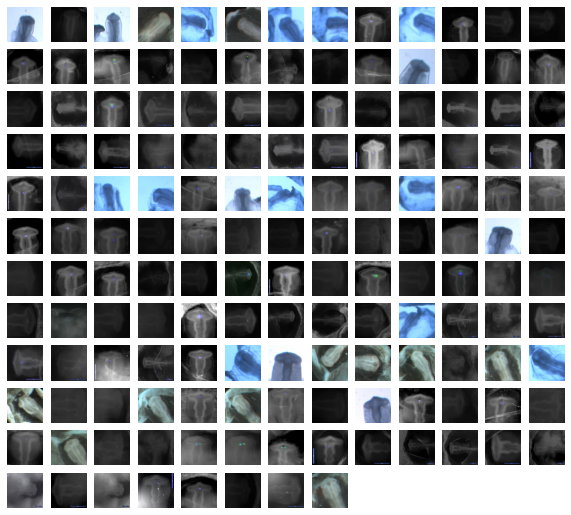

In [ ]:
visualise_all(data2)

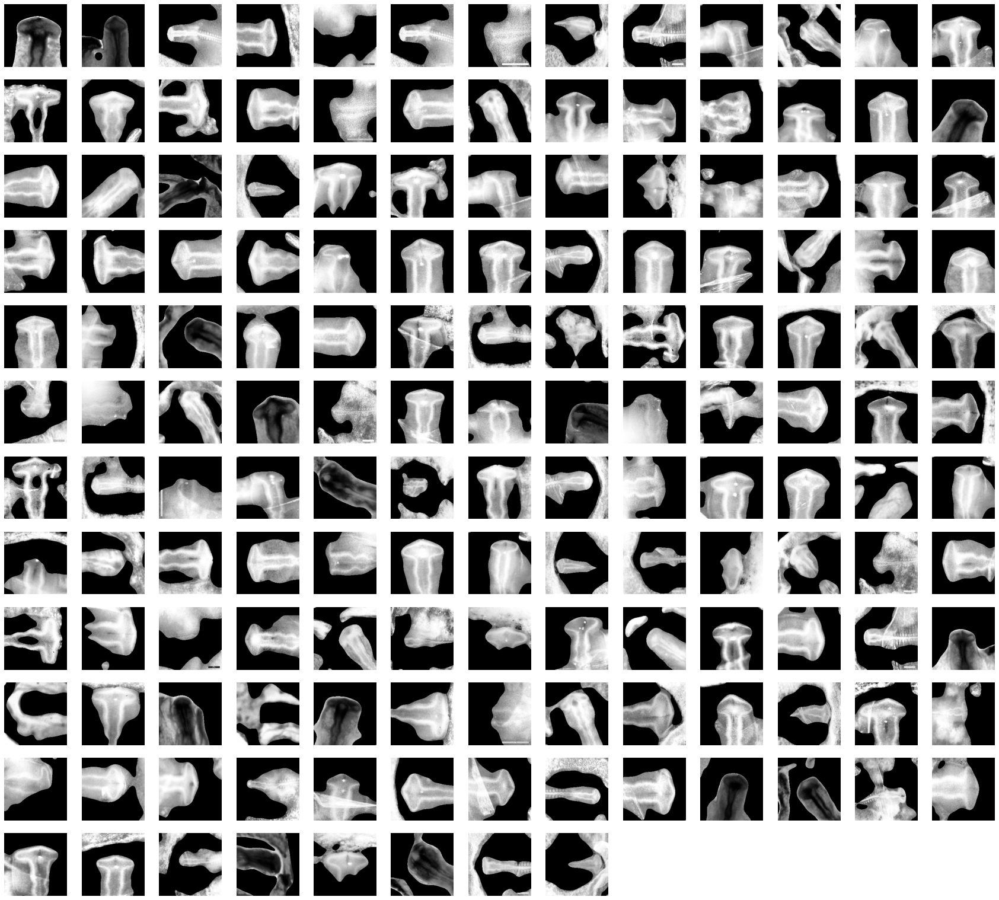

In [ ]:
back_data = []
for feature, label in tdata:
  feature = cv2.equalizeHist(feature)
  blur = skimage.filters.gaussian(feature, sigma=10)
  # perform adaptive thresholding
  t = skimage.filters.threshold_otsu(blur)
  if feature[100][100] > 50:
    mask = blur > t
  else:
    mask = blur < t
  # use the mask to select the "interesting" part of the image
  sel = np.zeros_like(feature)
  sel[mask] = feature[mask]
  back_data.append([sel, label])
visualise_all(back_data, figsize1=30, figsize2 = 30)

In [ ]:
split1aug = []
for feature, label in split1:
  for angle in np.arange(0, 360, 10):  
    feature = cv2.equalizeHist(feature)
    blur = skimage.filters.gaussian(feature, sigma=10)
    # perform adaptive thresholding
    t = skimage.filters.threshold_otsu(blur)
    if feature[100][100] > 100:
      mask = blur > t
    # use the mask to select the "interesting" part of the image
      sel = np.zeros_like(feature)
      sel[mask] = feature[mask]
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = sel)
      split1aug.append([feature, label])
      split1aug.append([feature2, label])

split2aug = []
for feature, label in split2:
  for angle in np.arange(0, 360, 10):  
    feature = cv2.equalizeHist(feature)
    blur = skimage.filters.gaussian(feature, sigma=10)
    # perform adaptive thresholding
    t = skimage.filters.threshold_otsu(blur)
    if feature[100][100] > 100:
      mask = blur > t
      # use the mask to select the "interesting" part of the image
      sel = np.zeros_like(feature)
      sel[mask] = feature[mask]
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = sel)
      split2aug.append([feature, label])
      split2aug.append([feature2, label])

split3aug = []
for feature, label in split3:
  for angle in np.arange(0, 360, 10):  
    feature = cv2.equalizeHist(feature)
    blur = skimage.filters.gaussian(feature, sigma=10)
    # perform adaptive thresholding
    t = skimage.filters.threshold_otsu(blur)
    if feature[100][100] > 100:
      mask = blur > t
      # use the mask to select the "interesting" part of the image
      sel = np.zeros_like(feature)
      sel[mask] = feature[mask]
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = sel)
      split3aug.append([feature, label])
      split3aug.append([feature2, label])

split4aug = []
for feature, label in split4:
  for angle in np.arange(0, 360, 10):  
    feature = cv2.equalizeHist(feature)
    blur = skimage.filters.gaussian(feature, sigma=10)
    # perform adaptive thresholding
    t = skimage.filters.threshold_otsu(blur)
    if feature[100][100] > 100:
      mask = blur > t
    # use the mask to select the "interesting" part of the image
      sel = np.zeros_like(feature)
      sel[mask] = feature[mask]
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = sel)
      split4aug.append([feature, label])
      split4aug.append([feature2, label])

split5aug = []
for feature, label in split5:
  for angle in np.arange(0, 360, 10):  
    feature = cv2.equalizeHist(feature)
    blur = skimage.filters.gaussian(feature, sigma=10)
    # perform adaptive thresholding
    t = skimage.filters.threshold_otsu(blur)
    if feature[100][100] > 100:
      mask = blur > t
    # use the mask to select the "interesting" part of the image
      sel = np.zeros_like(feature)
      sel[mask] = feature[mask]
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = sel)
      split5aug.append([feature, label])
      split5aug.append([feature2, label])

split6aug = []
for feature, label in split6:
  for angle in np.arange(0, 360, 10):  
    feature = cv2.equalizeHist(feature)
    blur = skimage.filters.gaussian(feature, sigma=10)
    # perform adaptive thresholding
    t = skimage.filters.threshold_otsu(blur)
    if feature[100][100] > 100:
      mask = blur > t
    # use the mask to select the "interesting" part of the image
      sel = np.zeros_like(feature)
      sel[mask] = feature[mask]
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = sel)
      split6aug.append([feature, label])
      split6aug.append([feature2, label])

split7aug = []
for feature, label in split7:
  for angle in np.arange(0, 360, 10):  
    feature = cv2.equalizeHist(feature)
    blur = skimage.filters.gaussian(feature, sigma=10)
    # perform adaptive thresholding
    t = skimage.filters.threshold_otsu(blur)
    if feature[100][100] > 100:
      mask = blur > t
    # use the mask to select the "interesting" part of the image
      sel = np.zeros_like(feature)
      sel[mask] = feature[mask]
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = sel)
      split7aug.append([feature, label])
      split7aug.append([feature2, label])

split8aug = []
for feature, label in split8:
  for angle in np.arange(0, 360, 10):  
    feature = cv2.equalizeHist(feature)
    blur = skimage.filters.gaussian(feature, sigma=10)
    # perform adaptive thresholding
    t = skimage.filters.threshold_otsu(blur)
    if feature[100][100] > 100:
      mask = blur > t
      # use the mask to select the "interesting" part of the image
      sel = np.zeros_like(feature)
      sel[mask] = feature[mask]
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = sel)
      split8aug.append([feature, label])
      split8aug.append([feature2, label])

split9aug = []
for feature, label in split9:
  for angle in np.arange(0, 360, 10):  
    feature = cv2.equalizeHist(feature)
    blur = skimage.filters.gaussian(feature, sigma=10)
    # perform adaptive thresholding
    t = skimage.filters.threshold_otsu(blur)
    if feature[100][100] > 100:
      mask = blur > t
    # use the mask to select the "interesting" part of the image
      sel = np.zeros_like(feature)
      sel[mask] = feature[mask]
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = sel)
      split9aug.append([feature, label])
      split9aug.append([feature2, label])

split10aug = []
for feature, label in split10:
  for angle in np.arange(0, 360, 10):  
    feature = cv2.equalizeHist(feature)
    blur = skimage.filters.gaussian(feature, sigma=10)
    # perform adaptive thresholding
    t = skimage.filters.threshold_otsu(blur)
    if feature[100][100] > 100:
      mask = blur > t
      # use the mask to select the "interesting" part of the image
      sel = np.zeros_like(feature)
      sel[mask] = feature[mask]
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = sel)
      split10aug.append([feature, label])
      split10aug.append([feature2, label])

train1 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val1 = split1aug
train2 = np.concatenate([split1aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val2 = split2aug
train3 = np.concatenate([split2aug, split1aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val3 = split3aug
train4 = np.concatenate([split2aug, split3aug, split1aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val4 = split4aug
train5 = np.concatenate([split2aug, split3aug, split4aug, split1aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val5 = split5aug
train6 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split1aug, split7aug, split8aug, split9aug, split10aug])
val6 = split6aug
train7 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split1aug, split8aug, split9aug, split10aug])
val7 = split7aug
train8 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split1aug, split9aug, split10aug])
val8 = split8aug
train9 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split1aug, split10aug])
val9 = split9aug
train10 = np.concatenate([split2aug, split3aug, split4aug, split5aug, split6aug, split7aug, split8aug, split9aug, split1aug])
val10 = split10aug

<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


In [ ]:
%%time
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1
X_train shape: (8504, 200, 200, 1)
X_val shape: (792, 200, 200, 1)
y_train shape: (8504, 3)
y_val shape: (792, 3)
Epoch 1/50
266/266 [==============================] - 9s 29ms/step - loss: 1.1580 - accuracy: 0.4461 - val_loss: 1.1926 - val_accuracy: 0.3093
Epoch 2/50
266/266 [==============================] - 7s 28ms/step - loss: 0.8548 - accuracy: 0.6627 - val_loss: 0.9862 - val_accuracy: 0.6389
Epoch 3/50
266/266 [==============================] - 7s 28ms/step - loss: 0.4159 - accuracy: 0.8902 - val_loss: 0.7791 - val_accuracy: 0.7715
Epoch 4/50
266/266 [==============================] - 7s 28ms/step - loss: 0.2590 - accuracy: 0.9510 - val_loss: 0.7133 - val_accuracy: 0.7904
Epoch 5/50
266/266 [==============================] - 7s 28ms/step - loss: 0.1784 - accuracy: 0.9751 - val_loss: 0.6617 - val_accuracy: 0.7854
Epoch 6/50
266/266 [==============================] - 7s 28ms/step - loss: 0.1565 - accuracy: 0.9848 - val_loss: 0.5866 - val_accuracy: 0.8043
Epoch 7/50


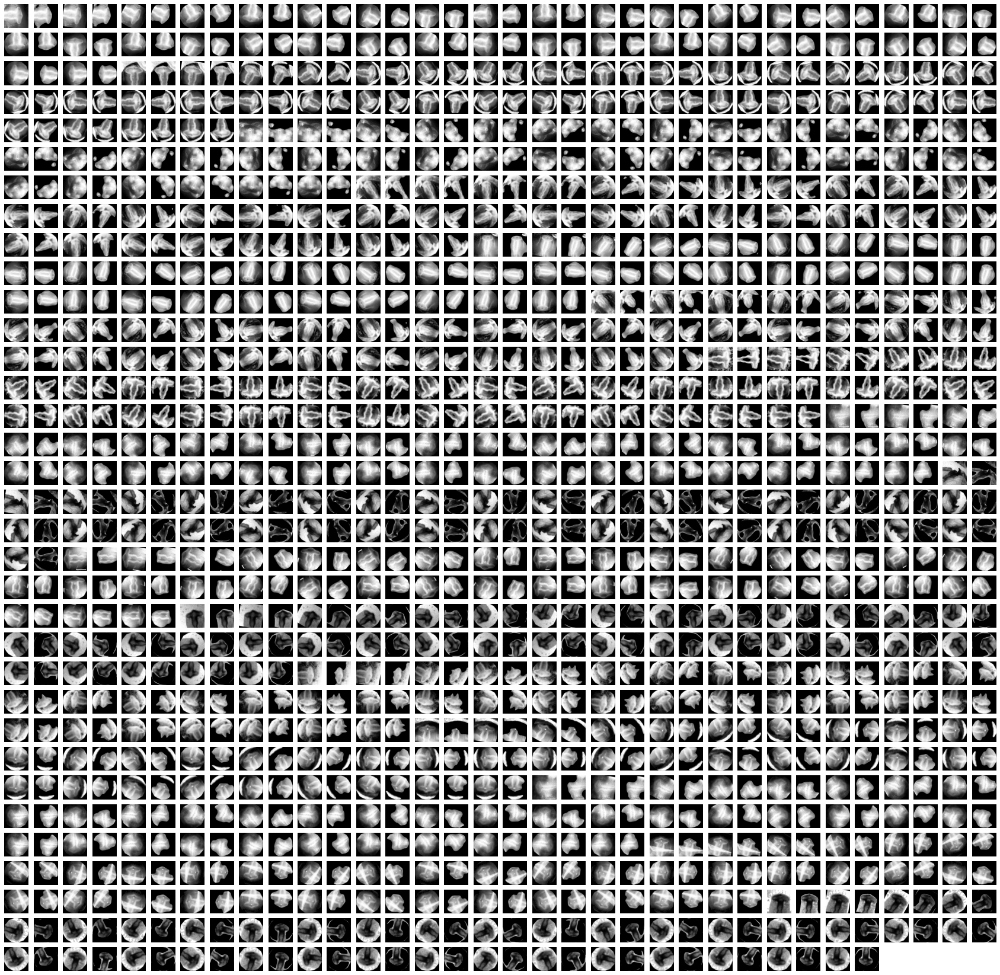

In [ ]:
visualise_all(split5aug, figsize1 = 30, figsize2 = 30)

In [ ]:
%%time
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')

Training model 1
X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/50
306/306 [==============================] - 10s 30ms/step - loss: 1.1203 - accuracy: 0.4757 - val_loss: 1.1731 - val_accuracy: 0.3722
Epoch 2/50
306/306 [==============================] - 9s 29ms/step - loss: 0.7873 - accuracy: 0.7107 - val_loss: 1.0359 - val_accuracy: 0.5639
Epoch 3/50
306/306 [==============================] - 9s 29ms/step - loss: 0.4471 - accuracy: 0.8785 - val_loss: 0.9077 - val_accuracy: 0.6519
Epoch 4/50
306/306 [==============================] - 9s 29ms/step - loss: 0.2652 - accuracy: 0.9445 - val_loss: 0.8520 - val_accuracy: 0.6444
Epoch 5/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1957 - accuracy: 0.9705 - val_loss: 0.8110 - val_accuracy: 0.6963
Epoch 6/50
306/306 [==============================] - 9s 29ms/step - loss: 0.1598 - accuracy: 0.9816 - val_loss: 0.8799 - val_accuracy: 0.6389
Epoch 7/

### Analysing split 4

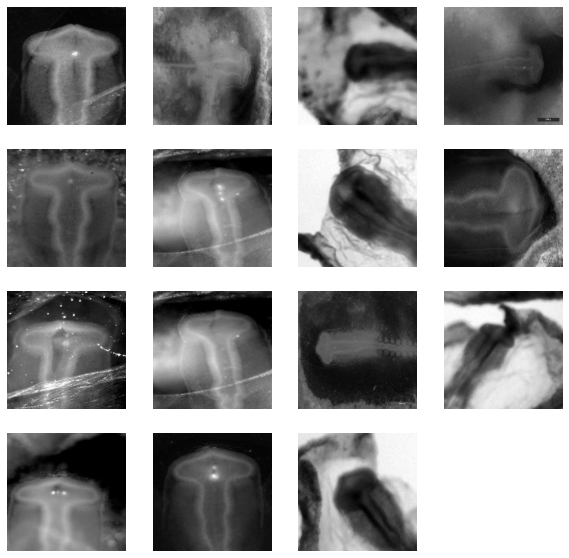

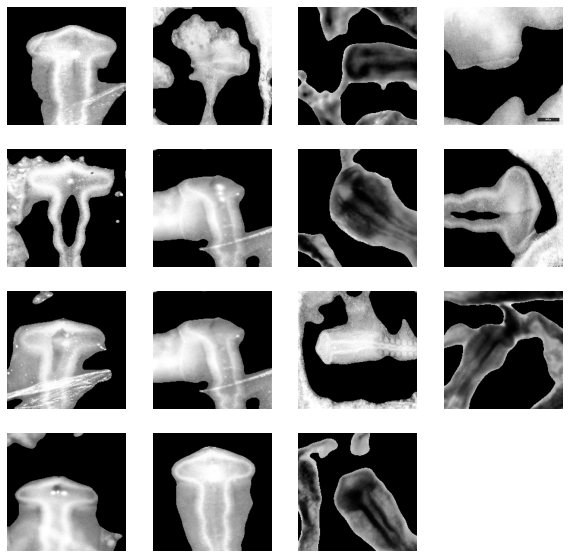

In [ ]:
test = []
for feature, label in split1:
  feature = cv2.equalizeHist(feature)
  blur = skimage.filters.gaussian(feature, sigma=5)
  # perform adaptive thresholding
  t = skimage.filters.threshold_otsu(blur)
  if feature[100][100] > 100:
    mask = blur > t
  else:
    mask = blur < t
  # use the mask to select the "interesting" part of the image
  sel = np.zeros_like(feature)
  sel[mask] = feature[mask]
  test.append([sel, label])
visualise_all(split1)
visualise_all(test)

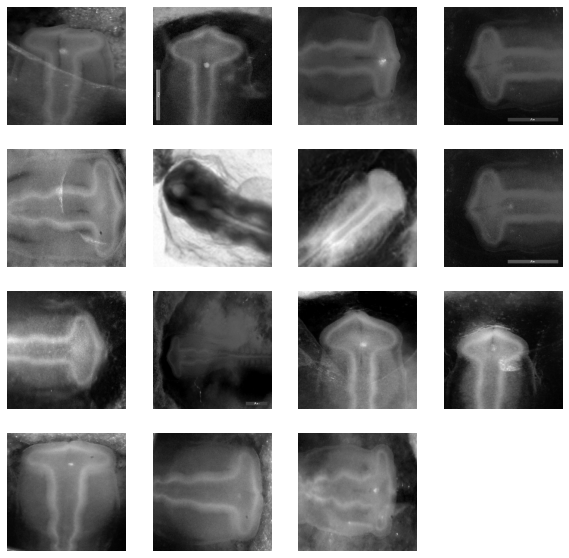

In [ ]:
visualise_all(split4)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

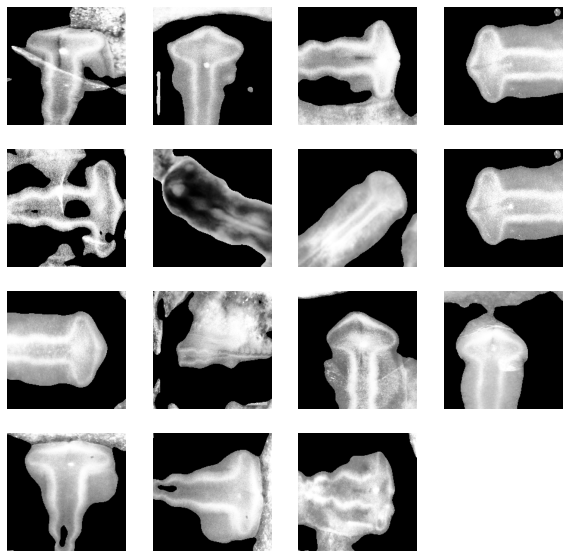

In [ ]:
visualise_all(test)
plt.savefig('split4_rm_background.png')
files.download('split4_rm_background.png')

# Deleting some images from data set

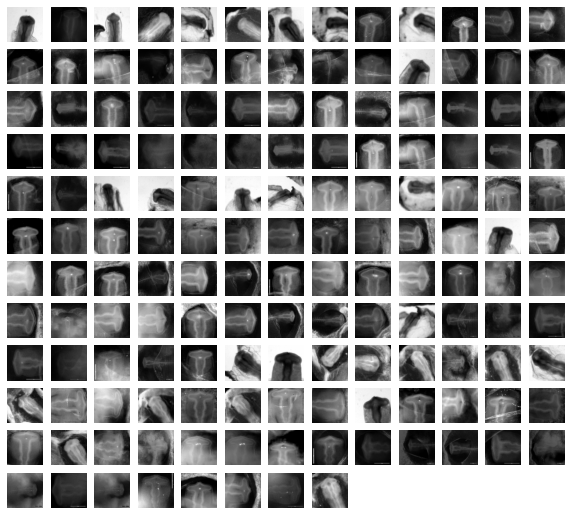

In [ ]:
visualise_all(tdata)

In [ ]:
odd_data_list = [
                 '10.3_023.jpg',
                 '10.3_025.jpg',
                 '10.3_036.jpg',
                 '10.3_038.jpg',
                 '10.3_020.jpg',
                 '10.3_005.jpg',
                 '10.3_017.jpg', 
                 '10.3_003.jpg',
                 '10.3_002.jpg',
                 '10.2_009.jpg',
                 '10.2_025.jpg',
                 '10.2_019.jpg',
                 '10.2_033.jpg'
]

In [ ]:
tenthree = os.listdir('labeled_data/10_3')
l3 = [x for x in tenthree if x not in odd_data_list]
tentwo = os.listdir('labeled_data/10_2')
l2 = [x for x in tentwo if x not in odd_data_list]

In [ ]:


tdata = []

for img in os.listdir('labeled_data/10_1'):  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_1/{}'.format(img), cv2.IMREAD_GRAYSCALE) 
        tdata.append([cv2.resize(img_array, (200, 200)), 0])
    except Exception as e:  
        pass

for img in l2:  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_2/{}'.format(img), cv2.IMREAD_GRAYSCALE) 
        tdata.append([cv2.resize(img_array, (200, 200)), 1])
    except Exception as e:  
        pass

for img in l3:  # iterate over each image
    try:
        img_array = cv2.imread('labeled_data/10_3/{}'.format(img), cv2.IMREAD_GRAYSCALE) 
        tdata.append([cv2.resize(img_array, (200, 200)), 2])
    except Exception as e:  
        pass

In [ ]:
len(tdata)

138

In [ ]:
valaccs = []
vallosses = []
accs = []
acclosses = []
testaccs = []
testlosses = []
for i in range(10):

  random.shuffle(tdata)
  training_data = tdata[0:int(round(len(tdata)*0.8, 0))]
  val_data = tdata[int(round(len(tdata)*0.8, 0)):int(round(len(tdata), 0))]
  # test_data = tdata[int(round(len(tdata)*0.95, 0)):int(round(len(tdata), 0))]

  train = []
  for feature, label in training_data:
    for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      train.append([feature, label])
      train.append([feature2, label])

  val = []
  for feature, label in val_data:
    for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      val.append([feature, label])
      val.append([feature2, label])

  random.shuffle(train)
  random.shuffle(val)
  # random.shuffle(test_data)

  # Preprocessing the data into X_train etc with relevant input shapes
  X_train = []
  y_train = []
  X_val = []
  y_val = []
  X_test = []
  y_test = []
  img_size = 200

  for feature, label in train:
    X_train.append(feature)
    y_train.append(label)

  for feature, label in val:
    X_val.append(feature)
    y_val.append(label)

  # for feature, label in test_data:
  #   X_test.append(feature)
  #   y_test.append(label)

  X_train = np.array(X_train) / 255
  X_val = np.array(X_val) / 255
  # X_test = np.array(X_test) / 255

  X_train = X_train.reshape(X_train.shape[0], 200, 200, 1)
  X_val = X_val.reshape(X_val.shape[0], 200, 200, 1)
  # X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

  X_train.astype('float32')
  X_val.astype('float32')
  # X_test.astype('float32')

  y_train=to_categorical(y_train)
  y_val=to_categorical(y_val)
  # y_test = to_categorical(y_test)

  print('X_train shape:', np.shape(X_train))
  print('X_val shape:', np.shape(X_val))
  # print('X_test shape:', np.shape(X_test))
  print('y_train shape:', np.shape(y_train))
  print('y_val shape:', np.shape(y_val))
  # print('y_test shape:', np.shape(y_test))

  from tensorflow.keras import layers
  from tensorflow.keras import regularizers
  layer_drop = 0.2
  final_drop = 0.5
  activation = 'relu'
  lamda = 0.0001
  model = Sequential([
    layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 1), kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Flatten(),
    layers.Dense(1024, activation=activation),
    layers.Dropout(final_drop),
    layers.Dense(3, activation = 'softmax')
  ])
  #opt = Adam(learning_rate = learning_rate)
  model.compile(optimizer = Adam(learning_rate = 0.0001),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

  earlyStop = EarlyStopping(monitor = 'val_loss', min_delta = 0.01, patience = 5)
  epochs = 50
  history = model.fit(x=X_train,
                      y=y_train,
                      epochs=epochs,
                      batch_size=32,
                      validation_data=(X_val, y_val),
                      callbacks=[earlyStop])

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']
  accuracy = history.history['val_accuracy'][-1]
  # testvals = model.evaluate(X_test, y_test)

  valaccs.append(round(max(val_acc)*100, 1))
  vallosses.append(round(min(val_loss)*100, 1))
  accs.append(round(max(acc)*100, 1))
  acclosses.append(round(min(loss)*100, 1))
  # testaccs.append(round(testvals[1]*100, 1))
  # testlosses.append(round(testvals[0]*100, 1))

  del model
  K.clear_session()

print('Accuracies:', accs)
print('Average accuracy:', round(np.mean(accs),1))
print('Average loss:', round(np.mean(acclosses),1))
print('Accuracy standard deviation:', np.std(accs))
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Average validation loss:', round(np.mean(vallosses),1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
# print('Test accuracies:', testaccs)
# print('Average test accuracy:', round(np.mean(testaccs), 1))
# print('Average test loss:', round(np.mean(testlosses),1))
# print('Test standard deviation:', round(np.std(testaccs), 1))

X_train shape: (7920, 200, 200, 1)
X_val shape: (2016, 200, 200, 1)
y_train shape: (7920, 3)
y_val shape: (2016, 3)
Epoch 1/50
248/248 [==============================] - 15s 52ms/step - loss: 1.1759 - accuracy: 0.4279 - val_loss: 1.2024 - val_accuracy: 0.3557
Epoch 2/50
248/248 [==============================] - 12s 48ms/step - loss: 0.9935 - accuracy: 0.5595 - val_loss: 1.1205 - val_accuracy: 0.4529
Epoch 3/50
248/248 [==============================] - 12s 48ms/step - loss: 0.5593 - accuracy: 0.8146 - val_loss: 1.0859 - val_accuracy: 0.5977
Epoch 4/50
248/248 [==============================] - 12s 49ms/step - loss: 0.2770 - accuracy: 0.9350 - val_loss: 1.1225 - val_accuracy: 0.6801
Epoch 5/50
248/248 [==============================] - 12s 48ms/step - loss: 0.1813 - accuracy: 0.9692 - val_loss: 1.1617 - val_accuracy: 0.6468
Epoch 6/50
248/248 [==============================] - 12s 48ms/step - loss: 0.1474 - accuracy: 0.9827 - val_loss: 1.1108 - val_accuracy: 0.6939
Epoch 7/50
248/248 [

KeyboardInterrupt: ignored

# Improving quality

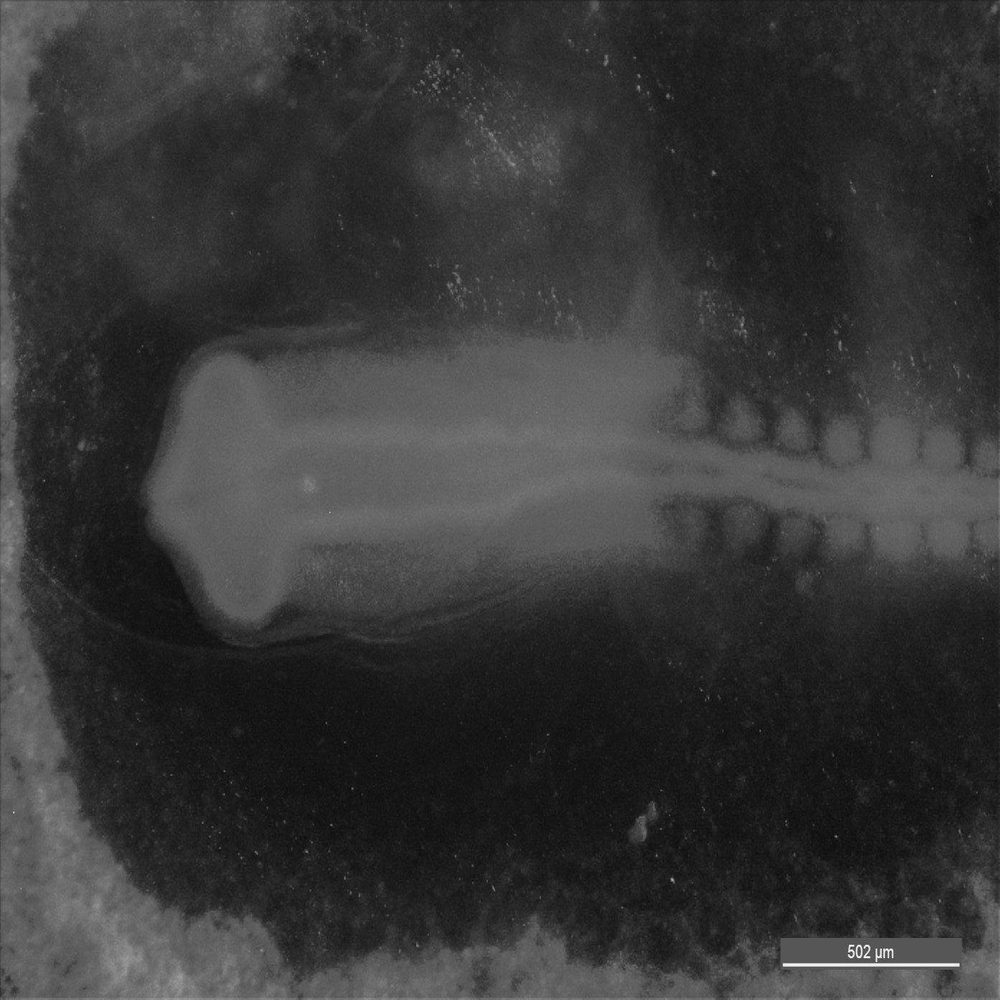

In [ ]:
img

In [ ]:
black = (0,0,0)
white = (255,255,255)
threshold = (50,50,50)

# Open input image in grayscale mode and get its pixels.
img = Image.open("labeled_data/10_1/10.1_000.jpg").convert("LA")
# img = tdata[0][0]
pixels = img.getdata()

newPixels = []

# Compare each pixel 
for pixel in pixels:
    if pixel < threshold:
        newPixels.append(black)
    else:
        newPixels.append(white)

newImg = Image.new("RGB",img.size)
newImg.putdata(newPixels)
newImg.save("newImage.jpg")

TypeError: ignored

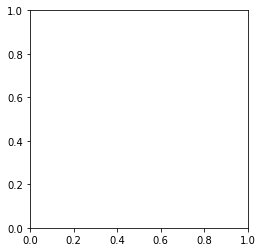

In [ ]:
plt.imshow('newImage.jpg')

# Letting cutout run to convergence on the splits

In [ ]:
def train_model(train, val):

  random.seed(1234)
  random.shuffle(train)
  random.shuffle(val)
  # random.shuffle(test_data)

  # Preprocessing the data into X_train etc with relevant input shapes
  X_train = []
  y_train = []
  X_val = []
  y_val = []
  X_test = []
  y_test = []
  img_size = 200

  for feature, label in train:
    X_train.append(feature)
    y_train.append(label)

  for feature, label in val:
    X_val.append(feature)
    y_val.append(label)

  # for feature, label in test_data:
  #   X_test.append(feature)
  #   y_test.append(label)

  X_train = np.array(X_train) / 255
  X_val = np.array(X_val) / 255
  # X_test = np.array(X_test) / 255

  X_train = X_train.reshape(X_train.shape[0], 200, 200, 1)
  X_val = X_val.reshape(X_val.shape[0], 200, 200, 1)
  # X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

  X_train.astype('float32')
  X_val.astype('float32')
  # X_test.astype('float32')

  y_train=to_categorical(y_train)
  y_val=to_categorical(y_val)
  # y_test = to_categorical(y_test)

  print('X_train shape:', np.shape(X_train))
  print('X_val shape:', np.shape(X_val))
  # print('X_test shape:', np.shape(X_test))
  print('y_train shape:', np.shape(y_train))
  print('y_val shape:', np.shape(y_val))
  # print('y_test shape:', np.shape(y_test))

  from tensorflow.keras import layers
  from tensorflow.keras import regularizers
  layer_drop = 0.2
  final_drop = 0.5
  activation = 'relu'
  lamda = 0.0001
  model = Sequential([
    layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 1), kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
    layers.Dropout(layer_drop),
    layers.MaxPooling2D((2,2), padding='same'),
    layers.Flatten(),
    layers.Dense(1024, activation=activation),
    layers.Dropout(final_drop),
    layers.Dense(3, activation = 'softmax')
  ])
  #opt = Adam(learning_rate = learning_rate)
  model.compile(optimizer = Adam(learning_rate = 0.0001),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

  earlyStop = EarlyStopping(monitor = 'val_loss', min_delta = 0.01, patience = 10)
  epochs = 100
  history = model.fit(x=X_train,
                      y=y_train,
                      epochs=epochs,
                      batch_size=32,
                      validation_data=(X_val, y_val))

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']
  accuracy = history.history['val_accuracy'][-1]
  # testvals = model.evaluate(X_test, y_test)

  # valaccs.append(round(max(val_acc)*100, 1))
  # vallosses.append(round(min(val_loss)*100, 1))
  # accs.append(round(max(acc)*100, 1))
  # acclosses.append(round(min(loss)*100, 1))
  # testaccs.append(round(testvals[1]*100, 1))
  # testlosses.append(round(testvals[0]*100, 1))

  del model
  K.clear_session()

  return round(max(val_acc)*100, 1)

In [ ]:
split1aug = []
for feature, label in split1:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split1aug.append([feature, label])
      split1aug.append([feature2, label])
  
split2aug = []
for feature, label in split2:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split2aug.append([feature, label])
      split2aug.append([feature2, label])

split3aug = []
for feature, label in split3:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split3aug.append([feature, label])
      split3aug.append([feature2, label])

split4aug = []
for feature, label in split4:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split4aug.append([feature, label])
      split4aug.append([feature2, label])

split5aug = []
for feature, label in split5:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split5aug.append([feature, label])
      split5aug.append([feature2, label])

split6aug = []
for feature, label in split6:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split6aug.append([feature, label])
      split6aug.append([feature2, label])

split7aug = []
for feature, label in split7:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split7aug.append([feature, label])
      split7aug.append([feature2, label])

split8aug = []
for feature, label in split8:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split8aug.append([feature, label])
      split8aug.append([feature2, label])

split9aug = []
for feature, label in split9:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split9aug.append([feature, label])
      split9aug.append([feature2, label])

split10aug = []
for feature, label in split10:
  for angle in np.arange(0, 360, 10):
      feature = cv2.equalizeHist(feature)
      cutout = iaa.Cutout()
      feature2 = cutout(image = feature)
      rotate = iaa.geometric.Affine(rotate = angle)
      feature = rotate(image = feature)
      feature2 = rotate(image = feature2)
      split10aug.append([feature, label])
      split10aug.append([feature2, label])

In [ ]:
%%time
valaccs = []
print('=========================================')
print('Training model 1')
valaccs.append(train_model(train1, val1))
print('Model 1 validation accuracy:', valaccs[0])
print('=========================================')
print('Training model 2')
valaccs.append(train_model(train2, val2))
print('Model 2 validation accuracy:', valaccs[1])
print('=========================================')
print('Training model 3')
valaccs.append(train_model(train3, val3))
print('Model 3 validation accuracy:', valaccs[2])
print('=========================================')
print('Training model 4')
valaccs.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valaccs[3])
print('=========================================')
print('Training model 5')
valaccs.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valaccs[4])
print('=========================================')
print('Training model 6')
valaccs.append(train_model(train6, val6))
print('Model 6 validation accuracy:', valaccs[5])
print('=========================================')
print('Training model 7')
valaccs.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valaccs[6])
print('=========================================')
print('Training model 8')
valaccs.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valaccs[7])
print('=========================================')
print('Training model 9')
valaccs.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valaccs[8])
print('=========================================')
print('Training model 10')
valaccs.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valaccs[9])
print('=========================================')
print('Validation accuracies:', valaccs)
print('Average validation accuracy:', round(np.mean(valaccs), 1))
print('Validation standard deviation:', round(np.std(valaccs), 1))
print('=========================================')
# Saliency

Training model 1
X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/100
306/306 [==============================] - 32s 49ms/step - loss: 1.1029 - accuracy: 0.4829 - val_loss: 1.1496 - val_accuracy: 0.4667
Epoch 2/100
306/306 [==============================] - 14s 47ms/step - loss: 0.6784 - accuracy: 0.7608 - val_loss: 0.9888 - val_accuracy: 0.6324
Epoch 3/100
306/306 [==============================] - 14s 47ms/step - loss: 0.3687 - accuracy: 0.9075 - val_loss: 0.9676 - val_accuracy: 0.6963
Epoch 4/100
306/306 [==============================] - 14s 47ms/step - loss: 0.2287 - accuracy: 0.9593 - val_loss: 0.9358 - val_accuracy: 0.6769
Epoch 5/100
306/306 [==============================] - 15s 48ms/step - loss: 0.1730 - accuracy: 0.9755 - val_loss: 0.8567 - val_accuracy: 0.6917
Epoch 6/100
306/306 [==============================] - 15s 48ms/step - loss: 0.1471 - accuracy: 0.9849 - val_loss: 0.7831 - val_accuracy: 0.70

In [ ]:
valacc = []
train4 = np.concatenate([split2aug, split3aug, split1aug, split5aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val4 = split4aug
print('=========================================')
print('Training model 4')
valacc.append(train_model(train4, val4))
print('Model 4 validation accuracy:', valacc)
print('=========================================')

<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


Training model 4
X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/100
306/306 [==============================] - 16s 49ms/step - loss: 1.1351 - accuracy: 0.4372 - val_loss: 1.1872 - val_accuracy: 0.3000
Epoch 2/100
306/306 [==============================] - 15s 48ms/step - loss: 0.6726 - accuracy: 0.7600 - val_loss: 1.0107 - val_accuracy: 0.6694
Epoch 3/100
306/306 [==============================] - 15s 48ms/step - loss: 0.3259 - accuracy: 0.9227 - val_loss: 0.9839 - val_accuracy: 0.6981
Epoch 4/100
306/306 [==============================] - 15s 48ms/step - loss: 0.2143 - accuracy: 0.9634 - val_loss: 1.0519 - val_accuracy: 0.7111
Epoch 5/100
306/306 [==============================] - 15s 48ms/step - loss: 0.1571 - accuracy: 0.9819 - val_loss: 1.2142 - val_accuracy: 0.6954
Epoch 6/100
306/306 [==============================] - 15s 48ms/step - loss: 0.1404 - accuracy: 0.9868 - val_loss: 1.0921 - val_accuracy: 0.71

In [ ]:
valacc = []
train5 = np.concatenate([split2aug, split3aug, split1aug, split4aug, split6aug, split7aug, split8aug, split9aug, split10aug])
val5 = split5aug
print('=========================================')
print('Training model 5')
valacc.append(train_model(train5, val5))
print('Model 5 validation accuracy:', valacc)
print('=========================================')

<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


Training model 5
X_train shape: (9720, 200, 200, 1)
X_val shape: (1152, 200, 200, 1)
y_train shape: (9720, 3)
y_val shape: (1152, 3)
Epoch 1/100
304/304 [==============================] - 16s 49ms/step - loss: 1.1486 - accuracy: 0.4337 - val_loss: 1.1845 - val_accuracy: 0.3568
Epoch 2/100
304/304 [==============================] - 14s 47ms/step - loss: 0.7608 - accuracy: 0.7180 - val_loss: 1.0162 - val_accuracy: 0.5043
Epoch 3/100
304/304 [==============================] - 14s 47ms/step - loss: 0.3735 - accuracy: 0.9022 - val_loss: 0.8797 - val_accuracy: 0.6649
Epoch 4/100
304/304 [==============================] - 14s 47ms/step - loss: 0.2214 - accuracy: 0.9603 - val_loss: 0.8950 - val_accuracy: 0.5877
Epoch 5/100
304/304 [==============================] - 14s 47ms/step - loss: 0.1690 - accuracy: 0.9757 - val_loss: 0.6759 - val_accuracy: 0.7682
Epoch 6/100
304/304 [==============================] - 14s 47ms/step - loss: 0.1355 - accuracy: 0.9899 - val_loss: 0.8565 - val_accuracy: 0.62

In [ ]:
valacc = []
train6 = np.concatenate([split2aug, split3aug, split1aug, split5aug, split4aug, split7aug, split8aug, split9aug, split10aug])
val6 = split6aug
print('=========================================')
print('Training model 6')
train_model(train6, val6)
print('Model 6 validation accuracy:', valacc)
print('=========================================')

<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


Training model 6
X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/100
306/306 [==============================] - 33s 50ms/step - loss: 1.1204 - accuracy: 0.4675 - val_loss: 1.1543 - val_accuracy: 0.4148
Epoch 2/100
306/306 [==============================] - 15s 48ms/step - loss: 0.6576 - accuracy: 0.7784 - val_loss: 1.0117 - val_accuracy: 0.6259
Epoch 3/100
306/306 [==============================] - 15s 48ms/step - loss: 0.3329 - accuracy: 0.9171 - val_loss: 1.0118 - val_accuracy: 0.5204
Epoch 4/100
306/306 [==============================] - 15s 48ms/step - loss: 0.2118 - accuracy: 0.9625 - val_loss: 0.9860 - val_accuracy: 0.5287
Epoch 5/100
306/306 [==============================] - 15s 48ms/step - loss: 0.1590 - accuracy: 0.9801 - val_loss: 1.0039 - val_accuracy: 0.5741
Epoch 6/100
306/306 [==============================] - 15s 48ms/step - loss: 0.1399 - accuracy: 0.9875 - val_loss: 1.0367 - val_accuracy: 0.53

In [ ]:
valacc = []
train7 = np.concatenate([split2aug, split3aug, split1aug, split4aug, split6aug, split5aug, split8aug, split9aug, split10aug])
val7 = split7aug
print('=========================================')
print('Training model 7')
valacc.append(train_model(train7, val7))
print('Model 7 validation accuracy:', valacc)
print('=========================================')

Training model 7


<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/100
306/306 [==============================] - 16s 50ms/step - loss: 1.1405 - accuracy: 0.4421 - val_loss: 1.1297 - val_accuracy: 0.4148
Epoch 2/100
306/306 [==============================] - 15s 49ms/step - loss: 0.7349 - accuracy: 0.7302 - val_loss: 0.8687 - val_accuracy: 0.6889
Epoch 3/100
306/306 [==============================] - 15s 49ms/step - loss: 0.3498 - accuracy: 0.9137 - val_loss: 0.7737 - val_accuracy: 0.7519
Epoch 4/100
306/306 [==============================] - 15s 49ms/step - loss: 0.2064 - accuracy: 0.9637 - val_loss: 0.8571 - val_accuracy: 0.6944
Epoch 5/100
306/306 [==============================] - 15s 49ms/step - loss: 0.1587 - accuracy: 0.9793 - val_loss: 0.9362 - val_accuracy: 0.6769
Epoch 6/100
306/306 [==============================] - 15s 49ms/step - loss: 0.1305 - accuracy: 0.9900 - val_loss: 0.8896 - val_accuracy: 0.7157
Epoch 7/100
30

In [ ]:
valacc = []
train8 = np.concatenate([split2aug, split3aug, split1aug, split4aug, split6aug, split7aug, split5aug, split9aug, split10aug])
val8 = split8aug
print('=========================================')
print('Training model 8')
valacc.append(train_model(train8, val8))
print('Model 8 validation accuracy:', valacc)
print('=========================================')

Training model 8


<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


X_train shape: (9792, 200, 200, 1)
X_val shape: (1080, 200, 200, 1)
y_train shape: (9792, 3)
y_val shape: (1080, 3)
Epoch 1/100
306/306 [==============================] - 16s 50ms/step - loss: 1.1494 - accuracy: 0.4388 - val_loss: 1.2360 - val_accuracy: 0.2528
Epoch 2/100
306/306 [==============================] - 15s 49ms/step - loss: 0.7071 - accuracy: 0.7439 - val_loss: 1.3392 - val_accuracy: 0.3926
Epoch 3/100
306/306 [==============================] - 15s 50ms/step - loss: 0.3228 - accuracy: 0.9239 - val_loss: 1.4271 - val_accuracy: 0.4537
Epoch 4/100
306/306 [==============================] - 15s 50ms/step - loss: 0.2009 - accuracy: 0.9672 - val_loss: 1.3143 - val_accuracy: 0.4491
Epoch 5/100
306/306 [==============================] - 15s 50ms/step - loss: 0.1531 - accuracy: 0.9836 - val_loss: 1.3887 - val_accuracy: 0.4926
Epoch 6/100
306/306 [==============================] - 15s 50ms/step - loss: 0.1285 - accuracy: 0.9899 - val_loss: 1.5449 - val_accuracy: 0.4833
Epoch 7/100
30

KeyboardInterrupt: ignored

In [ ]:
valacc = []
train9 = np.concatenate([split2aug, split3aug, split1aug, split4aug, split6aug, split7aug, split8aug, split5aug, split10aug])
val9 = split9aug
print('=========================================')
print('Training model 9')
valacc.append(train_model(train9, val9))
print('Model 9 validation accuracy:', valacc)
print('=========================================')

In [ ]:
valacc = []
train10 = np.concatenate([split2aug, split3aug, split1aug, split4aug, split6aug, split7aug, split8aug, split9aug, split5aug])
val10 = split10aug
print('=========================================')
print('Training model 10')
valacc.append(train_model(train10, val10))
print('Model 10 validation accuracy:', valacc)
print('=========================================')

In [ ]:

random.shuffle(tdata)
training_data = tdata[0:int(round(len(tdata)*0.8, 0))]
val_data = tdata[int(round(len(tdata)*0.8, 0)):int(round(len(tdata)*0.95, 0))]
test_data = tdata[int(round(len(tdata)*0.95, 0)):int(round(len(tdata), 0))]

train = []
for feature, label in training_data:
  for angle in np.arange(0, 360, 10):
    feature = cv2.equalizeHist(feature)
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    train.append([feature, label])

val = []
for feature, label in val_data:
  for angle in np.arange(0, 360, 10):
    feature = cv2.equalizeHist(feature)
    rotate = iaa.geometric.Affine(rotate = angle)
    feature = rotate(image = feature)
    val.append([feature, label])

random.shuffle(train)
random.shuffle(val)
# random.shuffle(test_data3)

# Preprocessing the data into X_train etc with relevant input shapes
X_train = []
y_train = []
X_val = []
y_val = []
X_test = []
y_test = []
img_size = 200

for feature, label in train:
  X_train.append(feature)
  y_train.append(label)

for feature, label in val:
  X_val.append(feature)
  y_val.append(label)

# for feature, label in test_data2:
#   X_test.append(feature)
#   y_test.append(label)

X_train = np.array(X_train) / 255
X_val = np.array(X_val) / 255
# X_test = np.array(X_test) / 255

X_train = X_train.reshape(X_train.shape[0], 200, 200, 1)
X_val = X_val.reshape(X_val.shape[0], 200, 200, 1)
# X_test = X_test.reshape(X_test.shape[0], 200, 200, 1)

X_train.astype('float32')
X_val.astype('float32')
# X_test.astype('float32')

y_train=to_categorical(y_train)
y_val=to_categorical(y_val)
# y_test = to_categorical(y_test)

print('X_train shape:', np.shape(X_train))
print('X_val shape:', np.shape(X_val))
print('X_test shape:', np.shape(X_test))
print('y_train shape:', np.shape(y_train))
print('y_val shape:', np.shape(y_val))
print('y_test shape:', np.shape(y_test))

from tensorflow.keras import layers
from tensorflow.keras import regularizers
layer_drop = 0.2
final_drop = 0.5
activation = 'relu'
lamda = 0.0001
model = Sequential([
  layers.Conv2D(16, 3, padding='same', activation= activation, input_shape = (200, 200, 1), kernel_regularizer=regularizers.l2(lamda)),
  layers.Dropout(layer_drop),
  layers.MaxPooling2D((2,2), padding='same'),
  layers.Conv2D(32, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
  layers.Dropout(layer_drop),
  layers.MaxPooling2D((2,2), padding='same'),
  layers.Conv2D(64, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
  layers.Dropout(layer_drop),
  layers.MaxPooling2D((2,2), padding='same'),
  layers.Conv2D(128, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
  layers.Dropout(layer_drop),
  layers.MaxPooling2D((2,2), padding='same'),
  layers.Conv2D(256, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
  layers.Dropout(layer_drop),
  layers.MaxPooling2D((2,2), padding='same'),
  layers.Conv2D(512, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
  layers.Dropout(layer_drop),
  layers.MaxPooling2D((2,2), padding='same'),
  layers.Conv2D(1024, 3, padding='same', activation=activation, kernel_regularizer=regularizers.l2(lamda)),
  layers.Dropout(layer_drop),
  layers.MaxPooling2D((2,2), padding='same'),
  layers.Flatten(),
  layers.Dense(1024, activation=activation),
  layers.Dropout(final_drop),
  layers.Dense(3, activation = 'softmax')
])
#opt = Adam(learning_rate = learning_rate)
model.compile(optimizer = Adam(learning_rate = 0.0001),
              loss = 'categorical_crossentropy',
              metrics = ['accuracy'])

earlyStop = EarlyStopping(monitor = 'val_loss', min_delta = 0.01, patience = 10)
epochs = 50
history = model.fit(x=X_train,
                    y=y_train,
                    epochs=epochs,
                    batch_size=32,
                    validation_data=(X_val, y_val),
                    callbacks=[earlyStop])

acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
accuracy = history.history['val_accuracy'][-1]

TypeError: ignored

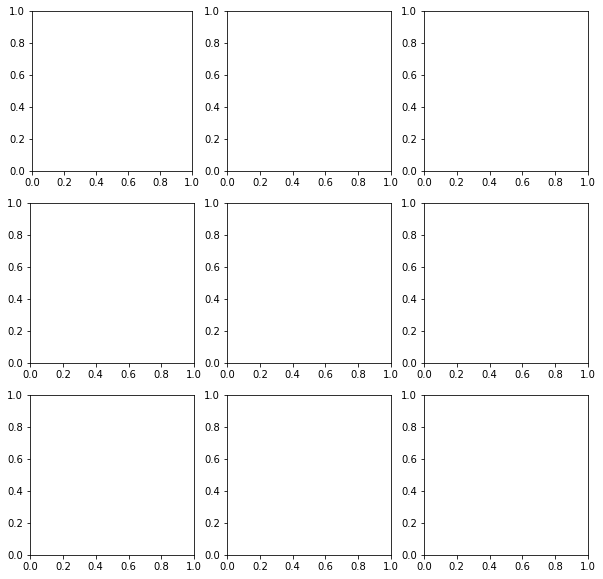

In [ ]:
from random import randint
import matplotlib.pylab as plt 
import numpy as np

def get_feature_maps(model, layer_id, input_image):
    model_ = Model(inputs=[model.input], 
                   outputs=[model.layers[layer_id].output])
    return model_.predict(np.expand_dims(input_image, 
                                         axis=0))[0,:,:,:].transpose((2,0,1))

def plot_features_map(img_idx=None, layer_idx=[0, 2, 4, 6, 8, 10, 12, 16], 
                      x_test=X_val, ytest=y_val, cnn=model):
    if img_idx == None:
        img_idx = randint(0, ytest.shape[0])
    input_image = x_test[img_idx]
    fig, ax = plt.subplots(3,3,figsize=(10,10))
    ax[0][0].imshow(input_image)
    ax[0][0].set_title('original img id {} - {}'.format(img_idx, 
                                                        labels[ytest[img_idx][0]]))
    for i, l in enumerate(layer_idx):
        feature_map = get_feature_maps(cnn, l, input_image)
        ax[(i+1)//3][(i+1)%3].imshow(feature_map[:,:,0])
        ax[(i+1)//3][(i+1)%3].set_title('layer {} - {}'.format(l, 
                                                               cnn.layers[l].get_config()['name']))
    return img_idx

labels =  ['10_1', '10_2', '10_3']

img_idx = plot_features_map()

In [ ]:
from vis.visualization import visualize_saliency

def plot_saliency(img_idx=None):
    img_idx = plot_features_map(img_idx)
    grads = visualize_saliency(cnn_saliency, -1, filter_indices=ytest[img_idx][0], 
                               seed_input=x_test[img_idx], backprop_modifier=None,
                               grad_modifier="absolute")
    predicted_label = labels[np.argmax(cnn.predict(x_test[img_idx].reshape(1,32,32,3)),1)[0]]
    fig, ax = plt.subplots(1,2, figsize=(10,5))
    ax[0].imshow(x_test[img_idx])
    ax[0].set_title('original img id {} - {}'.format(img_idx, labels[ytest[img_idx][0]]))
    ax[1].imshow(grads, cmap='jet')
    ax[1].set_title('saliency - predicted {}'.format(predicted_label))

plot_saliency()

# Figures
For use in the write-up

## Original

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

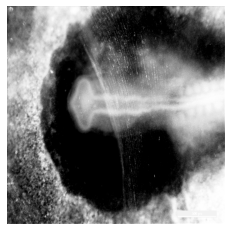

In [ ]:
gray = cv2.imread('labeled_data/10_1/10.1_021.jpg', cv2.IMREAD_GRAYSCALE)
gray = cv2.equalizeHist(gray)
plt.imshow(gray, cmap = 'gray')
plt.axis('off')
plt.savefig('a.png')
files.download('a.png')

## Rotation

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

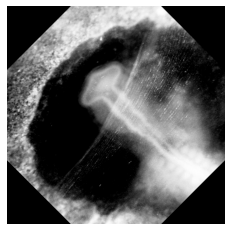

In [ ]:
rotate = iaa.geometric.Affine(rotate = 45)
rotated = rotate(image = gray)
plt.imshow(rotated, cmap = 'gray')
plt.axis('off')
plt.savefig('b.png')
files.download('b.png')

## 10% crop

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

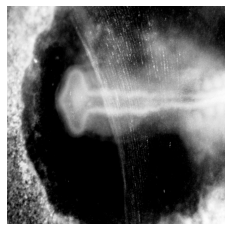

In [ ]:
crop = iaa.Crop(percent = 0.1)
cropped = crop(image = gray)
plt.imshow(cropped, cmap = 'gray')
plt.axis('off')
plt.savefig('c.png')
files.download('c.png')

## Crop and translate

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

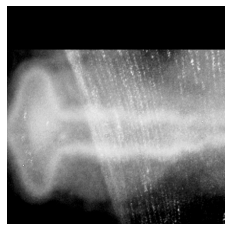

In [ ]:
crop = iaa.Crop(percent = 0.3)
translate = iaa.TranslateY(0.2)
ct = translate(image = crop(image = gray))
plt.imshow(ct, cmap = 'gray')
plt.axis('off')
plt.savefig('d.png')
files.download('d.png')

## Gamma correction

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

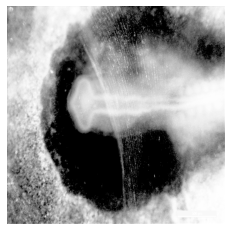

In [ ]:
gamma = iaa.GammaContrast(0.5)
gammad = gamma(image = gray)
plt.imshow(gammad, cmap = 'gray')
plt.axis('off')
plt.savefig('e.png')
files.download('e.png')

## Blur

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

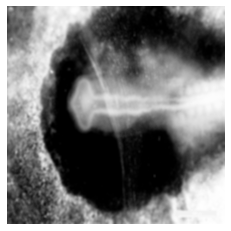

In [ ]:
gblur = iaa.GaussianBlur(sigma = 5)
gammad = gblur(image = gray)
plt.imshow(gammad, cmap = 'gray')
plt.axis('off')
plt.savefig('f.png')
files.download('f.png')

## Background removal

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

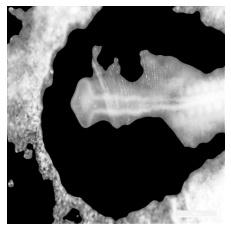

In [ ]:
gray2 = gray
blur = skimage.filters.gaussian(gray2, sigma=10)
# perform adaptive thresholding
t = skimage.filters.threshold_otsu(blur)
if gray2[100][100] > 100:
  mask = blur > t
else:
  mask = blur < t
# use the mask to select the "interesting" part of the image
sel = np.zeros_like(gray2)
sel[mask] = gray2[mask]
plt.imshow(sel, cmap = 'gray')
plt.axis('off')
plt.savefig('g.png')
files.download('g.png')

## Cutout

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

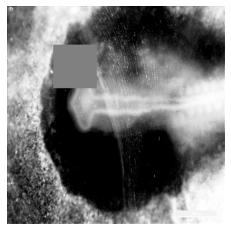

In [ ]:
cutout = iaa.Cutout()
cutoutimg = cutout(image = gray)
plt.imshow(cutoutimg, cmap = 'gray')
plt.axis('off')
plt.savefig('h.png')
files.download('h.png')

## Shear

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

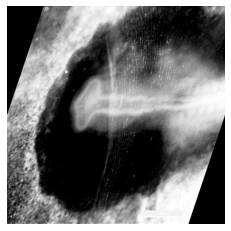

In [ ]:
shear = iaa.ShearX(20)
shearimg = shear(image = gray)
plt.imshow(shearimg, cmap = 'gray')
plt.axis('off')
plt.savefig('i.png')
files.download('i.png')

## SP

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

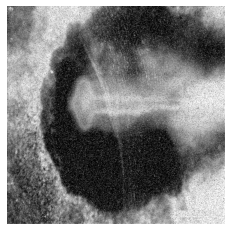

In [ ]:
sp = iaa.SaltAndPepper(0.2)
spimg = sp(image = gray)
plt.imshow(spimg, cmap = 'gray')
plt.axis('off')
plt.savefig('j.png')
files.download('j.png')

## Grayscale

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

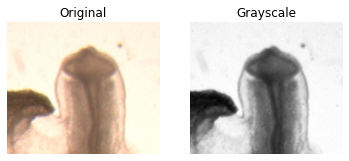

In [ ]:
image = cv2.imread(path + '/labeled_data/10_1/10.1_011.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image2 = cv2.imread(path + '/labeled_data/10_1/10.1_022.jpg')
image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)
gray = cv2.imread('labeled_data/10_1/10.1_011.jpg', cv2.IMREAD_GRAYSCALE)
gray2 = cv2.imread('labeled_data/10_1/10.1_022.jpg', cv2.IMREAD_GRAYSCALE)
visualize(image, gray, grayscale1=False, label2 = 'Grayscale')
plt.savefig('grayscale1.png')
files.download('grayscale1.png')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

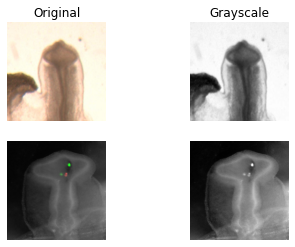

In [ ]:
fig = plt.figure()
plt.subplot(2,2,1)
plt.title('Original')
plt.imshow(cv2.resize(image, (200,200)), cmap = 'gray')
plt.axis('off')
plt.subplot(2, 2, 2)
plt.title('Grayscale')
plt.imshow(cv2.resize(gray, (200,200)), cmap = 'gray')
plt.axis('off')
plt.subplot(2,2,3)
plt.imshow(cv2.resize(image2, (200,200)), cmap = 'gray')
plt.axis('off')
plt.subplot(2,2,4)
plt.imshow(cv2.resize(gray2, (200,200)), cmap = 'gray')
plt.axis('off')
plt.savefig('grayscale2.png')
files.download('grayscale2.png')

## Crop and translate

In [ ]:
image = cv2.imread('labeled_data/10_2/10.2_032.jpg', cv2.IMREAD_GRAYSCALE)
crop = iaa.Crop(percent = 0.3)
translate = iaa.TranslateY(0.2)
rotate = iaa.geometric.Affine(rotate = 90)
aug = crop(image = translate(image = rotate(image = image)))
image2 = cv2.resize(cv2.imread('labeled_data/10_2/10.2_004.jpg', cv2.IMREAD_GRAYSCALE), (200, 200))
crop = iaa.Crop(percent = 0.3)
translate = iaa.TranslateY(0.2)
rotate = iaa.geometric.Affine(rotate = 90)
aug2 = crop(image = translate(image = rotate(image = image2)))

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

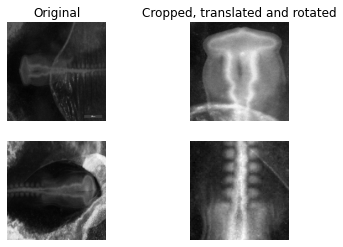

In [ ]:
fig = plt.figure()
plt.subplot(2,2,1)
plt.title('Original')
plt.imshow(cv2.resize(image, (200,200)), cmap = 'gray')
plt.axis('off')
plt.subplot(2, 2, 2)
plt.title('Cropped, translated and rotated')
plt.imshow(cv2.resize(aug, (200,200)), cmap = 'gray')
plt.axis('off')
plt.subplot(2,2,3)
plt.imshow(cv2.resize(image2, (200,200)), cmap = 'gray')
plt.axis('off')
plt.subplot(2,2,4)
plt.imshow(cv2.resize(aug2, (200,200)), cmap = 'gray')
plt.axis('off')
plt.savefig('crop_translate_issue.png')
files.download('crop_translate_issue.png')

## Crop only

In [ ]:
image = cv2.imread('labeled_data/10_2/10.2_032.jpg', cv2.IMREAD_GRAYSCALE)
crop = iaa.Crop(percent = 0.1)
translate = iaa.TranslateY(0.2)
rotate = iaa.geometric.Affine(rotate = 90)
aug = crop(image = image)
image2 = cv2.resize(cv2.imread('labeled_data/10_2/10.2_004.jpg', cv2.IMREAD_GRAYSCALE), (200, 200))
crop = iaa.Crop(percent = 0.1)
translate = iaa.TranslateY(0.2)
rotate = iaa.geometric.Affine(rotate = 90)
aug2 = crop(image = image2)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

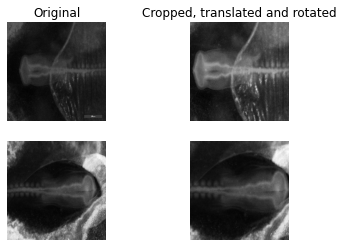

In [ ]:
fig = plt.figure()
plt.subplot(2,2,1)
plt.title('Original')
plt.imshow(cv2.resize(image, (200,200)), cmap = 'gray')
plt.axis('off')
plt.subplot(2, 2, 2)
plt.title('Cropped, translated and rotated')
plt.imshow(cv2.resize(aug, (200,200)), cmap = 'gray')
plt.axis('off')
plt.subplot(2,2,3)
plt.imshow(cv2.resize(image2, (200,200)), cmap = 'gray')
plt.axis('off')
plt.subplot(2,2,4)
plt.imshow(cv2.resize(aug2, (200,200)), cmap = 'gray')
plt.axis('off')
plt.savefig('crop_ten_percent.png')
files.download('crop_ten_percent.png')

## Gamma correction

In [ ]:
gamma = iaa.GammaContrast(0.5)
image = cv2.resize(cv2.imread('labeled_data/10_3/10.3_020.jpg', cv2.IMREAD_GRAYSCALE), (200, 200))
image = cv2.equalizeHist(image)
preprocess = gamma(image = image)
image2 = cv2.resize(cv2.imread('labeled_data/10_3/10.3_021.jpg', cv2.IMREAD_GRAYSCALE), (200, 200))
image2 = cv2.equalizeHist(image2)
preprocess2 = gamma(image = image2)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

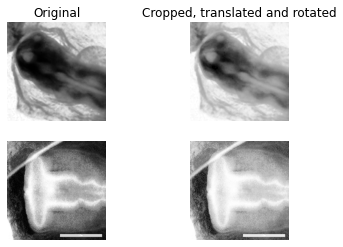

In [ ]:
fig = plt.figure()
plt.subplot(2,2,1)
plt.title('Original')
plt.imshow(image, cmap = 'gray')
plt.axis('off')
plt.subplot(2, 2, 2)
plt.title('Cropped, translated and rotated')
plt.imshow(preprocess, cmap = 'gray')
plt.axis('off')
plt.subplot(2,2,3)
plt.imshow(image2, cmap = 'gray')
plt.axis('off')
plt.subplot(2,2,4)
plt.imshow(preprocess2, cmap = 'gray')
plt.axis('off')
plt.savefig('gamma_corr.png')
files.download('gamma_corr.png')

## Blur

(-0.5, 354.5, 337.5, -0.5)

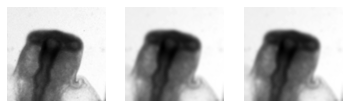

In [ ]:
image = cv2.imread('labeled_data/10_2/10.2_050.jpg', cv2.IMREAD_GRAYSCALE)
gblur = iaa.GaussianBlur(sigma = 5)
gblur2 = iaa.GaussianBlur(sigma = 20)
blur1 = gblur(image = image)
blur2 = gblur(image = image)
fig = plt.figure()
plt.subplot(1, 3, 1)
plt.imshow(image, cmap = 'gray')
plt.axis('off')
plt.subplot(1, 3, 2)
plt.imshow(blur1, cmap = 'gray')
plt.axis('off')
plt.subplot(1, 3, 3)
plt.imshow(blur2, cmap = 'gray')
plt.axis('off')

# plt.savefig('blur.png')
# files.download('blur.png')

# Cutout

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

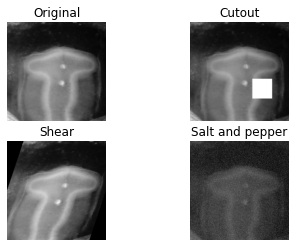

In [ ]:
image = cv2.imread('labeled_data/10_2/10.2_020.jpg', cv2.IMREAD_GRAYSCALE)
shear = iaa.ShearX(20)
sheared = shear(image = image)
cutout = iaa.Cutout()
cropped = cutout(image = image)
sp = iaa.SaltAndPepper(0.2)
sped = sp(image = image)
fig = plt.figure()
plt.subplot(2,2,1)
plt.title('Original')
plt.imshow(image, cmap = 'gray')
plt.axis('off')
plt.subplot(2, 2, 2)
plt.title('Cutout')
plt.imshow(cropped, cmap = 'gray')
plt.axis('off')
plt.subplot(2,2,3)
plt.title('Shear')
plt.imshow(sheared, cmap = 'gray')
plt.axis('off')
plt.subplot(2,2,4)
plt.title('Salt and pepper')
plt.imshow(sped, cmap = 'gray')
plt.axis('off')
plt.savefig('multiaug.png')
files.download('multiaug.png')